# PROJECT ROADMAP

- **[Importing Libraries](#download-the-libraries)**
- **[Importing Data](#download-the-data)**
    - Identifying missing Data
    - Dealing with missing Data
    - Changing data types
    - Errors correction
- **[Statistics](#statistics)**
    - Statisctics for continious variables
    - Statistics for binary variables
- **[Grouped Statistics by age](#grouped-statistics-by-age)**
    - Grouped Statistics by age
    - Grouped Statistics by age (males only)
    - Grouped Statistics by age (females only)
- **[Building Decision Tree Classifier Model for Age Prediction](#building-model)**  
    - Building primary model
    - Cost complexity pruning with cross validation
    - Building final decision tree
- **[Importing Data for Age Prediction (Data Cleaning, Statistics)](#importing-data-for-age-prediction)**  
    - 1 Dataset for Prediciton (nornice 2018)
    - 2 Dataset for Prediciton (nornice 2014)
    - Merginig data sets
- **[Age prediction for 2014 and 2018 data using final model](#age-prediction)** 
    - Adding additional conditions
- **[Grouped statistics by age for predicted data](#grouped-predicted)**  
    - Grouped Statistics by age for predicted data
    - Grouped Statistics by age for predicted data (males only)
    - Grouped Statistics by age for predicted data(females only)
- **[Comparision of age pivots (data for model building vs predicted data)](#pivots-comparision)**  
    - Comparision of age pivots (data for model building vs predicted data)
    - Comparision of age pivots (data for model building vs predicted data)(only males)
    - Comparision of age pivots (data for model building vs predicted data)(only females)
- **[Saving prediction results as csv file](#results-csv)**      
    
- **[Project summary](#project-summary)**  

<a id="download-the-libraries"></a>
# Importing Libraries

In [2954]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree

from sklearn.metrics import plot_confusion_matrix

from sklearn.linear_model import LinearRegression

<a id="download-the-data"></a>
# Importing Data

In [2955]:
df=pd.read_excel('/Users/jangrzybek/Downloads/nornice 1999+2002+2006+2010.xlsx')
df

,orig study ref no.,ref 2(overall),year,sitecode,sex code,scrotal code,lactating,perforate,pregnant,weight,nose-anus,anus-tail,AverageFoot,Av. Femur,skull length,skull width,Eye lens,AGE
0,3,1,1,1,1,1,n,n,0,16,8.9,4.1,1.7800,NaN,2.45,1.28,4.5,2
1,4,2,1,1,1,1,n,n,0,16,9.9,4.6,1.9075,NaN,2.38,1.25,5.9,2
2,8,3,1,1,2,n,0,1,1,24.7,10.5,4.4,1.7550,NaN,2.75,1.31,6.7,3
3,9,4,1,1,2,n,0,0,0,12.2,8.7,4.7,1.7650,NaN,2.60,1.18,5.4,2
4,10,5,1,1,1,1,n,n,0,15.2,9.8,4.2,1.8500,NaN,2.68,1.25,6.5,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,290,968,4,2,1,0,nd,nd,nd,15.4,9,4.3,1.8000,1.3625,2.49,1.19,4.4,1
918,291,969,4,2,1,1,nd,nd,nd,19.9,10,4.8,1.7250,1.4175,2.49,1.20,6.2,3
919,292,970,4,2,2,nd,1,0,1,32.5,11.3,5,1.7000,1.645,2.70,1.22,9.4,3
920,293,971,4,2,2,nd,0,0,0,18,9,4.4,1.7250,1.3075,2.50,1.19,5.1,2


In [2956]:
df.shape

(922, 18)

In [2957]:
df.drop(columns=['orig study ref no.','sitecode'],inplace=True)

In [2958]:
df.columns

Index(['ref 2(overall)', 'year', 'sex code', 'scrotal code', 'lactating',
       'perforate', 'pregnant', 'weight ', 'nose-anus ', 'anus-tail ',
       'AverageFoot', 'Av. Femur', 'skull length', 'skull width', 'Eye lens',
       'AGE'],
      dtype='object')

In [2959]:
new_column_names={'ref 2(overall)':'ref',
                  'sex code':'sex',
                  'scrotal code':'scrotal_code',
                  'nose-anus ':'nose_anus',
                  'anus-tail ':'anus_tail',
                  'AverageFoot':'avg_foot',
                  'Av. Femur':'avg_femur',
                  'skull length':'skull_length',
                  'skull width':'skull_width',
                  'Eye lens':'eye_lens',
                  'AGE':'age',
                  'weight ':'weight'}
df.rename(columns=new_column_names,inplace=True)

In [2960]:
df.head()

,ref,year,sex,scrotal_code,lactating,perforate,pregnant,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,age
0,1,1,1,1,n,n,0,16,8.9,4.1,1.7800,NaN,2.45,1.28,4.5,2
1,2,1,1,1,n,n,0,16,9.9,4.6,1.9075,NaN,2.38,1.25,5.9,2
2,3,1,2,n,0,1,1,24.7,10.5,4.4,1.7550,NaN,2.75,1.31,6.7,3
3,4,1,2,n,0,0,0,12.2,8.7,4.7,1.7650,NaN,2.60,1.18,5.4,2
4,5,1,1,1,n,n,0,15.2,9.8,4.2,1.8500,NaN,2.68,1.25,6.5,3


In [2961]:
df_desired_order=['ref',
                  'year',
                  'weight',
                  'nose_anus',
                  'anus_tail',
                  'avg_foot',
                  'avg_femur',
                  'skull_length',
                  'skull_width',
                  'eye_lens',
                  'sex',
                  'scrotal_code',
                  'lactating',
                  'perforate',
                  'pregnant',
                  'age']

df=df.reindex(columns=df_desired_order)

In [2962]:
df=df.reindex(columns=df_desired_order)

In [2963]:
df.head()

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,1,1,16,8.9,4.1,1.7800,NaN,2.45,1.28,4.5,1,1,n,n,0,2
1,2,1,16,9.9,4.6,1.9075,NaN,2.38,1.25,5.9,1,1,n,n,0,2
2,3,1,24.7,10.5,4.4,1.7550,NaN,2.75,1.31,6.7,2,n,0,1,1,3
3,4,1,12.2,8.7,4.7,1.7650,NaN,2.60,1.18,5.4,2,n,0,0,0,2
4,5,1,15.2,9.8,4.2,1.8500,NaN,2.68,1.25,6.5,1,1,n,n,0,3


In [2964]:
df.dtypes

ref               int64
year              int64
weight           object
nose_anus        object
anus_tail        object
avg_foot        float64
avg_femur        object
skull_length    float64
skull_width     float64
eye_lens         object
sex               int64
scrotal_code     object
lactating        object
perforate        object
pregnant         object
age               int64
dtype: object

## object dtype variables investigation

In [2965]:
object_columns = df.select_dtypes(include=['object'])
object_columns.dtypes

weight          object
nose_anus       object
anus_tail       object
avg_femur       object
eye_lens        object
scrotal_code    object
lactating       object
perforate       object
pregnant        object
dtype: object

### weight

In [2966]:
df['weight'].unique()

/Users/jangrzybek/opt/anaconda3/lib/python3.8/site-packages/IPython/core/displayhook.py:275: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


array([16, 24.7, 12.2, 15.2, 17.9, 13.1, 20.3, 13.4, 26.2, 20.2, 13.6,
       21.5, 18.9, 21.7, 16.1, 13.8, 11.8, 12.4, 23.8, 17.4, 23.9, 12.3,
       18.3, 13.7, 22.3, 12.5, 16.9, 18, 14.8, 20.8, 15.8, 19.6, 12.7,
       11.1, 17.8, 17.7, 17.2, 15.7, 20.4, 14.4, 13.3, 14.7, 12.9, 13.2,
       13.9, 15.4, 12.6, 14.1, 16.2, 19.8, 14.5, 14.2, 26, 14.3, 21.2, 14,
       21.8, 19.2, 18.2, 12.8, 15.5, 13, 11.6, 14.9, 11.9, 16.6, 17.1,
       23.2, 23.1, 20.7, 17.5, 28.7, 15.1, 16.5, 18.8, 16.3, 9.6, 25.8,
       15.3, 18.7, 22.2, 'nd', 15.9, 23.7, 29.5, 27.9, 15.6, 17.3, 26.4,
       20.6, 24.3, 16.21, 11.4, 18.4, 24.4, 12.1, 19, 18.5, 22.7, 13.5,
       10.8, 11.7, 15, 20, 9, 22, 22.9, 26.1, 25.1, 21, 24.1, 19.3, 9.4,
       18.1, 20.1, 19.7, 19.5, 9.3, 16.8, 12, 25, 9.5, 24.8, 20.5, 10.4,
       8.7, 10.9, 7.7, 26.6, 10.5, 11, 10.1, 19.4, 11.3, 24.6, 20.9, 23.5,
       9.7, 22.4, 18.6, 10.6, 27.6, 27.1, 7.5, 6.4, 25.6, 10.2, 10, 16.7,
       6.6, 7, 10.3, 31, 31.7, 11.5, 8.3, 7.8, 8.1, 19

In [2967]:
df[df['weight']=='nd']

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
140,141,2,nd,8.7,4.9,1.9,1.45,2.86,1.37,6.4,1,1,n,n,0,3


In [2968]:
df['weight']=df['weight'].replace({'nd': np.nan})

### nose_anus

In [2969]:
df['nose_anus'].unique()

array([8.9, 9.9, 10.5, 8.7, 9.8, 9.7, 9.4, 10.6, 10.8, 10.7, 9.6, 10.9,
       10.4, 9, 9.2, 8, 10, 11.8, 9.5, 7.4, 10.2, 9.3, 8.3, 10.3, 8.6,
       8.5, 11.6, 8.8, 9.1, 10.1, 11.1, 8.4, 7.5, 7.8, 8.1, 11, 10.25,
       9.05, 8.95, 8.2, 8.75, 10.65, 8.25, 91, 9.45, 9.55, 9.22, 10.45,
       7.85, 10.05, 7.1, 7.95, 8.85, 7.7, 10.95, 7.35, 9.25, 10.75, 9.15,
       9.75, 7.2, 7.9, 8.55, 8.65, 8.45, 8.35, 7.3, 6.8, 6.6, 6.9, 6.1,
       7.6, 7, 'nd', 11.2, 12.1, 6.7, 6.5, 11.3], dtype=object)

In [2970]:
df[df['nose_anus'] == 'nd']

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
552,603,3,9.5,nd,3.1,1.6,0.99,2.33,1.09,2.9,1,0,nd,nd,0,1


In [2971]:
df['nose_anus']=df['nose_anus'].replace({'nd': np.nan})

### anus_tail

In [2972]:
df['anus_tail'].unique()

array([4.1, 4.6, 4.4, 4.7, 4.2, 3.6, 3.5, 4, 4.3, 3.7, 3.9, 3.4, 3.8, 4.8,
       4.9, 3.3, 3.2, 5.2, 4.5, 5, 2.9, 4.75, 5.15, 5.05, 4.95, 4.35, 5.1,
       5.7, 5.5, 3.95, 5.4, 4.15, 4.05, 13, 4.65, 4.55, 4.45, 4.25, 4.85,
       5.3, 5.25, 3.85, 3.05, 3.35, 3.65, 2.2, 3, 2.4, 2.6, 3.1, 2.7, 45,
       'nd', 2.8], dtype=object)

In [2973]:
df[df['anus_tail'] == 'nd']

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
649,700,4,14.5,9.2,nd,1.7875,1.2525,2.59,1.24,5.8,1,1,nd,nd,nd,2
854,905,4,17.4,9.1,nd,1.7125,1.5025,2.61,1.22,7.6,1,1,nd,nd,nd,3


In [2974]:
df['anus_tail']=df['anus_tail'].replace({'nd': np.nan})

### avg_femur

In [2975]:
df['avg_femur'].unique()

array([nan, 1.45, 1.64, 1.34, 1.47, 1.29, 1.42, 1.4, 1.2850000000000001,
       1.6, 1.5850000000000002, 1.3, 1.3900000000000001, 1.375, 1.515,
       1.3800000000000001, 1.3699999999999999, 1.605, 1.6949999999999998,
       1.2449999999999999, 1.485, 1.2600000000000002, 1.25, 1.325,
       1.3050000000000002, 1.55, 1.59, 1.545, 1.4449999999999998, 1.27,
       1.31, 1.4149999999999998, 1.48, 1.2550000000000001, 1.3375, 1.33,
       1.23, 1.435, 1.2149999999999999, 1.28, 1.295, 1.35, 1.3775, 1.15,
       1.275, 1.26, 1.06, 1.22, 1.205, 1.44, 1.465, 1.2, 1.225, 1.455,
       1.1800000000000002, 1.125, 1.265, 1.16, 1.2825, 1.4775, 1.5, 1.575,
       1.46, 1.6350000000000002, 1.425, 1.3850000000000002, 1.08, 1.2925,
       1.5699999999999998, 1.24, 1.405, 1.3199999999999998, 1.185, 1.145,
       1.3475, 1.3649999999999998, 1.235, 1.1199999999999999,
       1.4300000000000002, 1.475, 0.975, 1.09, 1.4949999999999999, 1.5725,
       1.345, 1.1949999999999998, 1.51, 1.05, 1.1, 'nd',
       1.

In [2976]:
df[df['avg_femur'] == 'nd']

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
318,319,2,10.9,7.9,3.7,1.7750,nd,2.61,1.23,4.2,2,n,0,0,0,1
366,367,3,13.6,7.7,4.0,1.6875,nd,2.31,1.03,4.4,1,0,nd,nd,0,1
367,369,3,12.0,7.3,3.7,1.5625,nd,2.29,1.13,3.2,1,0,nd,nd,0,1
514,564,3,11.5,8.0,3.8,1.6000,nd,2.54,1.11,4.1,1,0,nd,nd,0,1
522,572,3,19.3,9.1,4.6,1.6125,nd,3.10,1.17,5.4,2,NaN,0,0,1,2
639,690,4,24.3,9.3,4.3,1.7875,nd,2.31,1.32,7,2,nd,1,0,0,3


In [2977]:
df['avg_femur']=df['avg_femur'].replace({'nd': np.nan})

### eye_lens

In [2978]:
df['eye_lens'].unique()

array([4.5, 5.9, 6.7, 5.4, 6.5, 5.3, 5.8, 7, 6.4, 6.9, 8.1, 5.7, 6.1, 7.1,
       6.8, 4.6, 5.6, 6.2, 4.9, 6, 4.7, 5.5, 4, 3.2, 5, 3.5, 4.8, 5.1,
       8.3, 3.8, 5.2, 6.6, 4.1, 7.9, 4.3, 4.4, 3.7, 3.1, 3.3, 4.2, 'nd',
       6.3, 9.4, 8.4, 8.6, 9.6, 9, 9.1, 7.7, 2.6, 3.6, 2.8, 3.9, 7.3, 8.8,
       8, 3.4, 8.2, 2.9, 7.6, 5.8999999999999995, 6.1000000000000005,
       5.1000000000000005, 4.8999999999999995, 7.5, 7.4,
       4.1000000000000005, 2.4, 7.2, 2.2, 6.8999999999999995,
       7.1000000000000005, 3, 2.5, 1.6, 2.3, 9.5, nan, 8.7, 2.7, 2],
      dtype=object)

In [2979]:
df[df['eye_lens'] == 'nd']

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
129,130,1,25.8,10.8,4.2,1.7,NaN,2.81,1.32,nd,2,n,0,0,0,3


In [2980]:
df['eye_lens']=df['eye_lens'].replace({'nd': np.nan})

### scrotal_code

In [2981]:
df['scrotal_code'].unique()

array([1, 'n', 0, nan, 0.5, 'nd'], dtype=object)

In [2982]:
df[(df['scrotal_code'] == 'n') | (df['scrotal_code'] == 'nd')]

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
2,3,1,24.7,10.5,4.4,1.7550,NaN,2.75,1.31,6.7,2,n,0,1,1,3
3,4,1,12.2,8.7,4.7,1.7650,NaN,2.60,1.18,5.4,2,n,0,0,0,2
7,8,1,20.3,10.6,4.0,1.7950,NaN,2.86,1.31,5.9,2,n,1,1,0,2
9,10,1,26.2,10.8,4.4,1.9360,NaN,3.28,1.35,7.0,2,n,1,1,0,3
10,11,1,20.2,10.7,4.3,1.6950,NaN,2.80,1.31,6.4,2,n,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
911,962,4,17.3,8.7,4.5,1.7125,1.2950,2.54,1.22,4.9,2,nd,0,0,0,1
916,967,4,19.1,9.2,4.0,1.7250,1.2950,2.55,1.22,3.8,2,nd,0,0,0,1
919,970,4,32.5,11.3,5.0,1.7000,1.6450,2.70,1.22,9.4,2,nd,1,0,1,3
920,971,4,18.0,9.0,4.4,1.7250,1.3075,2.50,1.19,5.1,2,nd,0,0,0,2


In [2983]:
df['scrotal_code']=df['scrotal_code'].replace({'nd': np.nan,
                                                'n': np.nan})

In [2984]:
df['scrotal_code']=df['scrotal_code'].replace({0.5: 1})

### lactating

In [2985]:
df['lactating'].unique()

array(['n', 0, 1, 'nd'], dtype=object)

In [2986]:
df[(df['lactating'] == 'n') | (df['lactating'] == 'nd')]

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,1,1,16.0,8.9,4.1,1.7800,NaN,2.45,1.28,4.5,1,1.0,n,n,0,2
1,2,1,16.0,9.9,4.6,1.9075,NaN,2.38,1.25,5.9,1,1.0,n,n,0,2
4,5,1,15.2,9.8,4.2,1.8500,NaN,2.68,1.25,6.5,1,1.0,n,n,0,3
5,6,1,17.9,9.7,3.6,1.8550,NaN,2.78,1.23,5.3,1,1.0,n,n,0,2
6,7,1,13.1,9.4,3.5,1.7400,NaN,2.69,1.28,5.8,1,0.0,n,n,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,964,4,17.2,8.8,4.2,1.8000,1.2850,2.59,1.19,5.5,1,0.0,nd,nd,nd,2
914,965,4,26.8,10.4,4.6,1.7500,1.5600,2.60,1.26,8.4,1,1.0,nd,nd,nd,3
915,966,4,18.0,9.1,3.7,1.7750,1.3350,2.54,1.24,5.1,1,0.0,nd,nd,nd,2
917,968,4,15.4,9.0,4.3,1.8000,1.3625,2.49,1.19,4.4,1,0.0,nd,nd,nd,1


In [2987]:
df['lactating']=df['lactating'].replace({'nd': np.nan,
                                         'n': np.nan})

### perforate

In [2988]:
df['perforate'].unique()

array(['n', 1, 0, 'nd'], dtype=object)

In [2989]:
df[(df['perforate'] == 'n') | (df['perforate'] == 'nd')]

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,1,1,16.0,8.9,4.1,1.7800,NaN,2.45,1.28,4.5,1,1.0,NaN,n,0,2
1,2,1,16.0,9.9,4.6,1.9075,NaN,2.38,1.25,5.9,1,1.0,NaN,n,0,2
4,5,1,15.2,9.8,4.2,1.8500,NaN,2.68,1.25,6.5,1,1.0,NaN,n,0,3
5,6,1,17.9,9.7,3.6,1.8550,NaN,2.78,1.23,5.3,1,1.0,NaN,n,0,2
6,7,1,13.1,9.4,3.5,1.7400,NaN,2.69,1.28,5.8,1,0.0,NaN,n,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,964,4,17.2,8.8,4.2,1.8000,1.2850,2.59,1.19,5.5,1,0.0,NaN,nd,nd,2
914,965,4,26.8,10.4,4.6,1.7500,1.5600,2.60,1.26,8.4,1,1.0,NaN,nd,nd,3
915,966,4,18.0,9.1,3.7,1.7750,1.3350,2.54,1.24,5.1,1,0.0,NaN,nd,nd,2
917,968,4,15.4,9.0,4.3,1.8000,1.3625,2.49,1.19,4.4,1,0.0,NaN,nd,nd,1


In [2990]:
df['perforate']=df['perforate'].replace({'nd': np.nan,
                                         'n': np.nan})

### pregnant

In [2991]:
df['pregnant'].unique()

array([0, 1, 'nd'], dtype=object)

In [2992]:
df[df['pregnant'] == 'nd']

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
629,680,4,14.8,8.7,4.7,1.7875,1.2800,2.67,1.40,4.6,1,0.0,NaN,NaN,nd,1
630,681,4,14.4,9.1,4.1,1.7500,1.1675,2.27,1.40,4.6,1,0.0,NaN,NaN,nd,1
635,686,4,16.7,9.1,4.1,1.8000,1.2175,2.52,1.23,6.1,1,1.0,NaN,NaN,nd,2
636,687,4,19.6,9.7,4.7,1.8500,1.4100,2.61,1.41,6.8,1,1.0,NaN,NaN,nd,3
637,688,4,17.3,9.2,4.2,1.6875,1.4050,2.56,1.34,4.9,1,0.0,NaN,NaN,nd,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,964,4,17.2,8.8,4.2,1.8000,1.2850,2.59,1.19,5.5,1,0.0,NaN,NaN,nd,2
914,965,4,26.8,10.4,4.6,1.7500,1.5600,2.60,1.26,8.4,1,1.0,NaN,NaN,nd,3
915,966,4,18.0,9.1,3.7,1.7750,1.3350,2.54,1.24,5.1,1,0.0,NaN,NaN,nd,2
917,968,4,15.4,9.0,4.3,1.8000,1.3625,2.49,1.19,4.4,1,0.0,NaN,NaN,nd,1


In [2993]:
df['pregnant']=df['pregnant'].replace({'nd': np.nan})

In [2994]:
df.isnull().sum()

ref               0
year              0
weight            1
nose_anus         1
anus_tail         2
avg_foot          0
avg_femur       146
skull_length      0
skull_width       0
eye_lens          2
sex               0
scrotal_code    453
lactating       475
perforate       475
pregnant        152
age               0
dtype: int64

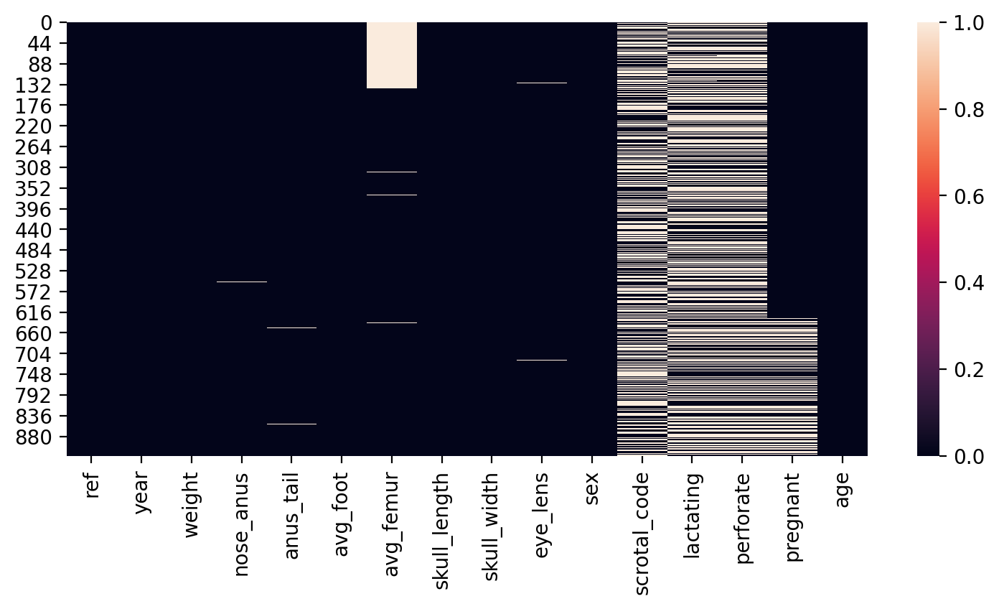

In [2995]:
plt.figure(figsize=(9,4), dpi=200)
sns.heatmap(df.isnull())
plt.show()

### weight

In [2996]:
df['weight'].describe()

count    921.000000
mean      16.750825
std        4.602446
min        6.400000
25%       13.400000
50%       16.000000
75%       19.900000
max       34.600000
Name: weight, dtype: float64

In [2997]:
df['weight']=df['weight'].fillna(df['weight'].mean())

### nose_anus 

In [2998]:
df['nose_anus'].describe()

count    921.000000
mean       9.110228
std        2.859578
min        6.100000
25%        8.400000
50%        9.050000
75%        9.700000
max       91.000000
Name: nose_anus, dtype: float64

In [2999]:
df['nose_anus']=df['nose_anus'].fillna(df['nose_anus'].mean())

### anus_tail

In [3000]:
df['anus_tail'].describe()

count    920.000000
mean       4.238315
std        1.455718
min        2.200000
25%        3.900000
50%        4.200000
75%        4.500000
max       45.000000
Name: anus_tail, dtype: float64

In [3001]:
df['anus_tail']=df['anus_tail'].fillna(df['anus_tail'].mean())

### eye_lens

In [3002]:
df['eye_lens'].describe()

count    920.00000
mean       5.36250
std        1.24376
min        1.60000
25%        4.57500
50%        5.40000
75%        6.10000
max        9.60000
Name: eye_lens, dtype: float64

In [3003]:
df['eye_lens']=df['eye_lens'].fillna(df['eye_lens'].mean())

### scrotal_code

In [3004]:
df['scrotal_code'].fillna(0,inplace=True)

### lactating

In [3005]:
df['lactating'].fillna(0,inplace=True)

### perforate

In [3006]:
df['perforate'].fillna(0,inplace=True)

### pregnant

In [3007]:
df['pregnant'].fillna(0,inplace=True)

### avg femur (a lot of nan values, 16%), linear regression will be used to fill nan values

In [3008]:
df['avg_femur'].isnull().sum()

146

In [3009]:
df_avg_femur_not_nan=df[df['avg_femur'].notna()]
df_avg_femur_not_nan

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
140,141,2,16.750825,8.7,4.90,1.900,1.4500,2.860,1.37,6.4,1,1.0,0.0,0.0,0.0,3
141,142,2,18.700000,9.8,4.75,1.875,1.6400,3.255,1.27,6.6,1,1.0,0.0,0.0,0.0,3
142,143,2,15.900000,8.8,4.40,1.800,1.3400,3.050,1.27,5.7,1,1.0,0.0,0.0,0.0,2
143,144,2,12.600000,8.0,3.20,1.800,1.4700,2.980,1.23,4.3,2,0.0,0.0,0.0,0.0,1
144,145,2,13.800000,8.9,4.50,1.900,1.2900,3.140,1.26,4.4,1,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,968,4,15.400000,9.0,4.30,1.800,1.3625,2.490,1.19,4.4,1,0.0,0.0,0.0,0.0,1
918,969,4,19.900000,10.0,4.80,1.725,1.4175,2.490,1.20,6.2,1,1.0,0.0,0.0,0.0,3
919,970,4,32.500000,11.3,5.00,1.700,1.6450,2.700,1.22,9.4,2,0.0,1.0,0.0,1.0,3
920,971,4,18.000000,9.0,4.40,1.725,1.3075,2.500,1.19,5.1,2,0.0,0.0,0.0,0.0,2


In [3010]:
correlations=df_avg_femur_not_nan.corr()
correlations

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
ref,1.000000,0.942798,0.139851,-0.061938,-0.009111,-0.508059,0.086621,-0.495862,-0.040657,-0.015885,-0.020836,0.012713,0.049556,-0.039879,-0.027762,0.000227
year,0.942798,1.000000,0.183267,-0.049325,-0.018655,-0.509118,0.119705,-0.437645,0.052016,-0.018989,0.002824,0.011633,0.072552,-0.003425,0.011366,0.021933
weight,0.139851,0.183267,1.000000,0.254084,0.231937,0.251060,0.828474,0.450773,0.495840,0.713304,0.211542,0.157699,0.567929,0.179682,0.392701,0.774116
nose_anus,-0.061938,-0.049325,0.254084,1.000000,0.254191,0.138024,0.251173,0.182392,0.156839,0.241533,0.005416,0.124196,0.134544,0.031075,0.068092,0.230568
anus_tail,-0.009111,-0.018655,0.231937,0.254191,1.000000,0.085966,0.264166,0.164158,0.137656,0.276828,0.016383,0.087624,0.112375,0.036769,0.070730,0.222844
avg_foot,-0.508059,-0.509118,0.251060,0.138024,0.085966,1.000000,0.288623,0.444680,0.538389,0.356105,-0.069150,0.170866,0.034772,-0.041937,0.007049,0.290750
avg_femur,0.086621,0.119705,0.828474,0.251173,0.264166,0.288623,1.000000,0.524706,0.472579,0.790552,0.145984,0.217325,0.481553,0.174735,0.286579,0.780878
skull_length,-0.495862,-0.437645,0.450773,0.182392,0.164158,0.444680,0.524706,1.000000,0.276148,0.488689,0.112311,0.135837,0.264188,0.168391,0.240383,0.491768
skull_width,-0.040657,0.052016,0.495840,0.156839,0.137656,0.538389,0.472579,0.276148,1.000000,0.473034,0.022308,0.162763,0.188416,-0.052353,0.108236,0.413469
eye_lens,-0.015885,-0.018989,0.713304,0.241533,0.276828,0.356105,0.790552,0.488689,0.473034,1.000000,-0.000299,0.345209,0.314337,0.081459,0.147559,0.789028


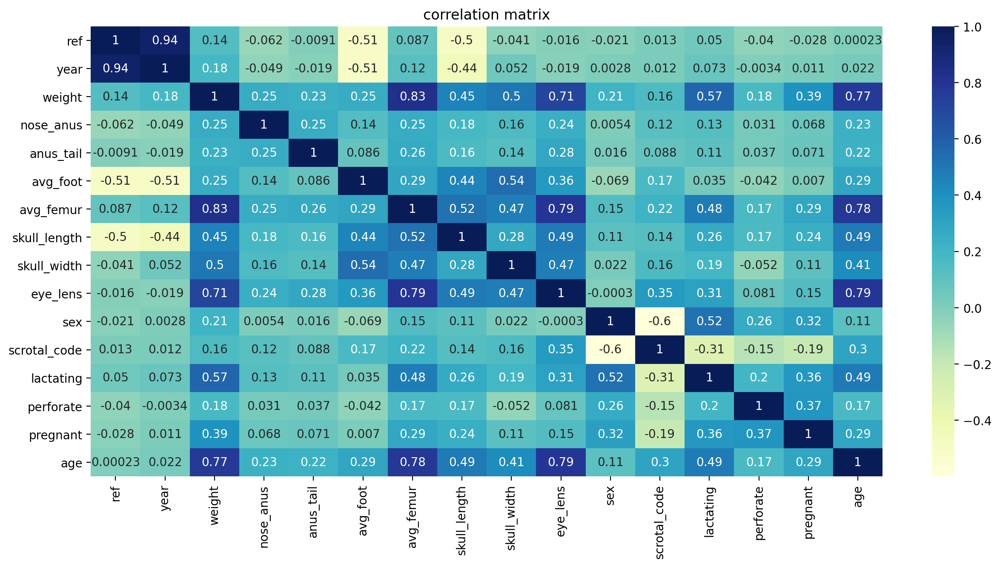

In [3011]:
plt.figure(figsize=(15,7), dpi=200)
sns.heatmap(correlations, cmap="YlGnBu", annot=True)
plt.title('correlation matrix')
plt.show()

### Avg femur has the strongest correlation with weight

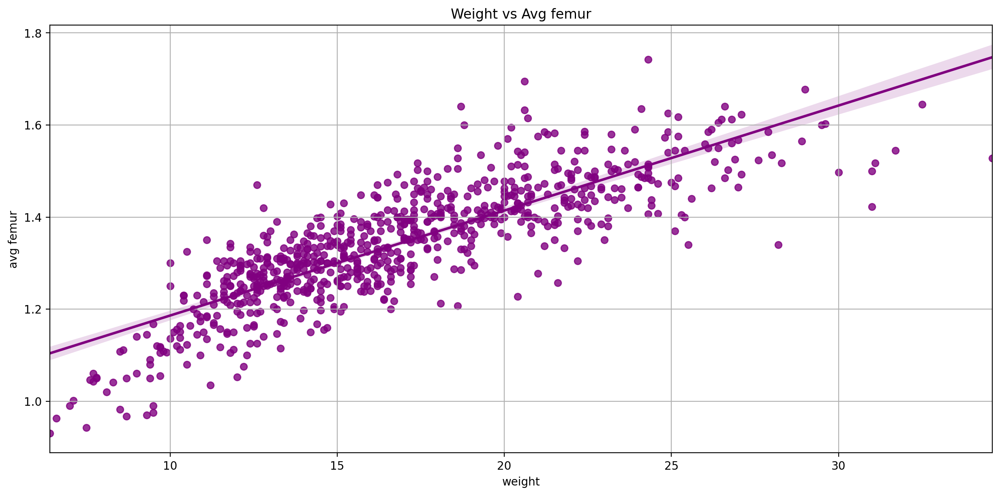

In [3012]:
plt.figure(figsize=(15, 7), dpi=200)
sns.regplot(x="weight",  
            y="avg_femur",  
            data=df_avg_femur_not_nan,
            color='purple')
plt.title('Weight vs Avg femur')
plt.xlabel('weight')
plt.ylabel('avg femur')
plt.grid(True)


In [3013]:
X = df_avg_femur_not_nan[['weight']] 
y = df_avg_femur_not_nan['avg_femur'] 
model_avg_femur_target = LinearRegression()
model_avg_femur_target.fit(X,y)

LinearRegression()

In [3014]:
coefficients = model_avg_femur_target.coef_
intercept = model_avg_femur_target.intercept_
print(coefficients)
print(intercept)

[0.02280333]
0.9580796633776334


In [3015]:
df_avg_femur_nan=df[df['avg_femur'].isna()]
df_avg_femur_nan

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,1,1,16.0,8.9,4.1,1.7800,NaN,2.45,1.28,4.5,1,1.0,0.0,0.0,0.0,2
1,2,1,16.0,9.9,4.6,1.9075,NaN,2.38,1.25,5.9,1,1.0,0.0,0.0,0.0,2
2,3,1,24.7,10.5,4.4,1.7550,NaN,2.75,1.31,6.7,2,0.0,0.0,1.0,1.0,3
3,4,1,12.2,8.7,4.7,1.7650,NaN,2.60,1.18,5.4,2,0.0,0.0,0.0,0.0,2
4,5,1,15.2,9.8,4.2,1.8500,NaN,2.68,1.25,6.5,1,1.0,0.0,0.0,0.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,367,3,13.6,7.7,4.0,1.6875,NaN,2.31,1.03,4.4,1,0.0,0.0,0.0,0.0,1
367,369,3,12.0,7.3,3.7,1.5625,NaN,2.29,1.13,3.2,1,0.0,0.0,0.0,0.0,1
514,564,3,11.5,8.0,3.8,1.6000,NaN,2.54,1.11,4.1,1,0.0,0.0,0.0,0.0,1
522,572,3,19.3,9.1,4.6,1.6125,NaN,3.10,1.17,5.4,2,0.0,0.0,0.0,1.0,2


In [3016]:
predictions_avg_femur = model_avg_femur_target.predict(df_avg_femur_nan[['weight']])
predictions_avg_femur=pd.Series(predictions_avg_femur)
predictions_avg_femur

0      1.322933
1      1.322933
2      1.521322
3      1.236280
4      1.304690
         ...   
141    1.268205
142    1.231720
143    1.220318
144    1.398184
145    1.512200
Length: 146, dtype: float64

In [3017]:
df_avg_femur_nan=df_avg_femur_nan.copy()
df_avg_femur_nan.drop(columns=['avg_femur'], inplace=True)
df_avg_femur_nan = df_avg_femur_nan.reset_index(drop=True)
df_avg_femur_nan

,ref,year,weight,nose_anus,anus_tail,avg_foot,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,1,1,16.0,8.9,4.1,1.7800,2.45,1.28,4.5,1,1.0,0.0,0.0,0.0,2
1,2,1,16.0,9.9,4.6,1.9075,2.38,1.25,5.9,1,1.0,0.0,0.0,0.0,2
2,3,1,24.7,10.5,4.4,1.7550,2.75,1.31,6.7,2,0.0,0.0,1.0,1.0,3
3,4,1,12.2,8.7,4.7,1.7650,2.60,1.18,5.4,2,0.0,0.0,0.0,0.0,2
4,5,1,15.2,9.8,4.2,1.8500,2.68,1.25,6.5,1,1.0,0.0,0.0,0.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141,367,3,13.6,7.7,4.0,1.6875,2.31,1.03,4.4,1,0.0,0.0,0.0,0.0,1
142,369,3,12.0,7.3,3.7,1.5625,2.29,1.13,3.2,1,0.0,0.0,0.0,0.0,1
143,564,3,11.5,8.0,3.8,1.6000,2.54,1.11,4.1,1,0.0,0.0,0.0,0.0,1
144,572,3,19.3,9.1,4.6,1.6125,3.10,1.17,5.4,2,0.0,0.0,0.0,1.0,2


In [3018]:
predicted_avg_femur=pd.concat([df_avg_femur_nan,predictions_avg_femur],axis=1)
predicted_avg_femur.head()

,ref,year,weight,nose_anus,anus_tail,avg_foot,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age,0
0,1,1,16.0,8.9,4.1,1.7800,2.45,1.28,4.5,1,1.0,0.0,0.0,0.0,2,1.322933
1,2,1,16.0,9.9,4.6,1.9075,2.38,1.25,5.9,1,1.0,0.0,0.0,0.0,2,1.322933
2,3,1,24.7,10.5,4.4,1.7550,2.75,1.31,6.7,2,0.0,0.0,1.0,1.0,3,1.521322
3,4,1,12.2,8.7,4.7,1.7650,2.60,1.18,5.4,2,0.0,0.0,0.0,0.0,2,1.236280
4,5,1,15.2,9.8,4.2,1.8500,2.68,1.25,6.5,1,1.0,0.0,0.0,0.0,3,1.304690


In [3019]:
predicted_avg_femur.rename(columns={0:'avg_femur'},inplace=True)

In [3020]:
predicted_avg_femur.columns

Index(['ref', 'year', 'weight', 'nose_anus', 'anus_tail', 'avg_foot',
       'skull_length', 'skull_width', 'eye_lens', 'sex', 'scrotal_code',
       'lactating', 'perforate', 'pregnant', 'age', 'avg_femur'],
      dtype='object')

In [3021]:
new_order=['ref', 'year', 'weight', 'nose_anus', 'anus_tail','avg_foot','avg_femur', 
       'skull_length', 'skull_width', 'eye_lens', 'sex', 'scrotal_code',
       'lactating', 'perforate', 'pregnant', 'age']

In [3022]:
predicted_avg_femur=predicted_avg_femur.reindex(columns=new_order)
predicted_avg_femur

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,1,1,16.0,8.9,4.1,1.7800,1.322933,2.45,1.28,4.5,1,1.0,0.0,0.0,0.0,2
1,2,1,16.0,9.9,4.6,1.9075,1.322933,2.38,1.25,5.9,1,1.0,0.0,0.0,0.0,2
2,3,1,24.7,10.5,4.4,1.7550,1.521322,2.75,1.31,6.7,2,0.0,0.0,1.0,1.0,3
3,4,1,12.2,8.7,4.7,1.7650,1.236280,2.60,1.18,5.4,2,0.0,0.0,0.0,0.0,2
4,5,1,15.2,9.8,4.2,1.8500,1.304690,2.68,1.25,6.5,1,1.0,0.0,0.0,0.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141,367,3,13.6,7.7,4.0,1.6875,1.268205,2.31,1.03,4.4,1,0.0,0.0,0.0,0.0,1
142,369,3,12.0,7.3,3.7,1.5625,1.231720,2.29,1.13,3.2,1,0.0,0.0,0.0,0.0,1
143,564,3,11.5,8.0,3.8,1.6000,1.220318,2.54,1.11,4.1,1,0.0,0.0,0.0,0.0,1
144,572,3,19.3,9.1,4.6,1.6125,1.398184,3.10,1.17,5.4,2,0.0,0.0,0.0,1.0,2


In [3023]:
new_df=pd.concat([df_avg_femur_not_nan,predicted_avg_femur],axis=0,ignore_index=True)
new_df

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,141,2,16.750825,8.7,4.90,1.9000,1.450000,2.860,1.37,6.4,1,1.0,0.0,0.0,0.0,3
1,142,2,18.700000,9.8,4.75,1.8750,1.640000,3.255,1.27,6.6,1,1.0,0.0,0.0,0.0,3
2,143,2,15.900000,8.8,4.40,1.8000,1.340000,3.050,1.27,5.7,1,1.0,0.0,0.0,0.0,2
3,144,2,12.600000,8.0,3.20,1.8000,1.470000,2.980,1.23,4.3,2,0.0,0.0,0.0,0.0,1
4,145,2,13.800000,8.9,4.50,1.9000,1.290000,3.140,1.26,4.4,1,0.0,0.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,367,3,13.600000,7.7,4.00,1.6875,1.268205,2.310,1.03,4.4,1,0.0,0.0,0.0,0.0,1
918,369,3,12.000000,7.3,3.70,1.5625,1.231720,2.290,1.13,3.2,1,0.0,0.0,0.0,0.0,1
919,564,3,11.500000,8.0,3.80,1.6000,1.220318,2.540,1.11,4.1,1,0.0,0.0,0.0,0.0,1
920,572,3,19.300000,9.1,4.60,1.6125,1.398184,3.100,1.17,5.4,2,0.0,0.0,0.0,1.0,2


In [3024]:
df= df.reset_index(drop=True)
df=new_df

In [3025]:
df.isnull().sum()

ref             0
year            0
weight          0
nose_anus       0
anus_tail       0
avg_foot        0
avg_femur       0
skull_length    0
skull_width     0
eye_lens        0
sex             0
scrotal_code    0
lactating       0
perforate       0
pregnant        0
age             0
dtype: int64

In [3026]:
df.dtypes

ref               int64
year              int64
weight          float64
nose_anus       float64
anus_tail       float64
avg_foot        float64
avg_femur       float64
skull_length    float64
skull_width     float64
eye_lens        float64
sex               int64
scrotal_code    float64
lactating       float64
perforate       float64
pregnant        float64
age               int64
dtype: object

In [3027]:
columns_type_change=['scrotal_code','lactating','perforate','pregnant']

for column in columns_type_change:
    df[column]=df[column].astype(int)

In [3028]:
df.dtypes

ref               int64
year              int64
weight          float64
nose_anus       float64
anus_tail       float64
avg_foot        float64
avg_femur       float64
skull_length    float64
skull_width     float64
eye_lens        float64
sex               int64
scrotal_code      int64
lactating         int64
perforate         int64
pregnant          int64
age               int64
dtype: object

In [3029]:
df['scrotal_code']=df['scrotal_code'].replace({0.5:1}) #0.5 should be 1
df['sex']=df['sex'].replace({2:0})

In [3030]:
df['anus_tail'].sort_values().tail(20)

290     5.20
589     5.20
341     5.20
664     5.20
659     5.20
40      5.20
831     5.20
131     5.20
136     5.25
250     5.30
124     5.30
634     5.30
33      5.40
25      5.50
668     5.50
515     5.50
106     5.50
24      5.70
57     13.00
482    45.00
Name: anus_tail, dtype: float64

In [3031]:
df['nose_anus'].sort_values().tail(20)

788    10.90
560    10.90
147    10.95
284    11.00
146    11.00
9      11.00
535    11.00
182    11.00
659    11.10
878    11.10
25     11.10
651    11.10
678    11.10
573    11.10
487    11.20
773    11.30
841    11.60
797    11.80
559    12.10
57     91.00
Name: nose_anus, dtype: float64

In [3032]:
df.drop(index=[57,482],inplace=True)
df= df.reset_index(drop=True)
len(df)

920

In [3033]:
# perforate female can not be age 1

df[(df['sex']==0) & (df['perforate'] == 1) & (df['age'] == 1)]

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
245,410,3,11.8,7.4,4.0,1.6250,1.20875,2.67,1.08,3.8,0,0,0,1,0,1
264,429,3,11.1,8.2,3.8,1.7125,1.27375,2.73,1.08,4.5,0,0,0,1,0,1
465,662,3,14.4,8.8,4.2,1.6750,1.32250,2.61,1.13,5.0,0,0,0,1,0,1
541,740,4,13.4,7.9,4.1,1.7375,1.25000,2.53,1.35,4.1,0,0,0,1,0,1


In [3034]:
df.loc[(df['sex'] ==0) &
       (df['perforate'] == 1) &
       (df['age'] == 1),'age'] = 2

In [3035]:
# male with scrotal code = 1 can not be age 1

df[(df['sex']==1) & (df['scrotal_code'] == 1) & (df['age'] == 1)]

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
90,232,2,14.3,8.60,3.70,1.8000,1.265000,2.90,1.24,4.9,1,1,0,0,0,1
114,256,2,12.5,7.85,3.80,1.8375,1.250000,2.57,1.26,4.1,1,1,0,0,0,1
148,290,2,13.7,8.50,4.00,1.8000,1.285000,2.70,1.22,4.1,1,1,0,0,0,1
180,323,2,14.1,8.20,3.65,1.8500,1.250000,2.65,1.25,4.7,1,1,0,0,0,1
208,351,2,13.6,8.50,4.35,1.8750,1.265000,2.78,1.29,4.8,1,1,0,0,0,1
316,502,3,9.7,7.60,2.40,1.6500,1.118750,2.44,1.07,2.2,1,1,0,0,0,1
344,534,3,11.7,7.90,3.80,1.6250,1.260000,2.68,1.07,4.8,1,1,0,0,0,1
565,764,4,17.9,8.40,4.40,1.7500,1.270000,2.69,1.29,4.0,1,1,0,0,0,1
589,788,4,16.7,8.70,3.80,1.7500,1.287500,2.64,1.26,4.7,1,1,0,0,0,1
592,791,4,16.1,8.80,4.30,1.7375,1.307500,2.55,1.29,4.7,1,1,0,0,0,1


In [3036]:
df.loc[(df['sex'] ==1) &
       (df['scrotal_code'] == 1) &
       (df['age'] == 1),'age'] = 2

<a id="statistics"></a>
# Statistics 

## Statisctics for continious variables

In [3037]:
df_contionious_variables=df.select_dtypes(include=['float64'])
df_contionious_variables

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens
0,16.750825,8.7,4.90,1.9000,1.450000,2.860,1.37,6.4
1,18.700000,9.8,4.75,1.8750,1.640000,3.255,1.27,6.6
2,15.900000,8.8,4.40,1.8000,1.340000,3.050,1.27,5.7
3,12.600000,8.0,3.20,1.8000,1.470000,2.980,1.23,4.3
4,13.800000,8.9,4.50,1.9000,1.290000,3.140,1.26,4.4
...,...,...,...,...,...,...,...,...
915,13.600000,7.7,4.00,1.6875,1.268205,2.310,1.03,4.4
916,12.000000,7.3,3.70,1.5625,1.231720,2.290,1.13,3.2
917,11.500000,8.0,3.80,1.6000,1.220318,2.540,1.11,4.1
918,19.300000,9.1,4.60,1.6125,1.398184,3.100,1.17,5.4


In [3038]:
df_contionious_variables.describe()

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens
count,920.000000,920.000000,920.000000,920.000000,920.000000,920.000000,920.000000,920.000000
mean,16.746153,9.021011,4.184485,1.748159,1.339821,2.704190,1.224736,5.358723
std,4.600959,0.938663,0.474048,0.079727,0.124523,0.190846,0.094869,1.239627
min,6.400000,6.100000,2.200000,1.500000,0.930000,2.200000,0.930000,1.600000
25%,13.375000,8.400000,3.900000,1.700000,1.261364,2.580000,1.160000,4.575000
50%,16.000000,9.050000,4.200000,1.737500,1.332500,2.690000,1.230000,5.400000
75%,19.825000,9.700000,4.500000,1.800000,1.421053,2.810000,1.290000,6.100000
max,34.600000,12.100000,5.700000,2.050000,1.742500,3.570000,1.560000,9.600000


In [3039]:
df_contionious_variables.columns

Index(['weight', 'nose_anus', 'anus_tail', 'avg_foot', 'avg_femur',
       'skull_length', 'skull_width', 'eye_lens'],
      dtype='object')

Column: weight



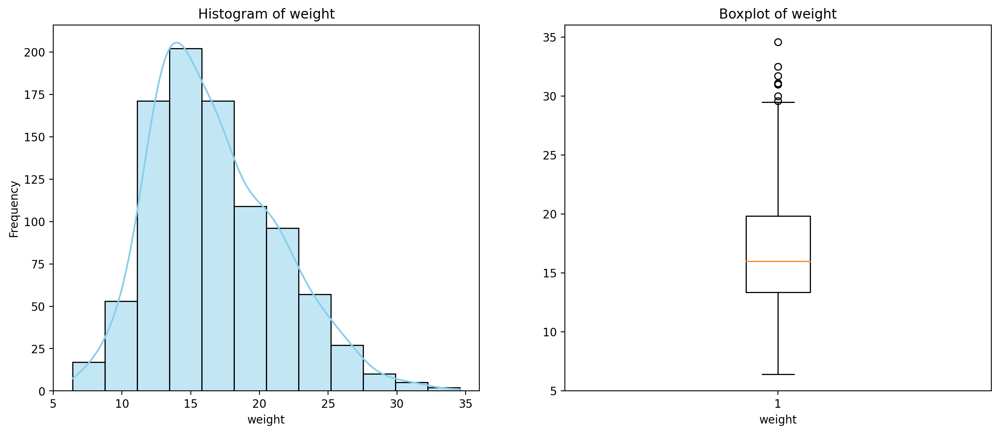





Column: nose_anus



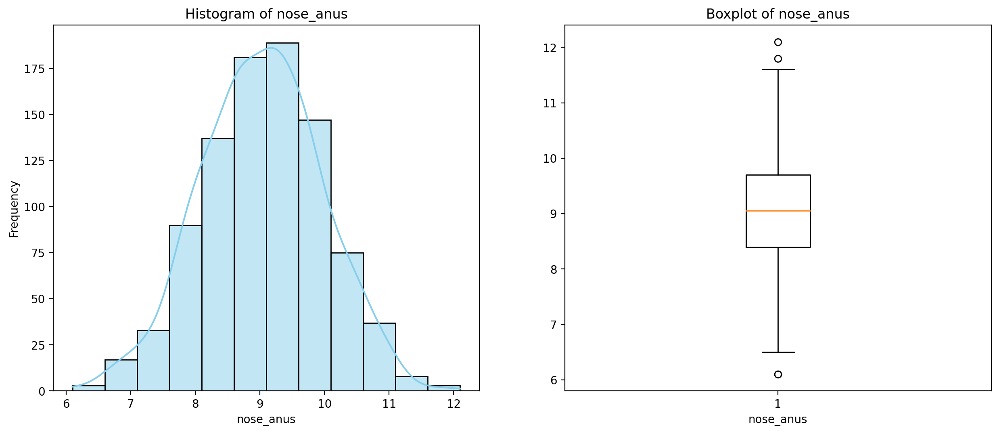





Column: anus_tail



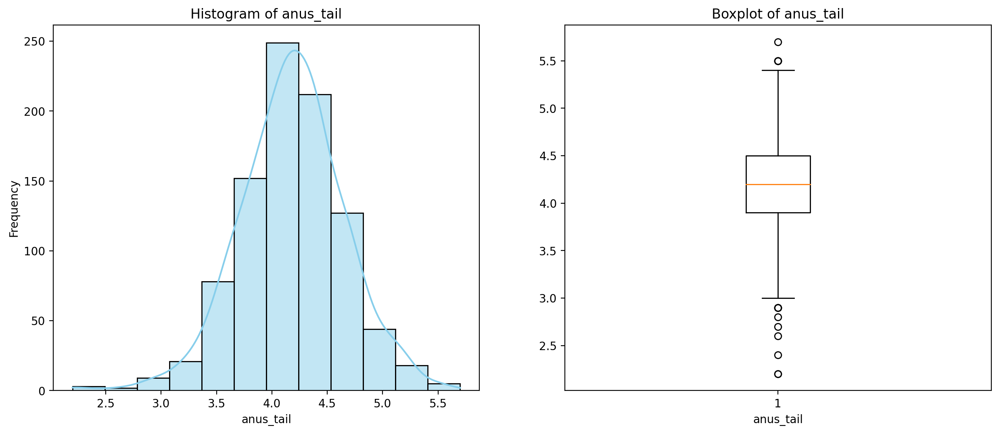





Column: avg_foot



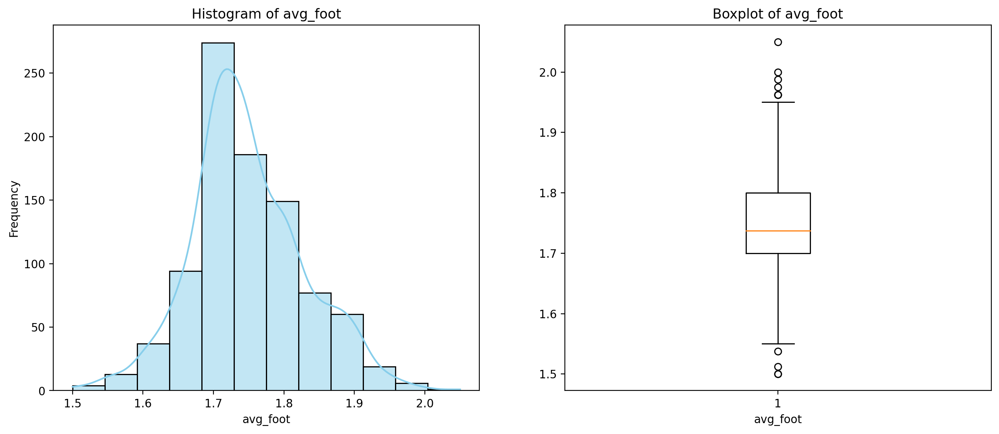





Column: avg_femur



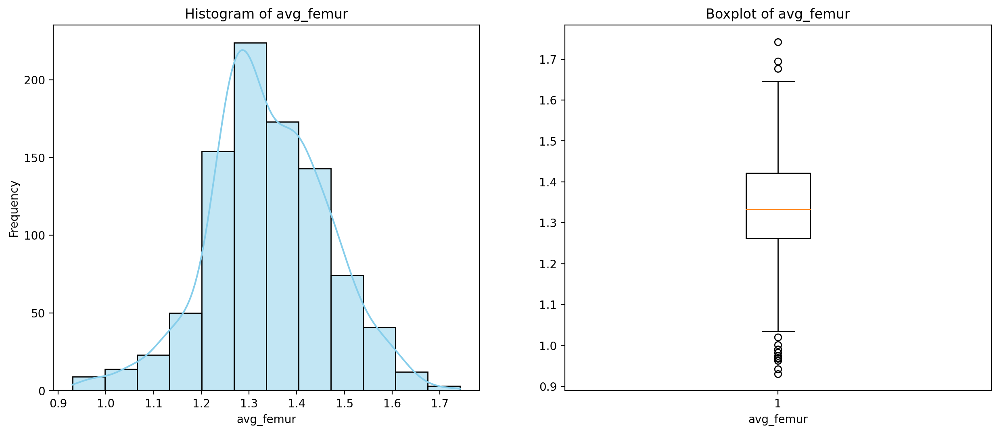





Column: skull_length



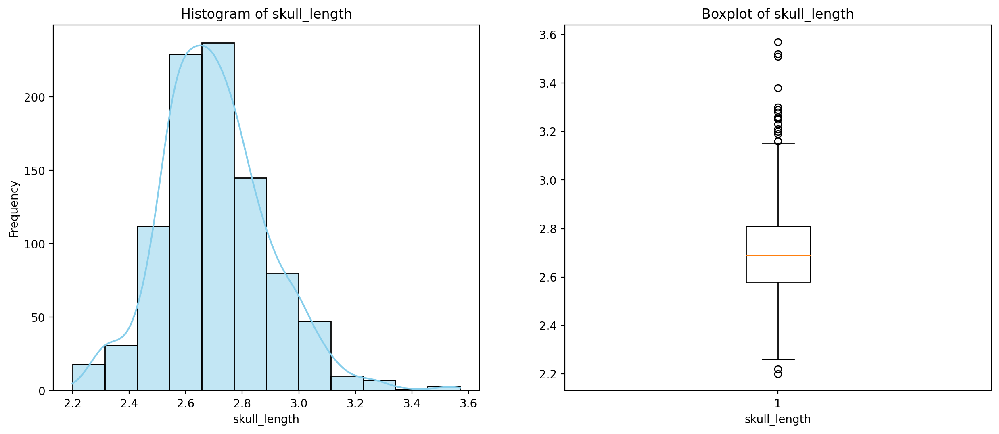





Column: skull_width



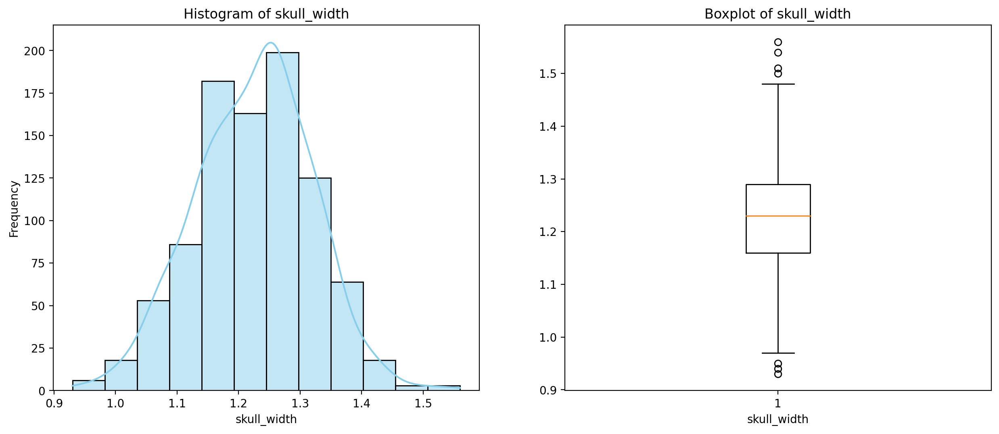





Column: eye_lens



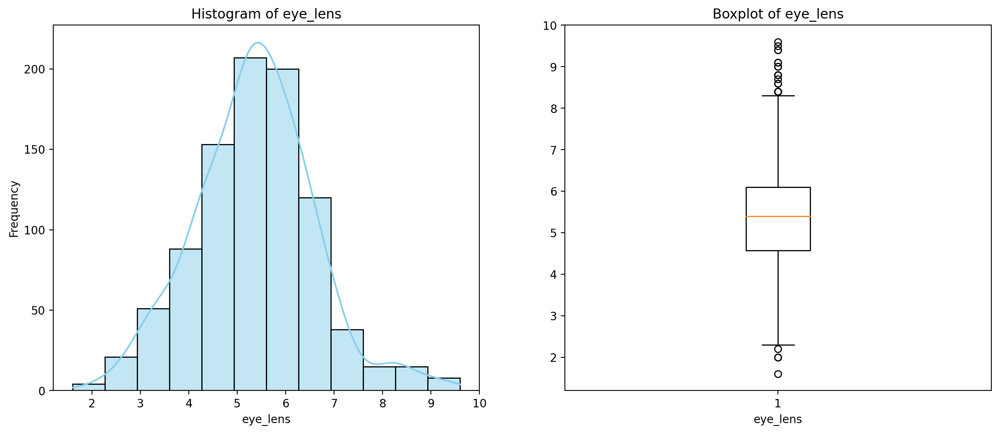







In [3040]:
for column in df_contionious_variables.columns:
    print(f"Column: {column}")
    print('\b')
    plt.figure(figsize=(15,6), dpi=200)
    plt.subplot(1, 2, 1) 
    sns.histplot(data=df_contionious_variables, x=column, bins=12, kde=True, color='skyblue')
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.subplot(1, 2, 2)
    plt.boxplot(x=column, data=df_contionious_variables)
    plt.title(f'Boxplot of {column}')
    plt.xlabel(column)
    plt.show()
    print('\b')
    print('\b')
    print('\b')
    print('\b')

## Statistics for Binary Variables 

In [3041]:
df_dichotomous_variables=df.select_dtypes(include=['int'])
df_dichotomous_variables.drop(columns=['ref','year'],inplace=True)
for column in df_dichotomous_variables.columns:
    df_dichotomous_variables[column]=df_dichotomous_variables[column].astype(str)
df_dichotomous_variables.describe()

,sex,scrotal_code,lactating,perforate,pregnant,age
count,920,920,920,920,920,920
unique,2,2,2,2,2,3
top,1,0,0,0,0,2
freq,469,672,746,868,842,347


Column: sex



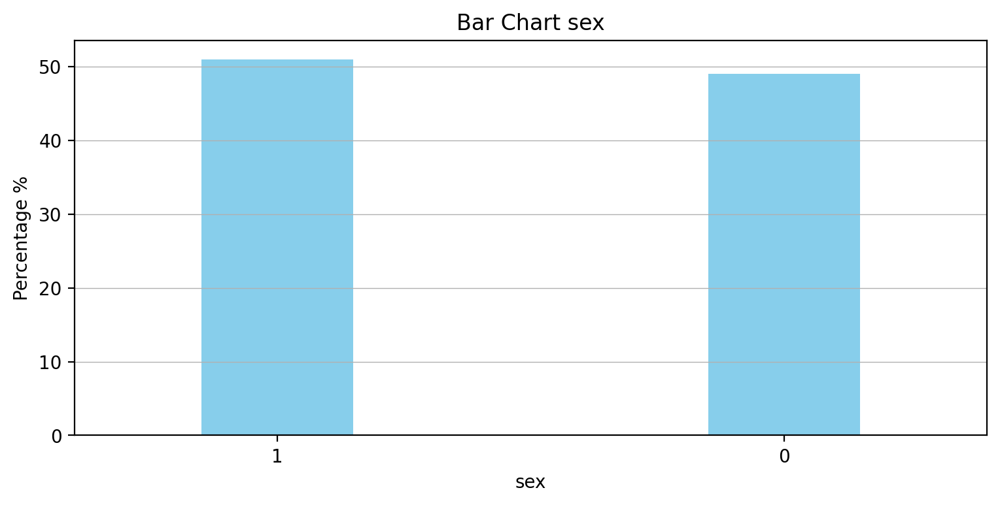





Column: scrotal_code



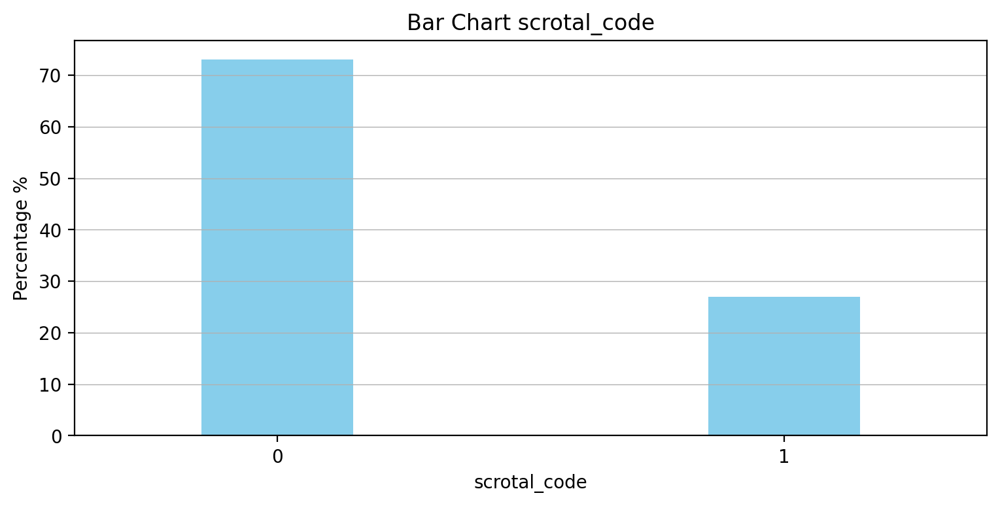





Column: lactating



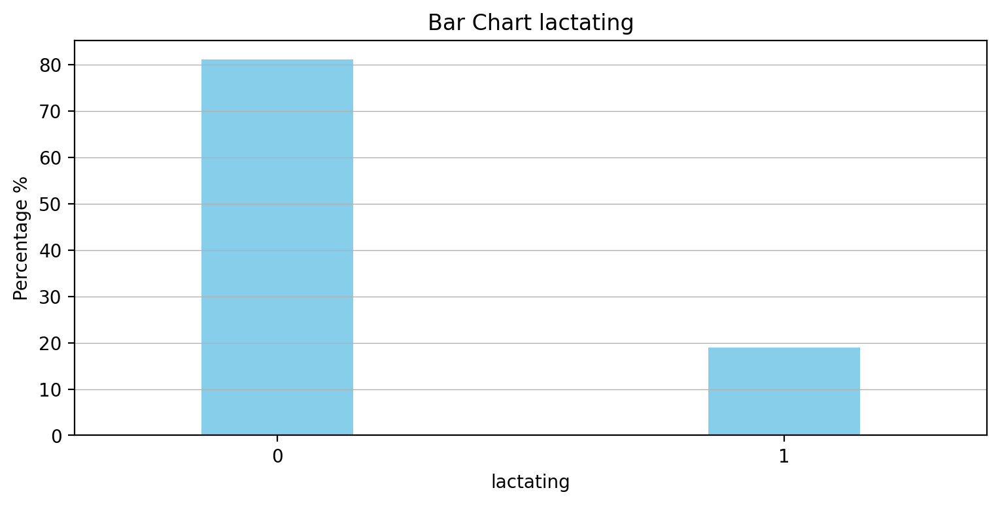





Column: perforate



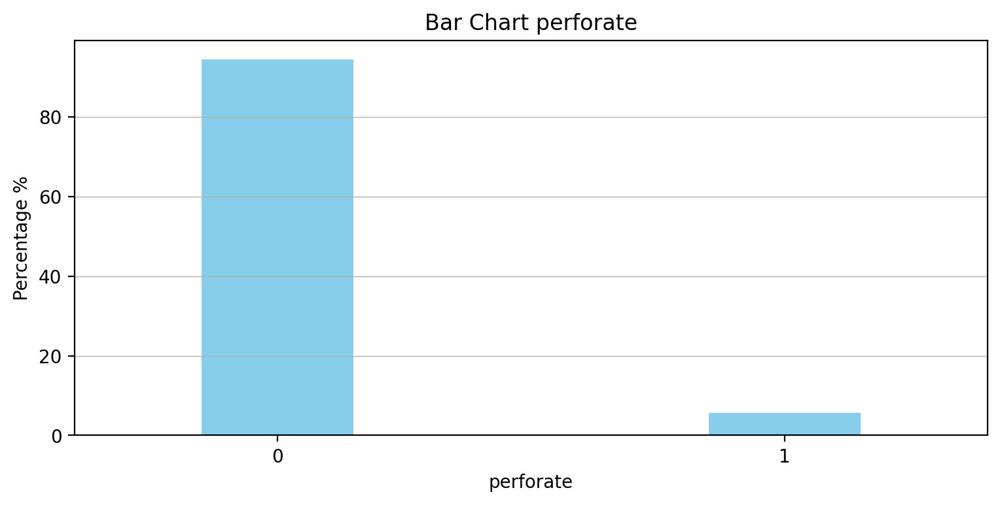





Column: pregnant



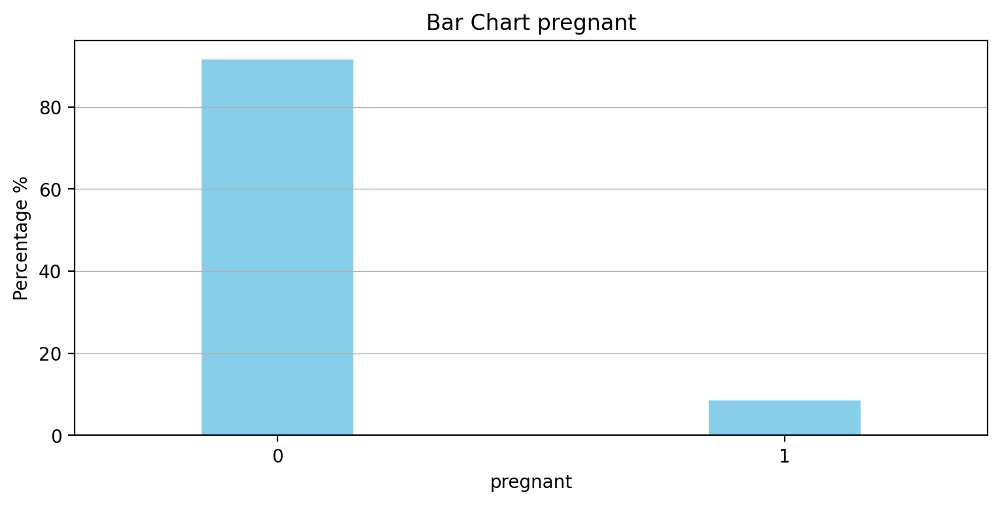





Column: age



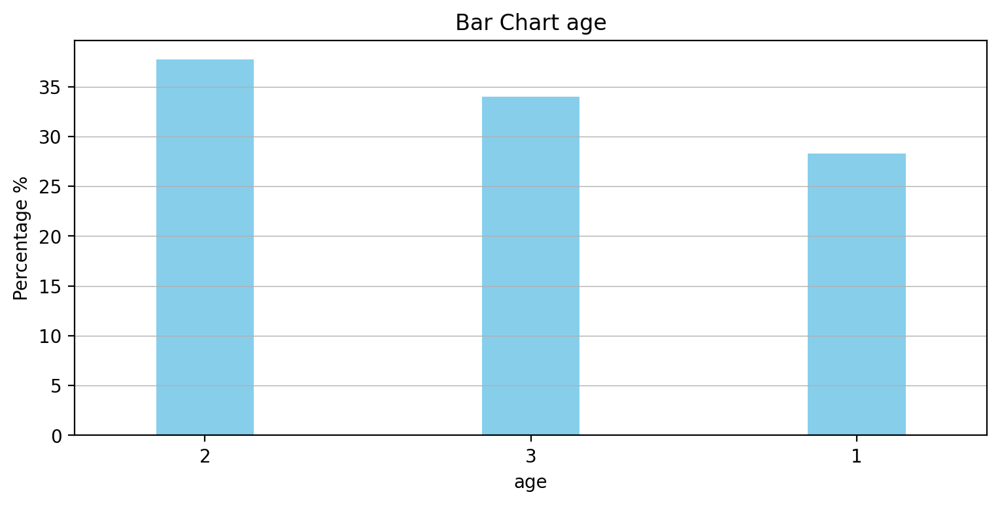







In [3042]:
for column in df_dichotomous_variables.columns:
    print(f"Column: {column}")
    print('\b')
    df_dichotomous_variables_value_counts=df_dichotomous_variables[column].value_counts(normalize=True) * 100
    plt.figure(figsize=(9,4),dpi=200)
    df_dichotomous_variables_value_counts.plot(kind='bar',color='skyblue', width=0.3)
    plt.xticks(rotation =0)
    plt.title(f'Bar Chart {column}')
    plt.xlabel(f'{column}')
    plt.ylabel('Percentage %')
    plt.grid(axis='y',linewidth=0.5)
    plt.show()
    print('\b')
    print('\b')
    print('\b')
    print('\b')

<a id="grouped-statistics-by-age"></a>
# Grouped Statistics by age

In [3043]:
pivot_table_by_age = df.pivot_table(index='age',
                                     values=['weight',
                                             'nose_anus',
                                             'anus_tail',
                                             'avg_foot',
                                             'avg_femur',
                                             'skull_length',
                                             'skull_width',
                                             'eye_lens',
                                             'sex',
                                             'scrotal_code',
                                             'lactating',
                                             'perforate',
                                             'pregnant'],
                                     aggfunc={'weight': 'mean',
                                              'nose_anus': 'mean',
                                              'anus_tail':'mean',
                                              'avg_foot':'mean',
                                              'avg_femur':'mean',
                                              'skull_length':'mean',
                                              'skull_width':'mean',
                                              'eye_lens':'mean',
                                              'sex':'mean',
                                              'scrotal_code':'mean',
                                              'lactating':'mean',
                                              'perforate':'mean',
                                              'pregnant':'mean'
                                             })
pivot_table_by_age

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,sex,skull_length,skull_width,weight
age,,,,,,,,,,,,,
1,3.821923,1.213191,1.706644,4.042308,0.000000,8.129270,0.000000,0.000000,0.000000,0.503846,2.580096,1.164865,12.475000
2,4.148093,1.331039,1.760137,5.314697,0.092219,8.946455,0.048991,0.048991,0.365994,0.613833,2.697507,1.228205,15.862565
3,4.526001,1.454743,1.769364,6.501038,0.453674,9.844409,0.111821,0.194888,0.386581,0.399361,2.814681,1.270623,21.273645


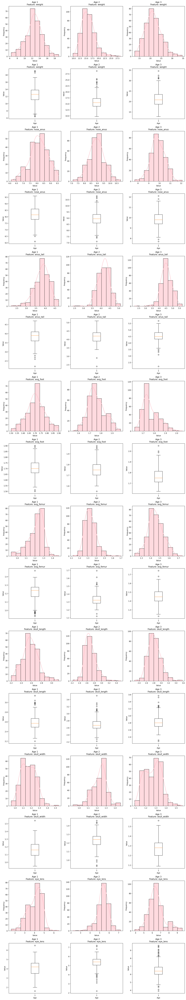

In [3044]:
features = df.columns[2:10]


custom_age_order = [1,2,3]  

# Set up subplots
num_rows = len(features) * 2
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=200)

# Loop through features
for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = df[df['age'] == age]
        
        # Histogram 
        ax_hist = axes[i * 2, j]
        sns.histplot(data=age_data, x=feature, bins=10, kde=True, ax=ax_hist, color='lightpink')
        ax_hist.set_title(f'Age {age}\nFeature: {feature}')
        ax_hist.set_xlabel('Value')
        ax_hist.set_ylabel('Frequency')
        
        # Box plot 
        ax_box = axes[i * 2 + 1, j]
        age_feature_data = age_data[feature]
        ax_box.boxplot(age_feature_data)
        ax_box.set_title(f'Age {age}\nFeature: {feature}')
        ax_box.set_xlabel('Age')
        ax_box.set_ylabel('Value')
        
plt.tight_layout()
plt.show()
    
   

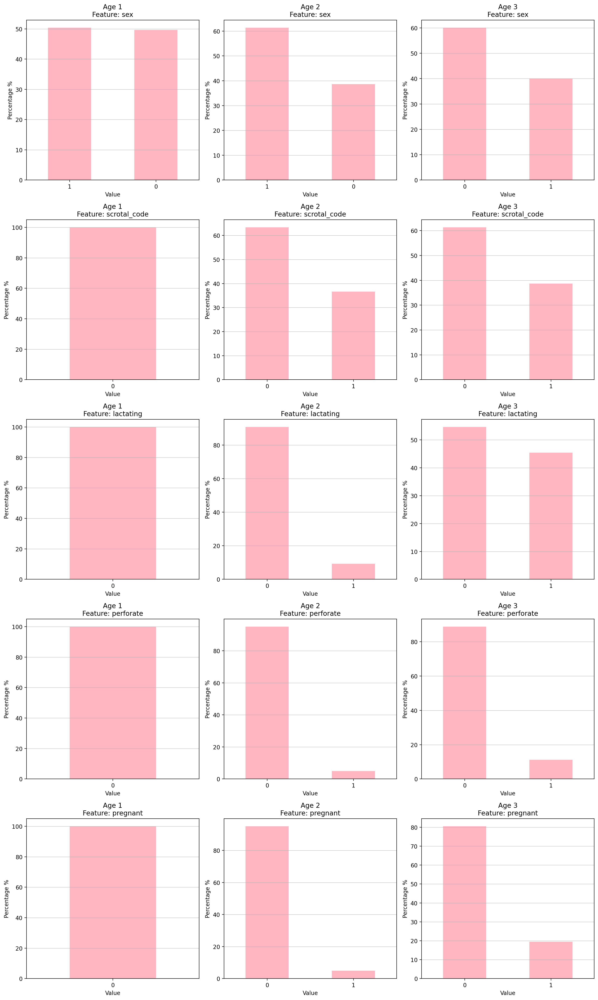

In [3045]:
features = df.columns[10:15]


custom_age_order = [1, 2, 3]  

# Set up subplots 
num_rows = len(features)
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), dpi=200, facecolor='white')

# Loop through features
for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = df[df['age'] == age]
        age_feature_data = age_data[feature]
        
        # Calculate value counts as percentages
        value_counts_percent = age_feature_data.value_counts(normalize=True) * 100
        
        # Bar chart for percentages
        ax_bar = axes[i, j]
        value_counts_percent.plot(kind='bar', ax=ax_bar, color='lightpink')
        ax_bar.set_title(f'Age {age}\nFeature: {feature}')
        ax_bar.set_xlabel('Value')
        ax_bar.set_ylabel('Percentage %')
        
        
        ax_bar.grid(axis='y', linewidth=0.5)
        
        
        ax_bar.set_xticklabels(ax_bar.get_xticklabels(), rotation=0)
        
plt.tight_layout()
plt.show()

## Grouped Statistics by age (males only)

In [3046]:
males=df[df['sex'] ==1]
males

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,141,2,16.750825,8.7,4.90,1.9000,1.450000,2.860,1.37,6.4,1,1,0,0,0,3
1,142,2,18.700000,9.8,4.75,1.8750,1.640000,3.255,1.27,6.6,1,1,0,0,0,3
2,143,2,15.900000,8.8,4.40,1.8000,1.340000,3.050,1.27,5.7,1,1,0,0,0,2
4,145,2,13.800000,8.9,4.50,1.9000,1.290000,3.140,1.26,4.4,1,0,0,0,0,1
6,147,2,14.500000,9.1,4.00,1.9000,1.400000,2.840,1.27,5.2,1,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
910,137,1,13.300000,8.6,4.00,1.6725,1.261364,2.610,1.13,4.8,1,0,0,0,0,1
911,138,1,14.300000,8.0,3.90,1.7500,1.284167,2.710,1.21,6.0,1,0,0,0,0,2
915,367,3,13.600000,7.7,4.00,1.6875,1.268205,2.310,1.03,4.4,1,0,0,0,0,1
916,369,3,12.000000,7.3,3.70,1.5625,1.231720,2.290,1.13,3.2,1,0,0,0,0,1


In [3047]:
pivot_table_by_age_males = males.pivot_table(index='age',
                                     values=['weight',
                                             'nose_anus',
                                             'anus_tail',
                                             'avg_foot',
                                             'avg_femur',
                                             'skull_length',
                                             'skull_width',
                                             'eye_lens',
                                             'scrotal_code',
                                             'lactating',
                                             'perforate',
                                             'pregnant'],
                                     aggfunc={'weight': 'mean',
                                              'nose_anus': 'mean',
                                              'anus_tail':'mean',
                                              'avg_foot':'mean',
                                              'avg_femur':'mean',
                                              'skull_length':'mean',
                                              'skull_width':'mean',
                                              'eye_lens':'mean',
                                              'scrotal_code':'mean',
                                              'lactating':'mean',
                                              'perforate':'mean',
                                              'pregnant':'mean'
                                             })
pivot_table_by_age_males

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
age,,,,,,,,,,,,
1,3.841221,1.216438,1.716240,3.998473,0,8.189773,0,0,0.000000,2.578473,1.173969,12.583969
2,4.110509,1.318900,1.759319,5.302347,0,8.872394,0,0,0.596244,2.673779,1.222615,15.396761
3,4.341107,1.430618,1.779780,6.792500,0,9.660400,0,0,0.968000,2.805640,1.267800,19.654807


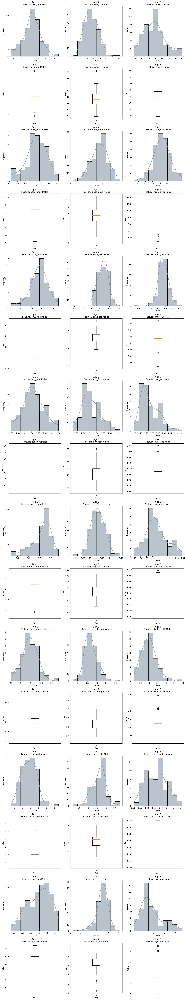

In [3048]:

features = males.columns[2:10]


custom_age_order = [1,2,3]  

# Set up subplots
num_rows = len(features) * 2
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=200)

# Loop through features
for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = males[males['age'] == age]
        
        # Histogram (using seaborn)
        ax_hist = axes[i * 2, j]
        sns.histplot(data=age_data, x=feature, bins=10, kde=True, ax=ax_hist, color='lightslategrey')
        ax_hist.set_title(f'Age {age}\nFeature: {feature} Males')
        ax_hist.set_xlabel('Value')
        ax_hist.set_ylabel('Frequency')
        
        # Box plot (using matplotlib)
        ax_box = axes[i * 2 + 1, j]
        age_feature_data = age_data[feature]
        ax_box.boxplot(age_feature_data)
        ax_box.set_title(f'Age {age}\nFeature: {feature} Males')
        ax_box.set_xlabel('Age')
        ax_box.set_ylabel('Value')
        
plt.tight_layout()
plt.show()

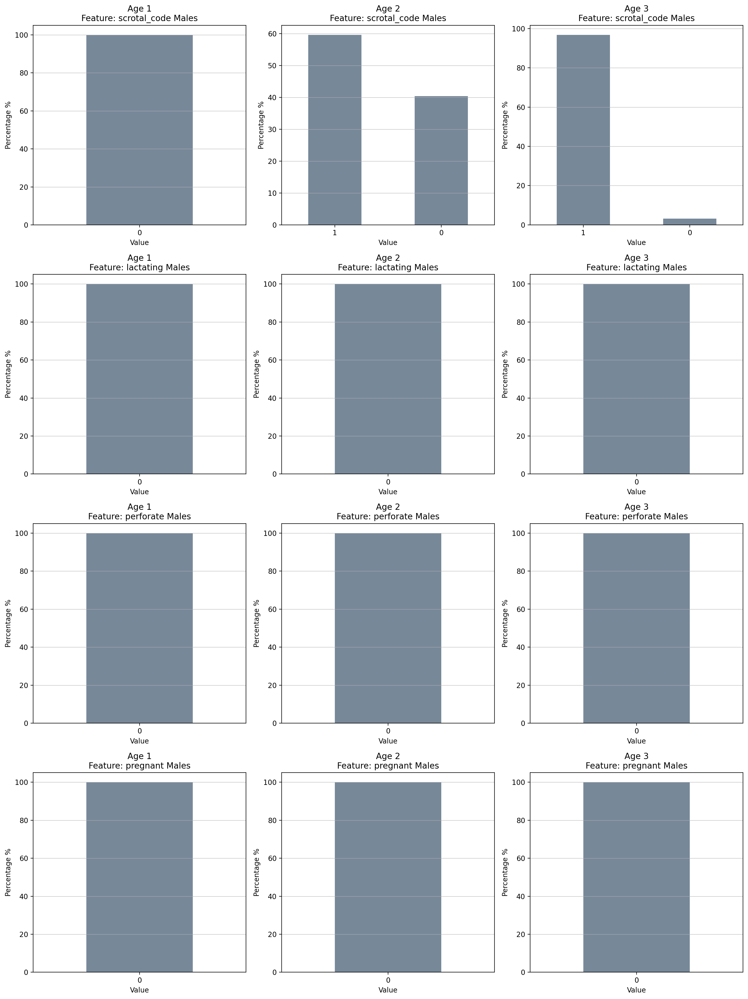

In [3049]:

features = males.columns[11:15]


custom_age_order = [1, 2, 3]  


num_rows = len(features)
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), dpi=200, facecolor='white')

# Loop through features
for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = males[males['age'] == age]
        age_feature_data = age_data[feature]
        
        # Calculate value counts as percentages
        value_counts_percent = age_feature_data.value_counts(normalize=True) * 100
        
        # Bar chart for percentages
        ax_bar = axes[i, j]
        value_counts_percent.plot(kind='bar', ax=ax_bar, color='lightslategrey')
        ax_bar.set_title(f'Age {age}\nFeature: {feature} Males')
        ax_bar.set_xlabel('Value')
        ax_bar.set_ylabel('Percentage %')
        
      
        ax_bar.grid(axis='y', linewidth=0.5)
        
       
        ax_bar.set_xticklabels(ax_bar.get_xticklabels(), rotation=0)
        
plt.tight_layout()
plt.show()

## Grouped Statistics by age (females only)

In [3050]:
females=df[df['sex'] ==0]
females

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
3,144,2,12.6,8.0,3.20,1.8000,1.470000,2.98,1.230,4.3,0,0,0,0,0,1
5,146,2,23.7,9.6,3.80,1.9000,1.420000,3.51,1.310,4.2,0,0,0,0,1,2
7,148,2,13.8,9.0,4.20,1.9000,1.285000,3.26,1.310,4.4,0,0,0,0,0,2
8,149,2,29.5,10.7,5.15,1.8500,1.600000,3.09,1.310,8.4,0,0,1,0,1,3
11,152,2,17.7,9.7,4.80,1.9000,1.390000,3.38,1.270,6.0,0,0,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
912,139,1,13.0,8.1,3.40,1.7200,1.254523,2.63,1.150,4.4,0,0,0,0,0,1
913,140,2,22.2,9.9,4.70,1.8000,1.464313,2.97,1.235,9.4,0,0,0,0,0,3
914,319,2,10.9,7.9,3.70,1.7750,1.206636,2.61,1.230,4.2,0,0,0,0,0,1
918,572,3,19.3,9.1,4.60,1.6125,1.398184,3.10,1.170,5.4,0,0,0,0,1,2


In [3051]:
pivot_table_by_age_females = females.pivot_table(index='age',
                                     values=['weight',
                                             'nose_anus',
                                             'anus_tail',
                                             'avg_foot',
                                             'avg_femur',
                                             'skull_length',
                                             'skull_width',
                                             'eye_lens',
                                             'scrotal_code',
                                             'lactating',
                                             'perforate',
                                             'pregnant'],
                                     aggfunc={'weight': 'mean',
                                              'nose_anus': 'mean',
                                              'anus_tail':'mean',
                                              'avg_foot':'mean',
                                              'avg_femur':'mean',
                                              'skull_length':'mean',
                                              'skull_width':'mean',
                                              'eye_lens':'mean',
                                              'scrotal_code':'mean',
                                              'lactating':'mean',
                                              'perforate':'mean',
                                              'pregnant':'mean'
                                             })
pivot_table_by_age_females

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
age,,,,,,,,,,,,
1,3.802326,1.209895,1.696899,4.086822,0.000000,8.067829,0.000000,0.000000,0,2.581744,1.15562,12.364341
2,4.207836,1.350336,1.761437,5.334328,0.238806,9.064179,0.126866,0.126866,0,2.735224,1.23709,16.602985
3,4.648936,1.470783,1.762439,6.307247,0.755319,9.966755,0.186170,0.324468,0,2.820691,1.27250,22.350000


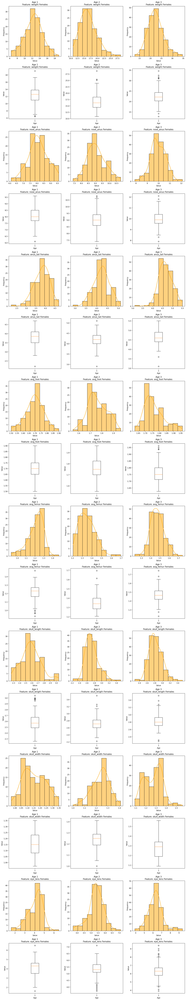

In [3052]:

features = females.columns[2:10]


custom_age_order = [1,2,3]  

# Set up subplots
num_rows = len(features) * 2
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=200)

# Loop through features
for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = females[females['age'] == age]
        
        # Histogram (using seaborn)
        ax_hist = axes[i * 2, j]
        sns.histplot(data=age_data, x=feature, bins=10, kde=True, ax=ax_hist, color='orange')
        ax_hist.set_title(f'Age {age}\nFeature: {feature} Females')
        ax_hist.set_xlabel('Value')
        ax_hist.set_ylabel('Frequency')
        
        # Box plot (using matplotlib)
        ax_box = axes[i * 2 + 1, j]
        age_feature_data = age_data[feature]
        ax_box.boxplot(age_feature_data)
        ax_box.set_title(f'Age {age}\nFeature: {feature} Females')
        ax_box.set_xlabel('Age')
        ax_box.set_ylabel('Value')
        
plt.tight_layout()
plt.show()

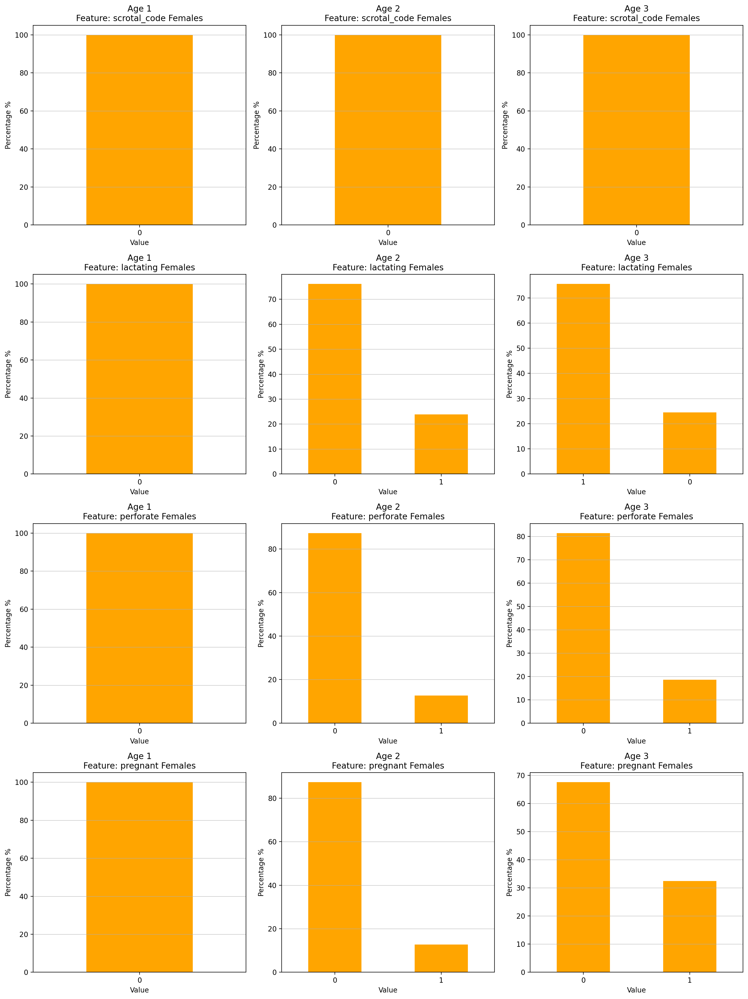

In [3053]:

features = females.columns[11:15]


custom_age_order = [1, 2, 3]  


num_rows = len(features)
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), dpi=200, facecolor='white')

# Loop through features
for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = females[females['age'] == age]
        age_feature_data = age_data[feature]
        
        # Calculate value counts as percentages
        value_counts_percent = age_feature_data.value_counts(normalize=True) * 100
        
        # Bar chart for percentages
        ax_bar = axes[i, j]
        value_counts_percent.plot(kind='bar', ax=ax_bar, color='orange')
        ax_bar.set_title(f'Age {age}\nFeature: {feature} Females')
        ax_bar.set_xlabel('Value')
        ax_bar.set_ylabel('Percentage %')
        
      
        ax_bar.grid(axis='y', linewidth=0.5)
        
        
        ax_bar.set_xticklabels(ax_bar.get_xticklabels(), rotation=0)
        
plt.tight_layout()
plt.show()

<a id="building-model"></a>
# Building Decision Tree Classifier Model for Age Prediction

In [3054]:
df_model=df.copy()

In [3055]:
df_model.drop(columns=['ref','year'],inplace=True)

In [3056]:
X=df_model.drop(columns='age')

In [3057]:
y=df_model['age']

In [3058]:
X_train, X_test, y_train, y_test =train_test_split(X, y, test_size=0.25, random_state=87)

In [3059]:
len(X_train)

690

In [3060]:
X_train

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
795,23.9,11.80,4.2,1.7725,1.503079,2.79,1.33,6.8,0,0,1,0,1
73,16.6,8.90,3.7,1.7375,1.200000,2.58,1.25,4.2,1,0,0,0,0
114,12.5,7.85,3.8,1.8375,1.250000,2.57,1.26,4.1,1,1,0,0,0
852,19.2,9.90,4.5,1.8050,1.395904,3.29,1.31,7.9,1,1,0,0,0
829,20.3,10.30,5.2,1.8250,1.420987,2.88,1.32,6.9,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
251,18.8,9.60,4.3,1.7250,1.408750,2.75,1.16,6.1,0,0,1,0,0
143,15.2,9.00,4.7,1.7250,1.430000,2.84,1.25,6.3,0,0,0,0,0
699,20.6,9.80,5.0,1.7250,1.485000,2.64,1.21,6.6,0,0,1,0,1
333,15.0,9.30,3.9,1.6750,1.338750,2.61,1.12,5.9,1,1,0,0,0


In [3061]:
X_test

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
460,12.9,8.4,4.2,1.7250,1.34500,2.69,1.07,5.3,1,0,0,0,0
511,11.1,7.7,4.2,1.7375,1.35000,2.46,1.23,5.2,0,0,0,0,0
772,18.0,9.0,4.4,1.7250,1.30750,2.50,1.19,5.1,0,0,0,0,0
722,18.1,9.5,4.4,1.6750,1.40250,2.54,1.26,5.2,0,0,1,0,0
346,12.6,8.3,3.8,1.7125,1.27750,2.72,1.08,4.2,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
487,17.2,9.3,3.9,1.7500,1.27000,2.52,1.32,5.6,0,0,0,0,0
496,16.5,8.3,4.3,1.7875,1.33250,2.65,1.41,6.1,1,1,0,0,0
647,17.6,9.4,4.4,1.7000,1.41750,2.50,1.25,5.1,0,0,1,0,0
221,12.6,8.0,3.6,1.7625,1.19125,2.88,1.25,5.0,1,0,0,0,0


In [3062]:
len(X_test)

230

In [3063]:
y_train_value_counts=y_train.value_counts()
y_train_value_counts

age
2    255
3    249
1    186
Name: count, dtype: int64

In [3064]:
y_train.unique()

array([3, 2, 1])

In [3065]:
model=DecisionTreeClassifier(random_state=87)
model.fit(X_train,y_train)

DecisionTreeClassifier(random_state=87)

In [3066]:
plt.figure(figsize=(15, 12),dpi=1000)
plot_tree(model,
          filled=True,
          feature_names=X_train.columns,
          class_names=['young','middle aged','mature'])
plt.show()

In [3067]:
model.get_depth()

12

In [3068]:
model.score(X_test,y_test)

0.8652173913043478

In [3069]:
y_test.value_counts()

age
2    92
1    74
3    64
Name: count, dtype: int64

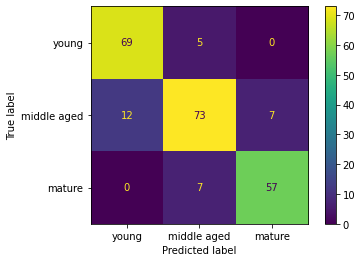

In [3070]:
plot_confusion_matrix(model,X_test,y_test, display_labels=['young','middle aged','mature'])

### Cost Complexity Pruning

In [3071]:
path = model.cost_complexity_pruning_path(X_train, y_train) 
path

{'ccp_alphas': array([0.        , 0.00095966, 0.0011432 , 0.00124224, 0.00134576,
        0.00141449, 0.00141908, 0.00186335, 0.00193237, 0.00193237,
        0.00193237, 0.00208025, 0.00217391, 0.00217391, 0.00217391,
        0.00220842, 0.00245262, 0.00246377, 0.00266193, 0.00272232,
        0.00272805, 0.00292271, 0.0031631 , 0.00321873, 0.00345131,
        0.00543631, 0.00548417, 0.00564277, 0.0058394 , 0.00601782,
        0.00746098, 0.00864018, 0.00980023, 0.01804312, 0.02743659,
        0.03268264, 0.03359605, 0.05455077, 0.13186014, 0.18224978]),
 'impurities': array([0.        , 0.00287897, 0.00859499, 0.01107946, 0.01646248,
        0.02777843, 0.03061659, 0.03247994, 0.03441231, 0.03634468,
        0.03827705, 0.04659803, 0.04877194, 0.05094586, 0.05311977,
        0.05532819, 0.06023343, 0.06516096, 0.0837945 , 0.08651683,
        0.08924487, 0.09216758, 0.09849378, 0.1113687 , 0.11482001,
        0.12025632, 0.13670882, 0.1423516 , 0.148191  , 0.15420882,
        0.16166981

In [3072]:
len(path.ccp_alphas)

40

In [3073]:
ccp_alphas=path.ccp_alphas
ccp_alphas

array([0.        , 0.00095966, 0.0011432 , 0.00124224, 0.00134576,
       0.00141449, 0.00141908, 0.00186335, 0.00193237, 0.00193237,
       0.00193237, 0.00208025, 0.00217391, 0.00217391, 0.00217391,
       0.00220842, 0.00245262, 0.00246377, 0.00266193, 0.00272232,
       0.00272805, 0.00292271, 0.0031631 , 0.00321873, 0.00345131,
       0.00543631, 0.00548417, 0.00564277, 0.0058394 , 0.00601782,
       0.00746098, 0.00864018, 0.00980023, 0.01804312, 0.02743659,
       0.03268264, 0.03359605, 0.05455077, 0.13186014, 0.18224978])

In [3074]:
models=[]  




for ccp_alpha in ccp_alphas:
    model=DecisionTreeClassifier(random_state=0,ccp_alpha=ccp_alpha)
    model.fit(X_train,y_train)
    models.append(model)

In [3075]:
models

[DecisionTreeClassifier(random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0009596553074813907, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0011432046214654907, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0012422360248447208, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0013457556935817802, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0014144927536231876, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0014190821256038664, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0018633540372670803, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.001932367149758454, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.001932367149758454, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.001932367149758454, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.0020802458866445756, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.002173913043478261, random_state=0),
 DecisionTreeClassifier(ccp_alpha=0.002173913043478261, random_state=0),
 D

In [3076]:
train_score=[]

for model in models:
    score=model.score(X_train,y_train)
    train_score.append(score)

train_score   

[1.0,
 0.9985507246376811,
 0.9956521739130435,
 0.9942028985507246,
 0.991304347826087,
 0.9855072463768116,
 0.9840579710144928,
 0.9826086956521739,
 0.9753623188405797,
 0.9753623188405797,
 0.9753623188405797,
 0.9710144927536232,
 0.9666666666666667,
 0.9666666666666667,
 0.9666666666666667,
 0.9652173913043478,
 0.9623188405797102,
 0.9507246376811594,
 0.9507246376811594,
 0.9492753623188406,
 0.9478260869565217,
 0.9449275362318841,
 0.9405797101449276,
 0.9333333333333333,
 0.9304347826086956,
 0.927536231884058,
 0.9159420289855073,
 0.9130434782608695,
 0.9101449275362319,
 0.9028985507246376,
 0.8913043478260869,
 0.8840579710144928,
 0.8768115942028986,
 0.8768115942028986,
 0.8347826086956521,
 0.8202898550724638,
 0.8202898550724638,
 0.7797101449275362,
 0.5971014492753624,
 0.3695652173913043]

In [3077]:
test_score=[]

for model in models:
    score=model.score(X_test,y_test)
    test_score.append(score)
    
test_score

[0.8869565217391304,
 0.8869565217391304,
 0.8913043478260869,
 0.8913043478260869,
 0.8913043478260869,
 0.9043478260869565,
 0.9,
 0.9,
 0.8956521739130435,
 0.8956521739130435,
 0.8956521739130435,
 0.8956521739130435,
 0.9,
 0.9,
 0.9,
 0.9,
 0.8956521739130435,
 0.8913043478260869,
 0.8913043478260869,
 0.8913043478260869,
 0.8869565217391304,
 0.8869565217391304,
 0.8956521739130435,
 0.8869565217391304,
 0.8869565217391304,
 0.8826086956521739,
 0.8869565217391304,
 0.8782608695652174,
 0.8739130434782608,
 0.8695652173913043,
 0.8565217391304348,
 0.8521739130434782,
 0.8434782608695652,
 0.8434782608695652,
 0.8130434782608695,
 0.7956521739130434,
 0.7956521739130434,
 0.7652173913043478,
 0.5521739130434783,
 0.4]

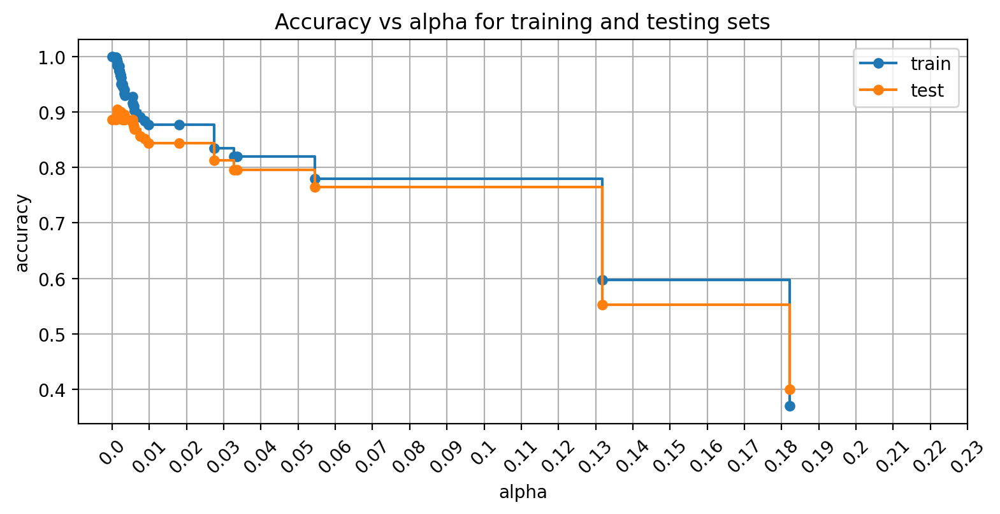

In [3078]:
train_scores = [model.score(X_train, y_train) for model in models]
test_scores = [model.score(X_test, y_test) for model in models]



fig, ax = plt.subplots(figsize=(9,4), dpi=200)
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker='o',markersize=5, label="train", drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o',markersize=5, label="test", drawstyle="steps-post")
ax.legend()

new_xticks = np.arange(0,0.24,0.01)  
ax.set_xticks(new_xticks)
ax.set_xticklabels(new_xticks, rotation=45)  
ax.grid(True)

plt.show()

In [3079]:
model = DecisionTreeClassifier(random_state=1, ccp_alpha=0.005)
model.fit(X_train,y_train)
model.score(X_test,y_test)

0.8869565217391304

### Performing 5-Fold Cross Validation

In [3080]:
len(X_train)

690

In [3081]:
model = DecisionTreeClassifier(random_state=1, ccp_alpha=0.005) 
scores = cross_val_score(model, X_train, y_train, cv=5) 
scores

array([0.89855072, 0.87681159, 0.83333333, 0.86956522, 0.87681159])

In [3082]:
np.mean(scores)

0.8710144927536232

<Axes: xlabel='tree'>

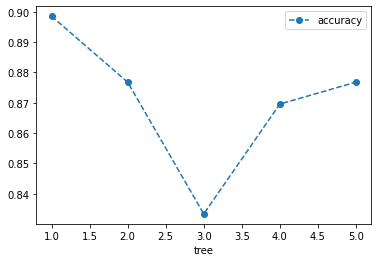

In [3083]:
cv_scores = pd.DataFrame(data={'tree': range(1,6,1), 'accuracy': scores})
cv_scores.plot(x='tree', y='accuracy', marker='o', linestyle='--')

In [3084]:

alpha_loop_values = []


for ccp_alpha in ccp_alphas:
    model = DecisionTreeClassifier(random_state=1, ccp_alpha=ccp_alpha)
    scores = cross_val_score(model, X_train, y_train, cv=5)
    alpha_loop_values.append([ccp_alpha, np.mean(scores), np.std(scores)])



In [3085]:
alpha_loop_values

[[0.0, 0.8536231884057971, 0.014051245963525617],
 [0.0009596553074813907, 0.8536231884057971, 0.014051245963525617],
 [0.0011432046214654907, 0.8536231884057971, 0.014051245963525617],
 [0.0012422360248447208, 0.8565217391304347, 0.012467138068177739],
 [0.0013457556935817802, 0.8565217391304347, 0.012467138068177739],
 [0.0014144927536231876, 0.8565217391304347, 0.012467138068177739],
 [0.0014190821256038664, 0.8565217391304347, 0.012467138068177739],
 [0.0018633540372670803, 0.8695652173913043, 0.021001995284332504],
 [0.001932367149758454, 0.8695652173913043, 0.021001995284332504],
 [0.001932367149758454, 0.8695652173913043, 0.021001995284332504],
 [0.001932367149758454, 0.8695652173913043, 0.021001995284332504],
 [0.0020802458866445756, 0.8695652173913043, 0.021001995284332504],
 [0.002173913043478261, 0.8681159420289856, 0.02354793740474191],
 [0.002173913043478261, 0.8681159420289856, 0.02354793740474191],
 [0.002173913043478261, 0.8681159420289856, 0.02354793740474191],
 [0.002

In [3086]:
alpha_results = pd.DataFrame(alpha_loop_values, 
                             columns=['alpha', 'mean_accuracy', 'std'])




In [3087]:
alpha_results.head()

,alpha,mean_accuracy,std
0,0.000000,0.853623,0.014051
1,0.000960,0.853623,0.014051
2,0.001143,0.853623,0.014051
3,0.001242,0.856522,0.012467
4,0.001346,0.856522,0.012467


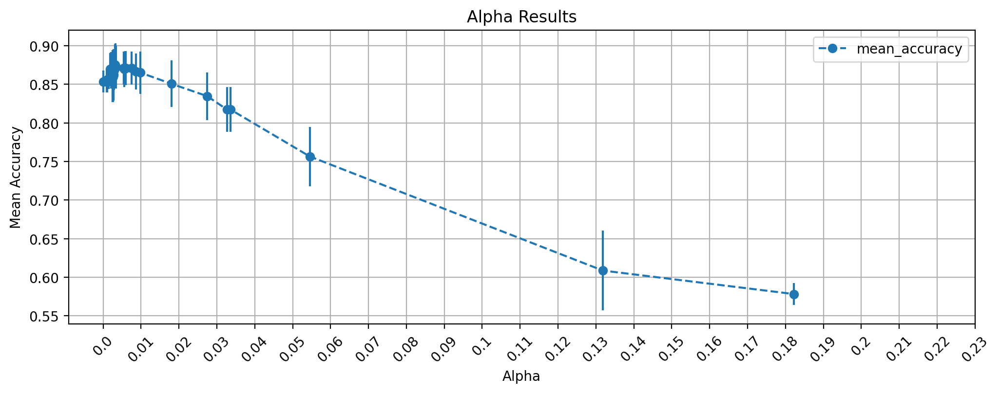

In [3088]:
fig, ax = plt.subplots(figsize=(12,4), dpi=200)  


alpha_results.plot(x='alpha', 
                   y='mean_accuracy', 
                   yerr='std', 
                   marker='o', 
                   linestyle='--',
                   ax=ax)  

ax.set_title('Alpha Results')
ax.set_xlabel('Alpha')
ax.set_ylabel('Mean Accuracy')

new_xticks = np.arange(0,0.24,0.01)  
ax.set_xticks(new_xticks)
ax.set_xticklabels(new_xticks, rotation=45)  
ax.grid(True)
plt.show()





In [3089]:
alpha_results[(alpha_results['alpha'] > 0) & (alpha_results['alpha'] < 0.01)]

,alpha,mean_accuracy,std
1,0.000960,0.853623,0.014051
2,0.001143,0.853623,0.014051
3,0.001242,0.856522,0.012467
4,0.001346,0.856522,0.012467
5,0.001414,0.856522,0.012467
6,0.001419,0.856522,0.012467
7,0.001863,0.869565,0.021002
8,0.001932,0.869565,0.021002
9,0.001932,0.869565,0.021002
10,0.001932,0.869565,0.021002


In [3090]:
alpha_results[alpha_results['mean_accuracy'] > 0.87]

,alpha,mean_accuracy,std
22,0.003163,0.875362,0.026486
23,0.003219,0.873913,0.029202
24,0.003451,0.872464,0.027726
25,0.005436,0.871014,0.021201
26,0.005484,0.871014,0.021201
28,0.005839,0.871014,0.022170
29,0.006018,0.871014,0.022170
30,0.007461,0.871014,0.021201


In [3091]:
alpha_results['mean_accuracy'].max()

0.8753623188405797

In [3092]:
ideal_ccp_alpha=alpha_results.loc[22,'alpha']
ideal_ccp_alpha

0.0031631009891879454

In [3093]:
final_model_cv_score = DecisionTreeClassifier(random_state=87, ccp_alpha=ideal_ccp_alpha) 


scores = cross_val_score(final_model_cv_score, X_train, y_train, cv=5) 
scores

array([0.92028986, 0.86956522, 0.84782609, 0.87681159, 0.89130435])

<Axes: xlabel='tree'>

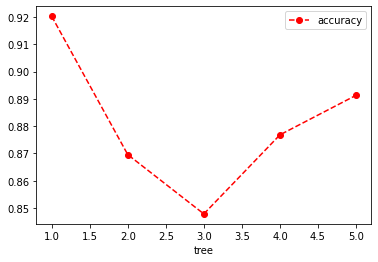

In [3094]:
cv_scores = pd.DataFrame(data={'tree': range(1,6,1), 'accuracy': scores})
cv_scores.plot(x='tree', y='accuracy', marker='o', linestyle='--',color='red')

# Building final decision tree

In [3095]:
final_model=DecisionTreeClassifier(random_state=87, ccp_alpha=ideal_ccp_alpha)
final_model.fit(X_train,y_train)

DecisionTreeClassifier(ccp_alpha=0.0031631009891879454, random_state=87)

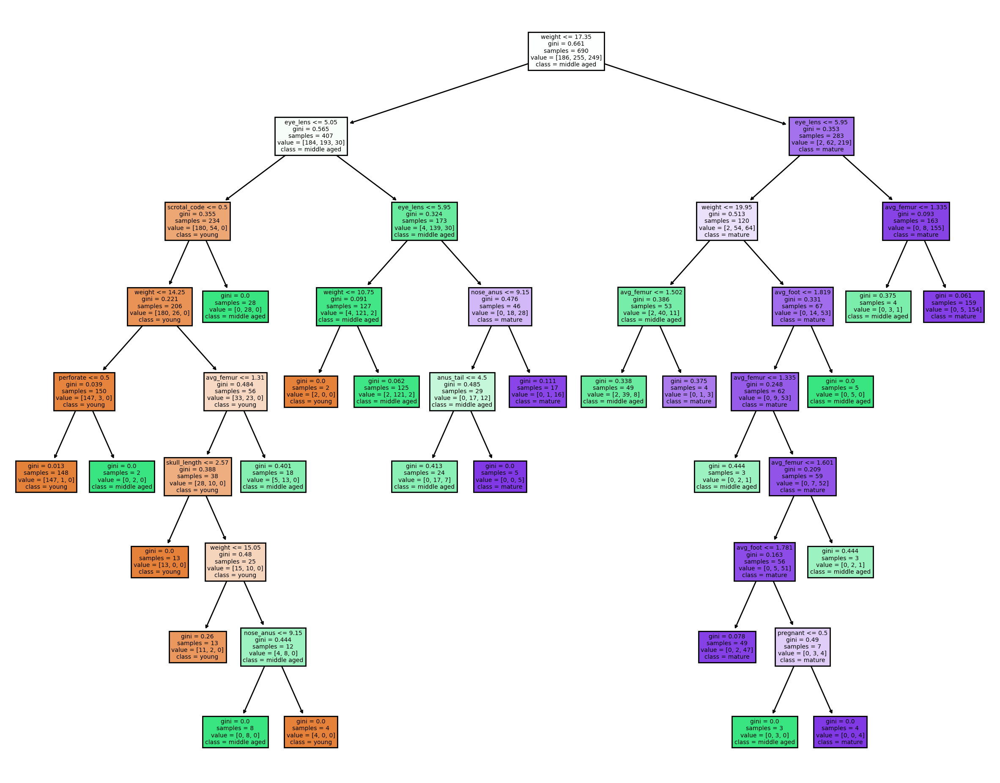

In [3096]:
plt.figure(figsize=(15, 12),dpi=200,facecolor='white')
plot_tree(final_model,
          filled=True,
          feature_names=X_train.columns,
          class_names=['young','middle aged','mature'])
plt.show()

In [3097]:
final_model.get_depth()

8

In [3098]:
feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': final_model.feature_importances_})
feature_importance_df.sort_values(by='Importance', ascending=False)

,Feature,Importance
0,weight,0.423323
7,eye_lens,0.352538
9,scrotal_code,0.097059
4,avg_femur,0.039123
1,nose_anus,0.029126
3,avg_foot,0.022186
2,anus_tail,0.010707
11,perforate,0.010040
12,pregnant,0.008841
5,skull_length,0.007057


In [3099]:
final_model.score(X_test,y_test)

0.8956521739130435

In [3100]:
len(y_test)

230

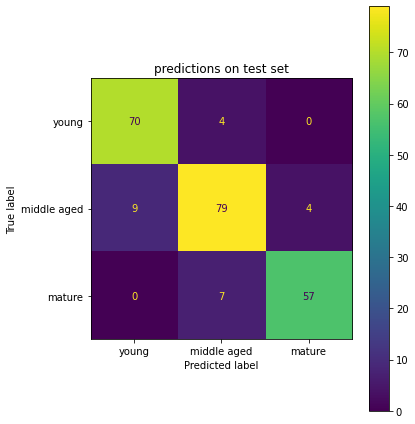

In [3101]:
fig = plt.figure(figsize=(6, 6), facecolor='white')

# Create the confusion matrix plot
ax = plt.gca()  # Get the current axes

plot_confusion_matrix(final_model,X_test,y_test, display_labels=['young','middle aged','mature'],ax=ax)
plt.tight_layout()  # Adjust layout
plt.title('predictions on test set')
plt.show()

<a id="importing-data-for-age-prediction"></a>
# Importing Data for Age Prediction

### 1 Dataset for Prediciton (nornice 2018)

In [3102]:
nornice_2018=pd.read_excel('/Users/jangrzybek/Downloads/nornice_2018.xlsx')
nornice_2018

,Ref no,Year,Site code,Sex code,Scrotal,Lactating,Peroforate,Pregnant,Weight,Anus tail,Nose anus,Average foot,Head Lenght,Head Width,Averge femur,Lens
0,1,6,1,1,0,0,0,0,11.9,4.6,8.0,1.8000,2.500,1.6,12.00,0.00260
1,2,6,1,2,0,1,0,0,25,4.4,11.1,1.8375,2.940,1.3,15.95,0.00580
2,3,6,1,1,0,0,0,0,15.7,4.4,9.1,1.7600,2.600,1.3,12.60,0.00260
3,4,6,1,2,0,0,0,0,12.2,3.9,8.0,1.7500,2.500,1.1,10.75,0.00300
4,5,6,1,2,0,0,1,0,17.6,4.8,9.3,1.8000,2.400,1.2,13.25,0.00400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,266,6,1,2,0,1,0,1,26.3,5.1,11.6,1.8000,2.632,1.21,13.50,0.00671
256,267,6,1,1,0,0,0,0,17,4.8,9.8,1.8000,2.503,1.182,13.50,0.00632
257,268,6,1,1,0,0,0,0,11.7,4.2,8.3,1.8000,2.272,1.036,11.25,0.00355
258,269,6,1,1,1,0,0,0,14.7,4,9.3,1.8000,2.286,1.127,12.25,0.00408


In [3103]:
nornice_2018.isnull().sum()

Ref no          0
Year            0
Site code       0
Sex code        0
Scrotal         0
Lactating       0
Peroforate      0
Pregnant        0
Weight          0
Anus tail       0
Nose anus       0
Average foot    0
Head Lenght     0
Head Width      0
Averge femur    0
Lens            0
dtype: int64

In [3104]:
nornice_2018.columns

Index(['Ref no', 'Year', 'Site code', 'Sex code', 'Scrotal', 'Lactating',
       'Peroforate', 'Pregnant', 'Weight', 'Anus tail', 'Nose anus',
       'Average foot', 'Head Lenght', 'Head Width', 'Averge femur', 'Lens'],
      dtype='object')

In [3105]:
df.columns

Index(['ref', 'year', 'weight', 'nose_anus', 'anus_tail', 'avg_foot',
       'avg_femur', 'skull_length', 'skull_width', 'eye_lens', 'sex',
       'scrotal_code', 'lactating', 'perforate', 'pregnant', 'age'],
      dtype='object')

In [3106]:
new_column_names2={
                  'Sex code':'sex',
                  'Scrotal':'scrotal_code',
                  'Lactating':'lactating',
                  'Peroforate':'perforate',
                  'Pregnant':'pregnant',
                  'Weight':'weight',
                  'Nose anus':'nose_anus',
                  'Anus tail':'anus_tail',
                  'Average foot':'avg_foot',
                  'Averge femur':'avg_femur',
                  'Head Lenght':'skull_length',
                  'Head Width':'skull_width',
                  'Lens':'eye_lens'}

In [3107]:
nornice_2018.rename(columns=new_column_names2,inplace=True)

In [3108]:
nornice_2018.head()

,Ref no,Year,Site code,sex,scrotal_code,lactating,perforate,pregnant,weight,anus_tail,nose_anus,avg_foot,skull_length,skull_width,avg_femur,eye_lens
0,1,6,1,1,0,0,0,0,11.9,4.6,8.0,1.8000,2.50,1.6,12.00,0.0026
1,2,6,1,2,0,1,0,0,25,4.4,11.1,1.8375,2.94,1.3,15.95,0.0058
2,3,6,1,1,0,0,0,0,15.7,4.4,9.1,1.7600,2.60,1.3,12.60,0.0026
3,4,6,1,2,0,0,0,0,12.2,3.9,8.0,1.7500,2.50,1.1,10.75,0.0030
4,5,6,1,2,0,0,1,0,17.6,4.8,9.3,1.8000,2.40,1.2,13.25,0.0040


In [3109]:
df_desired_order=['Ref no',
                  'Year',
                  'Site code',
                  'weight',
                  'nose_anus',
                  'anus_tail',
                  'avg_foot',
                  'avg_femur',
                  'skull_length',
                  'skull_width',
                  'eye_lens',
                  'sex',
                  'scrotal_code',
                  'lactating',
                  'perforate',
                  'pregnant']

len(df_desired_order)

16

In [3110]:
nornice_2018=nornice_2018.reindex(columns=df_desired_order)

In [3111]:
nornice_2018

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,6,1,11.9,8.0,4.6,1.8000,12.00,2.500,1.6,0.00260,1,0,0,0,0
1,2,6,1,25,11.1,4.4,1.8375,15.95,2.940,1.3,0.00580,2,0,1,0,0
2,3,6,1,15.7,9.1,4.4,1.7600,12.60,2.600,1.3,0.00260,1,0,0,0,0
3,4,6,1,12.2,8.0,3.9,1.7500,10.75,2.500,1.1,0.00300,2,0,0,0,0
4,5,6,1,17.6,9.3,4.8,1.8000,13.25,2.400,1.2,0.00400,2,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,266,6,1,26.3,11.6,5.1,1.8000,13.50,2.632,1.21,0.00671,2,0,1,0,1
256,267,6,1,17,9.8,4.8,1.8000,13.50,2.503,1.182,0.00632,1,0,0,0,0
257,268,6,1,11.7,8.3,4.2,1.8000,11.25,2.272,1.036,0.00355,1,0,0,0,0
258,269,6,1,14.7,9.3,4,1.8000,12.25,2.286,1.127,0.00408,1,1,0,0,0


In [3112]:
nornice_2018.dtypes

Ref no            int64
Year              int64
Site code         int64
weight           object
nose_anus       float64
anus_tail        object
avg_foot        float64
avg_femur       float64
skull_length    float64
skull_width      object
eye_lens        float64
sex               int64
scrotal_code      int64
lactating         int64
perforate         int64
pregnant          int64
dtype: object

### Nornice 2018 data cleaning 

### weight

In [3113]:
nornice_2018['weight']=nornice_2018['weight'].astype(str)

In [3114]:
nornice_2018[nornice_2018['weight'].str.contains(',')]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
195,205,6,3,"13,,4",8.8,4.2,1.8,11.0,2.359,1.094,0.0046,2,0,0,0,0


In [3115]:
nornice_2018['weight']=nornice_2018['weight'].replace({'13,,4':'13.4'})

In [3116]:
nornice_2018['weight']=nornice_2018['weight'].astype(float)

### anus_tail

In [3117]:
nornice_2018['anus_tail'].unique()

array([4.6, 4.4, 3.9, 4.8, 4.7, 4.2, 4.3, 4.1, 4.9, 5.1, 5.2, 5, 4.5, 3.8,
       4, 5.4, 2.1, 5.3, 3.6, 5.6, 42, 3.5, 3.7, 1.8, 3.4, 1.9, 3.1, 9.2,
       'nd'], dtype=object)

In [3118]:
nornice_2018['anus_tail']=nornice_2018['anus_tail'].replace({'nd': np.nan})

In [3119]:
nornice_2018['anus_tail'].fillna(nornice_2018['anus_tail'].mean(),inplace=True)

### skull width

In [3120]:
nornice_2018['skull_width'].unique()

array([1.6, 1.3, 1.1, 1.2, 1.17, 1, 1.28, 1.34, 1.27, 1.22, 1.37, 1.16,
       1.43, 1.08, 1.26, 1.25, 1.19, 1.07, 1.18, 1.23, 1.12, 1.31, 1.15,
       1.29, 1.05, 1.14, 1.09, 1.24, ',1,12', 1.21, 1.205, 1.106, 1.314,
       1.185, 1.13, 1.188, 1.286, 1.378, 1.151, 1.304, 1.193, 1.138,
       1.224, 1.147, 1.275, 1.134, 1.198, 1.226, 1.101, 1.206, 1.208,
       1.352, 1.283, 1.154, ',1,284', 1.176, 1.238, 1.169, 1.233, 1.254,
       1.321, 1.266, 1.196, 1.247, 1.216, 1.157, 1.281, 1.166, 1.179,
       1.265, 1.152, 1.158, 1.111, 1.219, 1.182, 1.243, 1.189, 1.239,
       1.236, 1.172, 1.136, 1.178, 1.126, 1.322, 1.142, 1.165, 1.085,
       1.161, 1.141, 1.253, 1.257, 1.789, 1.129, 1.095, 1.059, 1.115,
       1.096, 1.148, 1.067, 1.199, 1.047, 1.241, 1.121, 1.123, 1.131,
       1.132, 1.84, 0.182, 1.094, 1.088, 1.092, 1.048, 1.204, 1.099,
       1.217, 1.149, 1.162, 1.186, 1.201, 1.054, 1.117, 1.229, 1.083,
       1.118, 1.207, 1.184, 1.104, 1.347, 1.302, 1.119, 1.177, 1.237,
       1.10

In [3121]:
nornice_2018['skull_width']=nornice_2018['skull_width'].astype(str)

In [3122]:
nornice_2018[nornice_2018['skull_width'].str.contains(',')]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
76,77,6,2,13.4,9.2,4.0,1.7,12.5,2.490,",1,12",0.0046,1,0,0,0,0
117,120,6,2,29.9,10.1,4.6,1.8,14.0,2.485,",1,284",0.0047,2,0,0,0,1


In [3123]:
nornice_2018['skull_width']=nornice_2018['skull_width'].replace({',1,12':'1.12',
                                                                 ',1,284':'1.284'})

In [3124]:
nornice_2018['skull_width']=nornice_2018['skull_width'].astype(float)                                                                                        

### sex

In [3125]:
nornice_2018['sex']=nornice_2018['sex'].replace({2:0})

### anus_tail

In [3126]:
nornice_2018['anus_tail'].sort_values().tail(10)

81      5.2
16      5.2
77      5.2
184     5.3
65      5.3
58      5.4
70      5.4
80      5.6
229     9.2
93     42.0
Name: anus_tail, dtype: float64

In [3127]:
nornice_2018['anus_tail']=nornice_2018['anus_tail'].replace({42.0:4.2,
                                                             9.2:nornice_2018['anus_tail'].mean()})

### skull_width

In [3128]:
nornice_2018['skull_width'].sort_values().head(10)

194    0.182
22     1.000
230    1.000
257    1.036
180    1.047
199    1.048
55     1.050
216    1.054
173    1.059
178    1.067
Name: skull_width, dtype: float64

In [3129]:
nornice_2018['skull_width']=nornice_2018['skull_width'].replace({0.182:1.82})

### Eye lens

In [3130]:
nornice_2018['eye_lens'].sort_values()

62     0.00000
37     0.00000
230    0.00038
223    0.00238
0      0.00260
        ...   
240    0.00890
35     0.00890
104    0.00910
65     0.00980
55     0.04100
Name: eye_lens, Length: 260, dtype: float64

In [3131]:
nornice_2018.loc[[62,37,230,55],'eye_lens']

62     0.00000
37     0.00000
230    0.00038
55     0.04100
Name: eye_lens, dtype: float64

In [3132]:
nornice_2018['eye_lens']=nornice_2018['eye_lens'].replace({0:nornice_2018['eye_lens'].mean(),
                                                           0.00038:0.0038,
                                                           0.04100:0.0041})

In [3133]:
nornice_2018['eye_lens'].sort_values()

223    0.00238
0      0.00260
2      0.00260
22     0.00260
216    0.00290
        ...   
122    0.00870
35     0.00890
240    0.00890
104    0.00910
65     0.00980
Name: eye_lens, Length: 260, dtype: float64

In [3134]:
nornice_2018['scrotal_code']=nornice_2018['scrotal_code'].replace({2:1})

In [3135]:
nornice_2018.dtypes

Ref no            int64
Year              int64
Site code         int64
weight          float64
nose_anus       float64
anus_tail       float64
avg_foot        float64
avg_femur       float64
skull_length    float64
skull_width     float64
eye_lens        float64
sex               int64
scrotal_code      int64
lactating         int64
perforate         int64
pregnant          int64
dtype: object

## Rescaling values in particular columns, nornice 2018

In [3136]:
df.head()

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,141,2,16.750825,8.7,4.90,1.900,1.45,2.860,1.37,6.4,1,1,0,0,0,3
1,142,2,18.700000,9.8,4.75,1.875,1.64,3.255,1.27,6.6,1,1,0,0,0,3
2,143,2,15.900000,8.8,4.40,1.800,1.34,3.050,1.27,5.7,1,1,0,0,0,2
3,144,2,12.600000,8.0,3.20,1.800,1.47,2.980,1.23,4.3,0,0,0,0,0,1
4,145,2,13.800000,8.9,4.50,1.900,1.29,3.140,1.26,4.4,1,0,0,0,0,1


In [3137]:
nornice_2018.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,6,1,11.9,8.0,4.6,1.8000,12.00,2.50,1.6,0.0026,1,0,0,0,0
1,2,6,1,25.0,11.1,4.4,1.8375,15.95,2.94,1.3,0.0058,0,0,1,0,0
2,3,6,1,15.7,9.1,4.4,1.7600,12.60,2.60,1.3,0.0026,1,0,0,0,0
3,4,6,1,12.2,8.0,3.9,1.7500,10.75,2.50,1.1,0.0030,0,0,0,0,0
4,5,6,1,17.6,9.3,4.8,1.8000,13.25,2.40,1.2,0.0040,0,0,0,1,0


In [3138]:
nornice_2018['avg_femur']=nornice_2018['avg_femur'] * 0.1

In [3139]:
nornice_2018['eye_lens']=nornice_2018['eye_lens'] * 1000

In [3140]:
nornice_2018.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,6,1,11.9,8.0,4.6,1.8000,1.200,2.50,1.6,2.6,1,0,0,0,0
1,2,6,1,25.0,11.1,4.4,1.8375,1.595,2.94,1.3,5.8,0,0,1,0,0
2,3,6,1,15.7,9.1,4.4,1.7600,1.260,2.60,1.3,2.6,1,0,0,0,0
3,4,6,1,12.2,8.0,3.9,1.7500,1.075,2.50,1.1,3.0,0,0,0,0,0
4,5,6,1,17.6,9.3,4.8,1.8000,1.325,2.40,1.2,4.0,0,0,0,1,0


In [3141]:
df.head()

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
0,141,2,16.750825,8.7,4.90,1.900,1.45,2.860,1.37,6.4,1,1,0,0,0,3
1,142,2,18.700000,9.8,4.75,1.875,1.64,3.255,1.27,6.6,1,1,0,0,0,3
2,143,2,15.900000,8.8,4.40,1.800,1.34,3.050,1.27,5.7,1,1,0,0,0,2
3,144,2,12.600000,8.0,3.20,1.800,1.47,2.980,1.23,4.3,0,0,0,0,0,1
4,145,2,13.800000,8.9,4.50,1.900,1.29,3.140,1.26,4.4,1,0,0,0,0,1


## Statisctics for continious variables nornice 2018

In [3142]:
df_contionious_variables_2018=nornice_2018.select_dtypes(include=['float64'])
df_contionious_variables_2018.describe()

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens
count,260.000000,260.000000,260.000000,260.000000,260.000000,260.000000,260.000000,260.000000
mean,16.728077,9.431538,4.303594,1.764269,1.262173,2.482246,1.190246,5.149527
std,4.726948,0.944608,0.507901,0.046238,0.155118,0.135500,0.100141,1.269021
min,6.200000,6.100000,1.800000,1.575000,0.800000,2.095000,1.000000,2.380000
25%,13.300000,8.800000,4.000000,1.725000,1.175000,2.400750,1.134000,4.295000
50%,15.900000,9.400000,4.300000,1.800000,1.275000,2.493000,1.180000,5.100000
75%,19.700000,10.100000,4.600000,1.800000,1.375000,2.571000,1.220000,5.800000
max,32.300000,11.600000,5.600000,1.900000,1.595000,2.940000,1.840000,9.800000


Column: weight



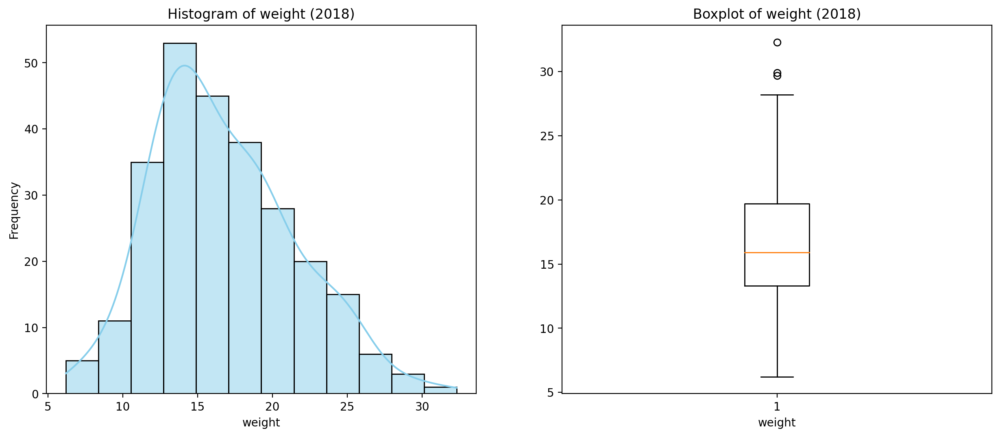





Column: nose_anus



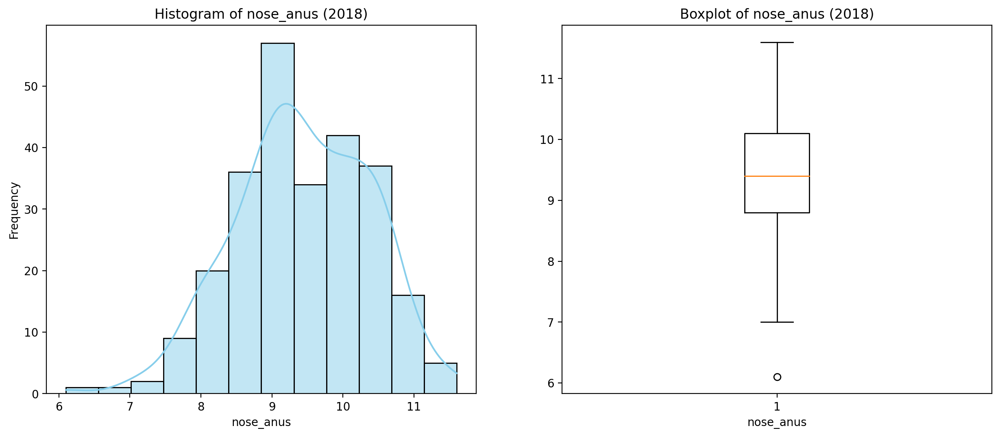





Column: anus_tail



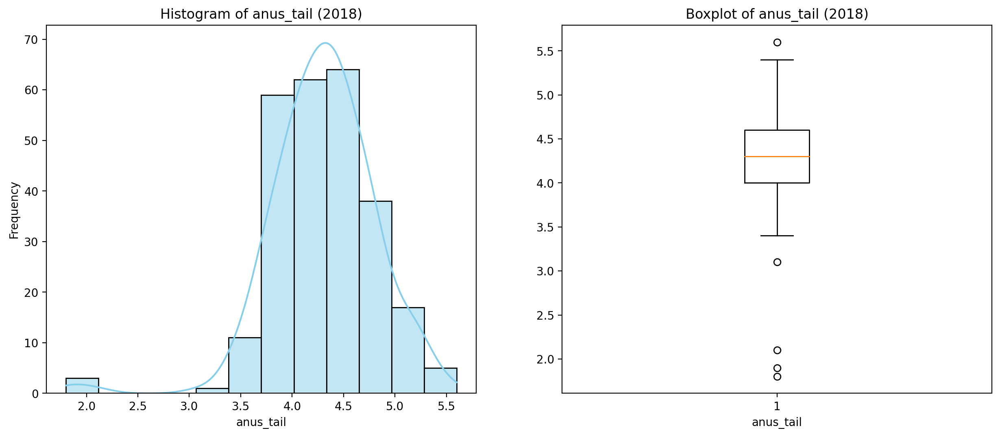





Column: avg_foot



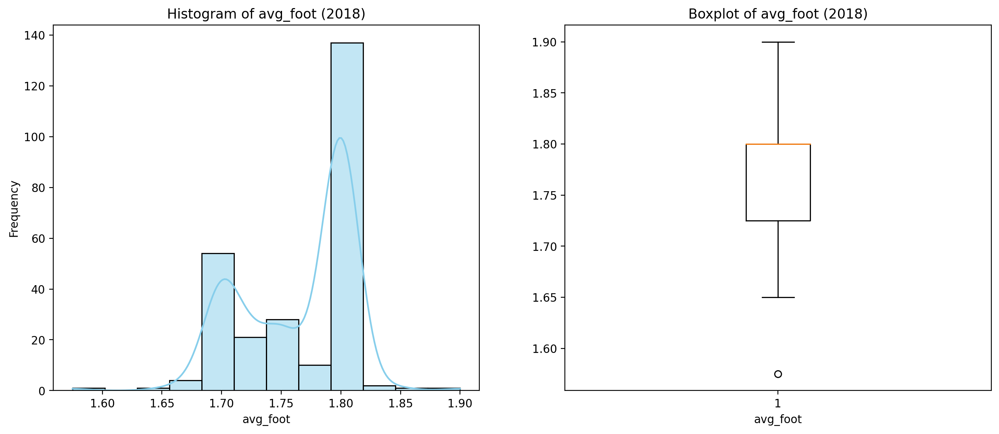





Column: avg_femur



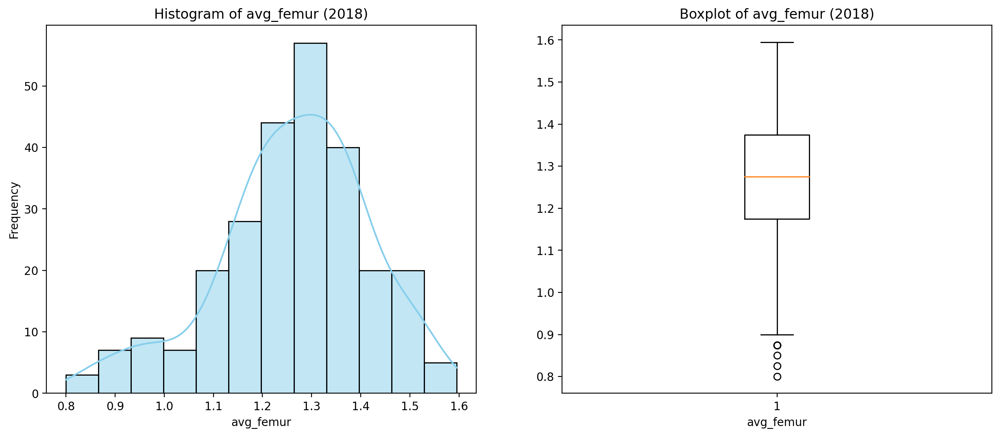





Column: skull_length



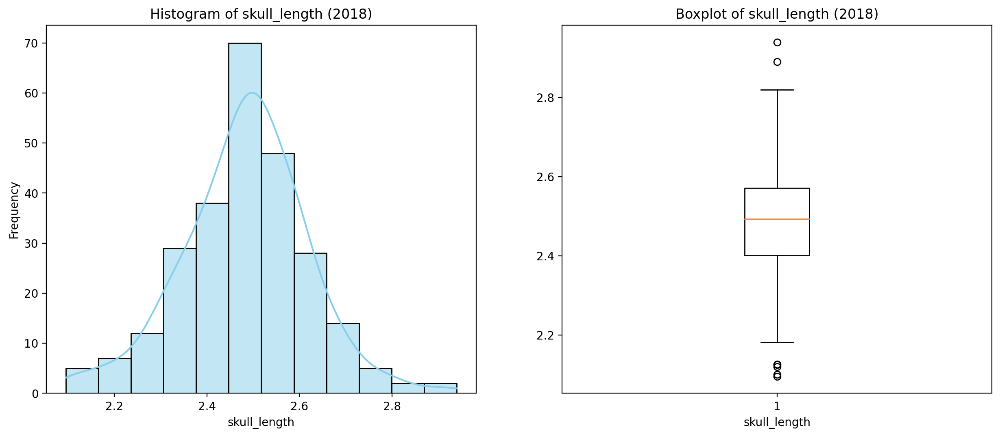





Column: skull_width



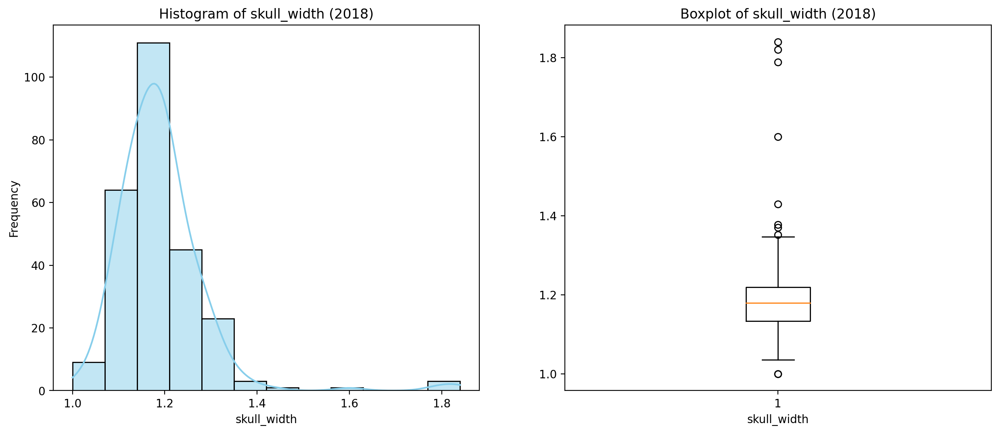





Column: eye_lens



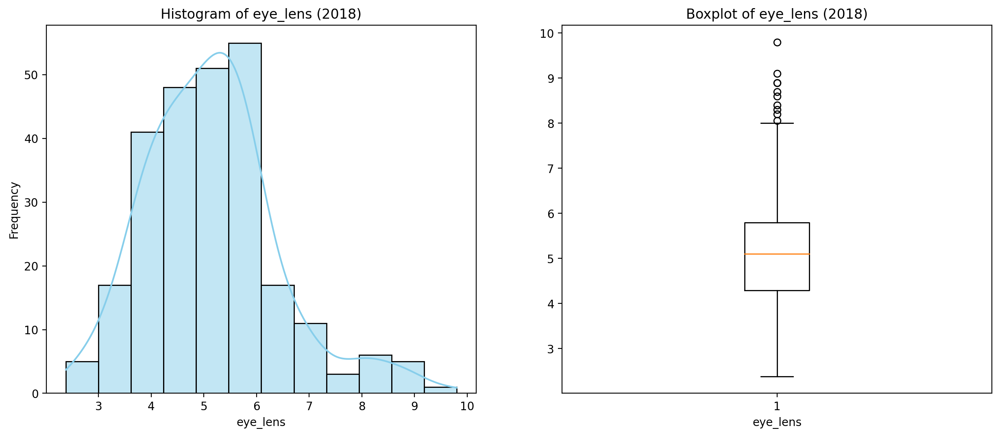







In [3143]:
for column in df_contionious_variables_2018.columns:
    print(f"Column: {column}")
    print('\b')
    plt.figure(figsize=(15,6), dpi=200)
    plt.subplot(1, 2, 1) # 1 row, 2 columns, plot at position 1
    sns.histplot(data=df_contionious_variables_2018, x=column, bins=12, kde=True, color='skyblue')
    plt.title(f'Histogram of {column} (2018)')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.subplot(1, 2, 2)
    plt.boxplot(x=column, data=df_contionious_variables_2018)
    plt.title(f'Boxplot of {column} (2018)')
    plt.xlabel(column)
    plt.show()
    print('\b')
    print('\b')
    print('\b')
    print('\b')

## Statisctics for binary variables nornice_2018

In [3144]:
df_dichotomous_variables_2018=nornice_2018.select_dtypes(include=['int'])
df_dichotomous_variables_2018.drop(columns=['Ref no','Year','Site code'],inplace=True)
for column in df_dichotomous_variables_2018.columns:
    df_dichotomous_variables_2018[column]=df_dichotomous_variables_2018[column].astype(str)
df_dichotomous_variables_2018.describe()

,sex,scrotal_code,lactating,perforate,pregnant
count,260,260,260,260,260
unique,2,2,2,2,2
top,1,0,0,0,0
freq,144,180,209,237,234


Column: sex



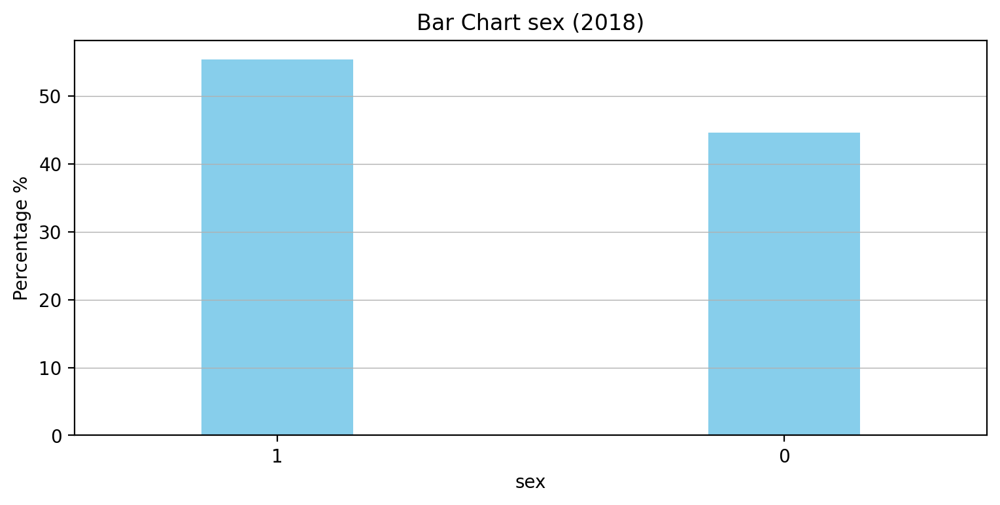





Column: scrotal_code



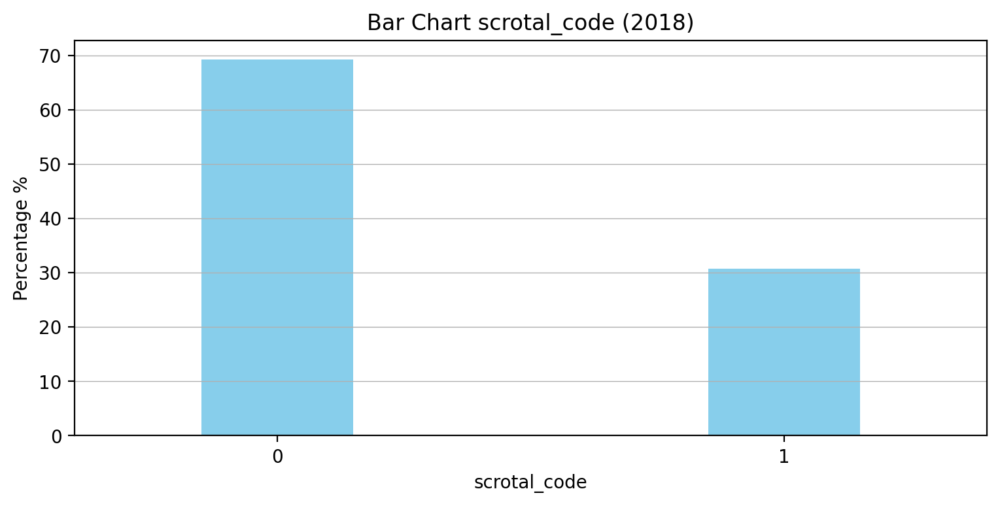





Column: lactating



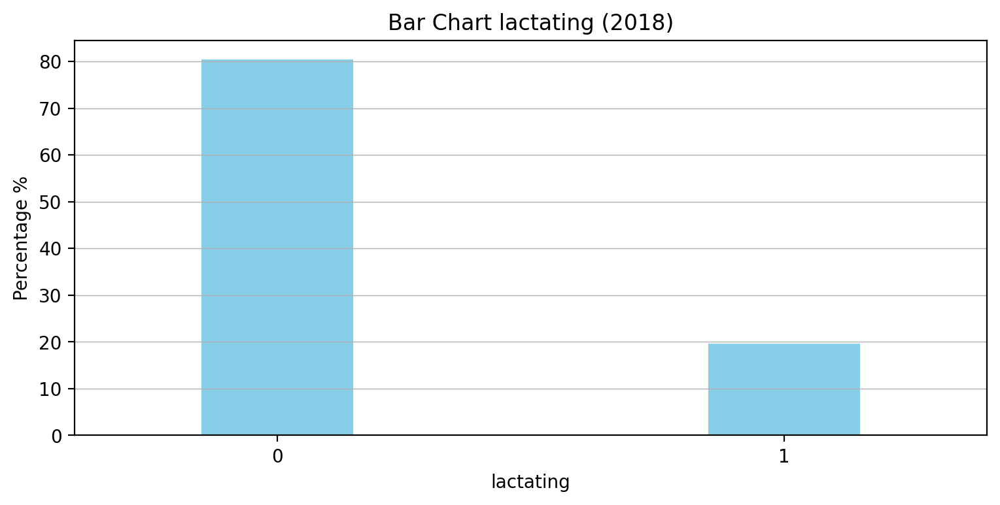





Column: perforate



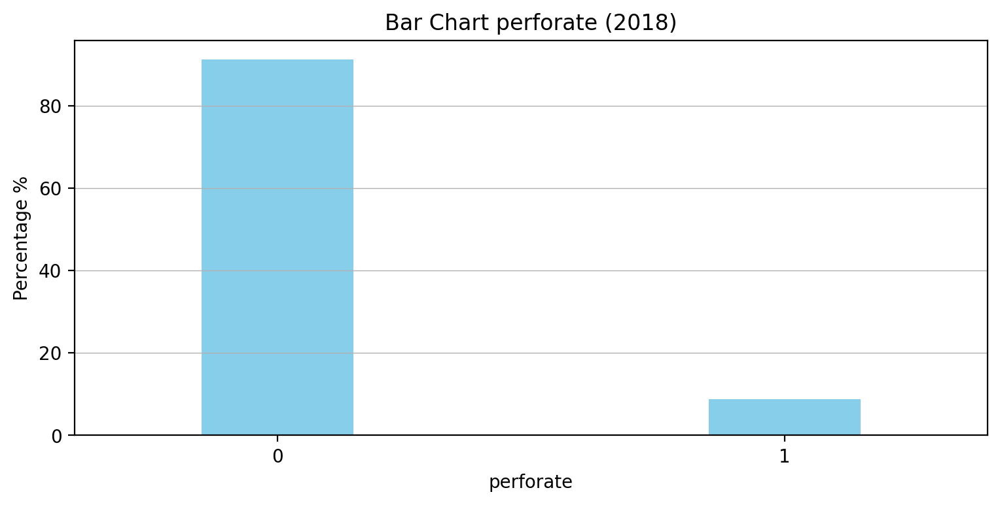





Column: pregnant



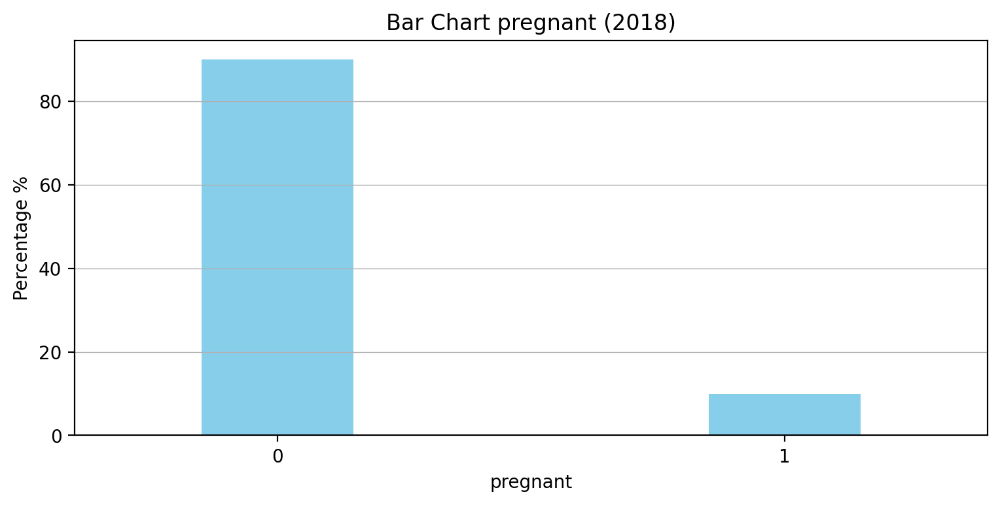







In [3145]:
for column in df_dichotomous_variables_2018.columns:
    print(f"Column: {column}")
    print('\b')
    df_dichotomous_variables_value_counts=df_dichotomous_variables_2018[column].value_counts(normalize=True) * 100
    plt.figure(figsize=(9,4),dpi=200)
    df_dichotomous_variables_value_counts.plot(kind='bar',color='skyblue', width=0.3)
    plt.xticks(rotation =0)
    plt.title(f'Bar Chart {column} (2018)')
    plt.xlabel(f'{column}')
    plt.ylabel('Percentage %')
    plt.grid(axis='y',linewidth=0.5)
    plt.show()
    print('\b')
    print('\b')
    print('\b')
    print('\b')

In [3146]:
len(nornice_2018)

260

### 2 Dataset for Prediciton (nornice 2014)

In [3147]:
nornice_2014=pd.read_excel('/Users/jangrzybek/Documents/NORNICE_2014.xlsx')
nornice_2014

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,5,1,12.2,7.8,4.4,12.05,0.0,0.0,4.0,1.0,0,0,0,0
1,2,5,1,10.8,6.9,4.2,10.25,24.1,0.0,4.3,1.0,0,0,0,0
2,3,5,1,19.2,8.7,3.9,15.25,26.1,0.0,5.6,0.0,0,1,0,0
3,4,5,1,17.5,9.1,3.8,14.35,26.0,0.0,6.2,0.0,0,0,1,1
4,5,5,1,18.9,9.5,4.9,13.80,26.0,0.0,6.4,0.0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,263,5,2,11.7,8.2,4.0,12.45,23.1,11.8,4.0,1.0,0,0,0,0
263,264,5,2,18.0,9.5,4.0,14.00,25.4,12.3,6.6,0.0,0,0,1,0
264,265,5,2,14.4,8.7,3.9,13.00,23.6,12.0,5.3,0.0,0,0,0,0
265,266,5,2,12.5,8.0,4.0,12.10,23.5,11.0,4.7,0.0,0,0,0,0


In [3148]:
nornice_2014.isnull().sum()

Ref no          0
Year            0
Site code       0
weight          0
nose_anus       0
anus_tail       0
avg_femur       0
skull_length    0
skull_width     0
eye_lens        0
sex             1
scrotal_code    0
lactating       0
perforate       0
pregnant        0
dtype: int64

In [3149]:
nornice_2014[nornice_2014['sex'].isnull()]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
53,54,5,1,12.3,7.8,4.7,0.0,25.3,11.3,5.0,NaN,0,0,0,0


In [3150]:
nornice_2014['sex'].fillna(0, inplace=True)

In [3151]:
nornice_2014['sex']=nornice_2014['sex'].astype(int)

In [3152]:
nornice_2014.dtypes

Ref no            int64
Year              int64
Site code         int64
weight          float64
nose_anus       float64
anus_tail       float64
avg_femur       float64
skull_length    float64
skull_width     float64
eye_lens        float64
sex               int64
scrotal_code     object
lactating         int64
perforate         int64
pregnant          int64
dtype: object

In [3153]:
nornice_2014['scrotal_code'].unique()

array([0, 1, '1`', 'o'], dtype=object)

In [3154]:
nornice_2014[(nornice_2014['scrotal_code'] == '1`') | (nornice_2014['scrotal_code'] == 'o')]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
45,46,5,1,15.8,9.1,4.2,13.50,25.9,11.8,6.1,1,1`,0,0,0
156,157,5,3,11.3,7.6,3.3,10.95,22.8,12.1,2.7,1,o,0,0,0


In [3155]:
nornice_2014['scrotal_code']=nornice_2014['scrotal_code'].replace({'1`':1,
                                                           'o': 0})

In [3156]:
nornice_2014.dtypes

Ref no            int64
Year              int64
Site code         int64
weight          float64
nose_anus       float64
anus_tail       float64
avg_femur       float64
skull_length    float64
skull_width     float64
eye_lens        float64
sex               int64
scrotal_code      int64
lactating         int64
perforate         int64
pregnant          int64
dtype: object

## Rescaling Values in Particular Columns, nornice 2014

In [3157]:
nornice_2018.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,6,1,11.9,8.0,4.6,1.8000,1.200,2.50,1.6,2.6,1,0,0,0,0
1,2,6,1,25.0,11.1,4.4,1.8375,1.595,2.94,1.3,5.8,0,0,1,0,0
2,3,6,1,15.7,9.1,4.4,1.7600,1.260,2.60,1.3,2.6,1,0,0,0,0
3,4,6,1,12.2,8.0,3.9,1.7500,1.075,2.50,1.1,3.0,0,0,0,0,0
4,5,6,1,17.6,9.3,4.8,1.8000,1.325,2.40,1.2,4.0,0,0,0,1,0


In [3158]:
nornice_2014.tail()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
262,263,5,2,11.7,8.2,4.0,12.45,23.1,11.8,4.0,1,0,0,0,0
263,264,5,2,18.0,9.5,4.0,14.00,25.4,12.3,6.6,0,0,0,1,0
264,265,5,2,14.4,8.7,3.9,13.00,23.6,12.0,5.3,0,0,0,0,0
265,266,5,2,12.5,8.0,4.0,12.10,23.5,11.0,4.7,0,0,0,0,0
266,267,5,2,11.3,8.0,3.8,11.45,23.4,10.8,4.6,1,0,0,0,0


### Avg femur rescaling

In [3159]:
nornice_2014['avg_femur']=nornice_2014['avg_femur'] * 0.1

In [3160]:
nornice_2014['avg_femur']

0      1.205
1      1.025
2      1.525
3      1.435
4      1.380
       ...  
262    1.245
263    1.400
264    1.300
265    1.210
266    1.145
Name: avg_femur, Length: 267, dtype: float64

### Skull length rescaling

In [3161]:
nornice_2014['skull_length']=nornice_2014['skull_length'] * 0.1

### Skull width rescaling

In [3162]:
nornice_2014['skull_width']=nornice_2014['skull_width'] * 0.1

In [3163]:
nornice_2018.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,6,1,11.9,8.0,4.6,1.8000,1.200,2.50,1.6,2.6,1,0,0,0,0
1,2,6,1,25.0,11.1,4.4,1.8375,1.595,2.94,1.3,5.8,0,0,1,0,0
2,3,6,1,15.7,9.1,4.4,1.7600,1.260,2.60,1.3,2.6,1,0,0,0,0
3,4,6,1,12.2,8.0,3.9,1.7500,1.075,2.50,1.1,3.0,0,0,0,0,0
4,5,6,1,17.6,9.3,4.8,1.8000,1.325,2.40,1.2,4.0,0,0,0,1,0


In [3164]:
nornice_2014.tail()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
262,263,5,2,11.7,8.2,4.0,1.245,2.31,1.18,4.0,1,0,0,0,0
263,264,5,2,18.0,9.5,4.0,1.400,2.54,1.23,6.6,0,0,0,1,0
264,265,5,2,14.4,8.7,3.9,1.300,2.36,1.20,5.3,0,0,0,0,0
265,266,5,2,12.5,8.0,4.0,1.210,2.35,1.10,4.7,0,0,0,0,0
266,267,5,2,11.3,8.0,3.8,1.145,2.34,1.08,4.6,1,0,0,0,0


### There are 35 '0' values for skull width, quite a lot

In [3165]:
len(nornice_2014[nornice_2014['skull_width'] == 0])

35

In [3166]:
correlations=df.corr()
correlations

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
ref,1.000000,0.958000,0.133821,-0.145355,0.096001,-0.388465,0.090487,-0.384010,0.033251,-0.029064,0.017197,0.011485,0.101037,-0.018392,0.016451,0.021413
year,0.958000,1.000000,0.158713,-0.139909,0.142442,-0.345819,0.112135,-0.309872,0.114434,-0.025534,-0.000049,0.008017,0.124210,0.015249,0.052256,0.042728
weight,0.133821,0.158713,1.000000,0.830665,0.632033,0.266217,0.841840,0.452473,0.496152,0.700104,-0.221802,0.144048,0.566694,0.191104,0.399334,0.759077
nose_anus,-0.145355,-0.139909,0.830665,1.000000,0.567773,0.379680,0.787297,0.529279,0.442704,0.720552,-0.140507,0.198464,0.466994,0.135503,0.243991,0.720669
anus_tail,0.096001,0.142442,0.632033,0.567773,1.000000,0.389625,0.679776,0.433206,0.507391,0.613625,-0.188833,0.066562,0.451377,0.164982,0.279692,0.586335
avg_foot,-0.388465,-0.345819,0.266217,0.379680,0.389625,1.000000,0.299079,0.424957,0.519983,0.364842,0.058628,0.177428,0.060309,-0.011563,0.004952,0.302097
avg_femur,0.090487,0.112135,0.841840,0.787297,0.679776,0.299079,1.000000,0.519132,0.472658,0.770071,-0.161949,0.196798,0.488066,0.184705,0.301227,0.764467
skull_length,-0.384010,-0.309872,0.452473,0.529279,0.433206,0.424957,0.519132,1.000000,0.277098,0.485006,-0.117016,0.127984,0.255684,0.161439,0.239007,0.483983
skull_width,0.033251,0.114434,0.496152,0.442704,0.507391,0.519983,0.472658,0.277098,1.000000,0.471973,-0.039422,0.135696,0.208159,-0.006268,0.122663,0.435906
eye_lens,-0.029064,-0.025534,0.700104,0.720552,0.613625,0.364842,0.770071,0.485006,0.471973,1.000000,-0.019267,0.324445,0.311582,0.092495,0.150293,0.780038


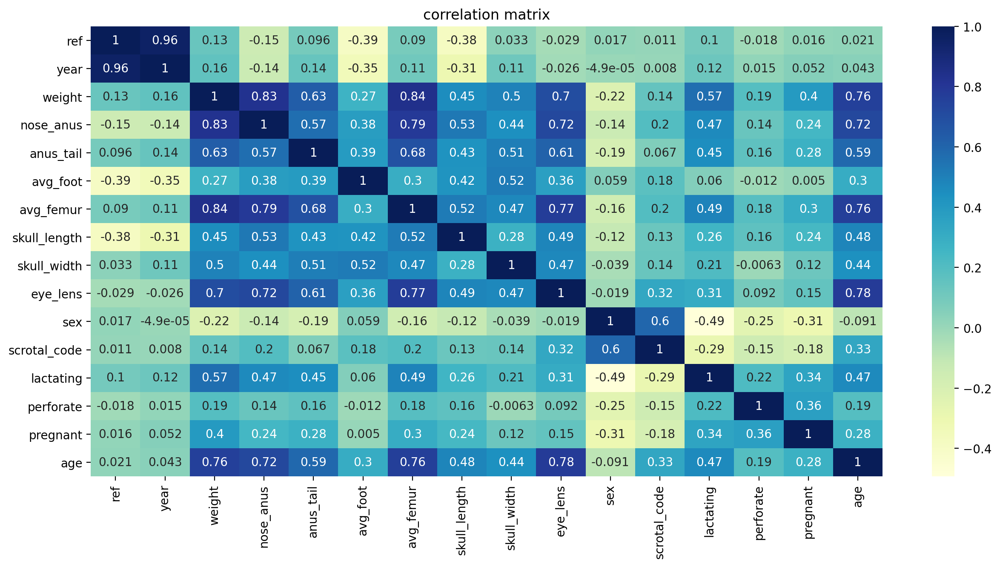

In [3167]:
plt.figure(figsize=(15,7), dpi=200)
sns.heatmap(correlations, cmap="YlGnBu", annot=True)
plt.title('correlation matrix')
plt.show()

### Prediction of skull_width for 2014 data using linear regression

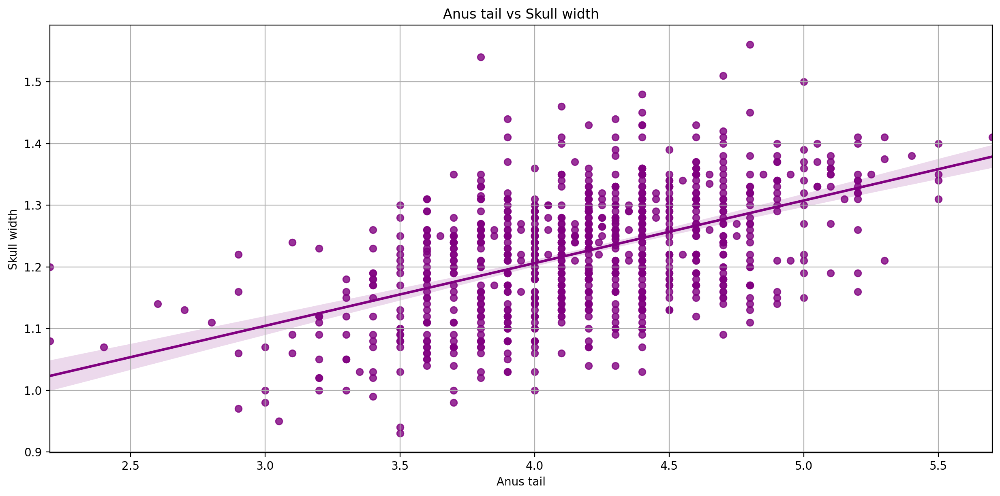

In [3168]:
plt.figure(figsize=(15, 7), dpi=200)
sns.regplot(x="anus_tail",  
            y="skull_width",  
            data=df,
            color='purple')
plt.title('Anus tail vs Skull width')
plt.xlabel('Anus tail')
plt.ylabel('Skull width')
plt.grid(True)


In [3169]:
X = df[['anus_tail']] 
y = df['skull_width'] 
model_skull_width_target = LinearRegression()
model_skull_width_target.fit(X,y)

LinearRegression()

In [3170]:
coefficients = model_skull_width_target.coef_
intercept = model_skull_width_target.intercept_
print(coefficients)
print(intercept)

[0.10154181]
0.7998356224254591


In [3171]:
skull_width_zero_values_2014=nornice_2014[nornice_2014['skull_width'] == 0]
skull_width_zero_values_2014


,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,5,1,12.2,7.8,4.4,1.205,0.00,0.0,4.0,1,0,0,0,0
1,2,5,1,10.8,6.9,4.2,1.025,2.41,0.0,4.3,1,0,0,0,0
2,3,5,1,19.2,8.7,3.9,1.525,2.61,0.0,5.6,0,0,1,0,0
3,4,5,1,17.5,9.1,3.8,1.435,2.60,0.0,6.2,0,0,0,1,1
4,5,5,1,18.9,9.5,4.9,1.380,2.60,0.0,6.4,0,0,1,1,0
5,6,5,1,13.9,7.8,4.1,1.315,2.62,0.0,4.7,0,0,0,0,0
6,7,5,1,15.0,8.8,3.6,1.295,2.55,0.0,6.3,1,0,0,0,0
7,8,5,1,13.3,9.0,4.1,1.200,2.63,0.0,4.8,1,0,0,0,0
8,9,5,1,12.5,8.7,4.5,1.290,2.69,0.0,4.9,0,0,0,1,0
9,10,5,1,28.6,11.1,5.7,1.640,2.76,0.0,7.4,0,0,1,0,0


In [3172]:
predictions_skull_width = model_skull_width_target.predict(skull_width_zero_values_2014[['anus_tail']])
predictions_skull_width=pd.Series(predictions_skull_width)
predictions_skull_width

0     1.246620
1     1.226311
2     1.195849
3     1.185695
4     1.297391
5     1.216157
6     1.165386
7     1.216157
8     1.256774
9     1.378624
10    1.185695
11    1.206003
12    1.155232
13    1.195849
14    1.134924
15    1.165386
16    1.226311
17    1.206003
18    1.216157
19    1.266928
20    1.185695
21    1.226311
22    1.256774
23    1.206003
24    1.195849
25    1.165386
26    1.246620
27    1.277082
28    1.236465
29    1.297391
30    1.236465
31    1.307545
32    1.195849
33    1.216157
34    1.256774
dtype: float64

In [3173]:
skull_width_zero_values_2014=skull_width_zero_values_2014.copy()


In [3174]:
skull_width_zero_values_2014.drop(columns=['skull_width'], inplace=True)
skull_width_zero_values_2014

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,5,1,12.2,7.8,4.4,1.205,0.00,4.0,1,0,0,0,0
1,2,5,1,10.8,6.9,4.2,1.025,2.41,4.3,1,0,0,0,0
2,3,5,1,19.2,8.7,3.9,1.525,2.61,5.6,0,0,1,0,0
3,4,5,1,17.5,9.1,3.8,1.435,2.60,6.2,0,0,0,1,1
4,5,5,1,18.9,9.5,4.9,1.380,2.60,6.4,0,0,1,1,0
5,6,5,1,13.9,7.8,4.1,1.315,2.62,4.7,0,0,0,0,0
6,7,5,1,15.0,8.8,3.6,1.295,2.55,6.3,1,0,0,0,0
7,8,5,1,13.3,9.0,4.1,1.200,2.63,4.8,1,0,0,0,0
8,9,5,1,12.5,8.7,4.5,1.290,2.69,4.9,0,0,0,1,0
9,10,5,1,28.6,11.1,5.7,1.640,2.76,7.4,0,0,1,0,0


In [3175]:
predicted_skull_width_values_2014=pd.concat([skull_width_zero_values_2014,predictions_skull_width],axis=1)

In [3176]:
predicted_skull_width_values_2014

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,0
0,1,5,1,12.2,7.8,4.4,1.205,0.00,4.0,1,0,0,0,0,1.246620
1,2,5,1,10.8,6.9,4.2,1.025,2.41,4.3,1,0,0,0,0,1.226311
2,3,5,1,19.2,8.7,3.9,1.525,2.61,5.6,0,0,1,0,0,1.195849
3,4,5,1,17.5,9.1,3.8,1.435,2.60,6.2,0,0,0,1,1,1.185695
4,5,5,1,18.9,9.5,4.9,1.380,2.60,6.4,0,0,1,1,0,1.297391
5,6,5,1,13.9,7.8,4.1,1.315,2.62,4.7,0,0,0,0,0,1.216157
6,7,5,1,15.0,8.8,3.6,1.295,2.55,6.3,1,0,0,0,0,1.165386
7,8,5,1,13.3,9.0,4.1,1.200,2.63,4.8,1,0,0,0,0,1.216157
8,9,5,1,12.5,8.7,4.5,1.290,2.69,4.9,0,0,0,1,0,1.256774
9,10,5,1,28.6,11.1,5.7,1.640,2.76,7.4,0,0,1,0,0,1.378624


In [3177]:
predicted_skull_width_values_2014.rename(columns={0:'skull_width'},inplace=True)

In [3178]:
predicted_skull_width_values_2014

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,skull_width
0,1,5,1,12.2,7.8,4.4,1.205,0.00,4.0,1,0,0,0,0,1.246620
1,2,5,1,10.8,6.9,4.2,1.025,2.41,4.3,1,0,0,0,0,1.226311
2,3,5,1,19.2,8.7,3.9,1.525,2.61,5.6,0,0,1,0,0,1.195849
3,4,5,1,17.5,9.1,3.8,1.435,2.60,6.2,0,0,0,1,1,1.185695
4,5,5,1,18.9,9.5,4.9,1.380,2.60,6.4,0,0,1,1,0,1.297391
5,6,5,1,13.9,7.8,4.1,1.315,2.62,4.7,0,0,0,0,0,1.216157
6,7,5,1,15.0,8.8,3.6,1.295,2.55,6.3,1,0,0,0,0,1.165386
7,8,5,1,13.3,9.0,4.1,1.200,2.63,4.8,1,0,0,0,0,1.216157
8,9,5,1,12.5,8.7,4.5,1.290,2.69,4.9,0,0,0,1,0,1.256774
9,10,5,1,28.6,11.1,5.7,1.640,2.76,7.4,0,0,1,0,0,1.378624


In [3179]:
predicted_skull_width_values_2014.columns = predicted_skull_width_values_2014.columns.str.strip()

In [3180]:
predicted_skull_width_values_2014.columns

Index(['Ref no', 'Year', 'Site code', 'weight', 'nose_anus', 'anus_tail',
       'avg_femur', 'skull_length', 'eye_lens', 'sex', 'scrotal_code',
       'lactating', 'perforate', 'pregnant', 'skull_width'],
      dtype='object')

In [3181]:
desired_order=['Ref no', 'Year', 'Site code', 'weight', 'nose_anus', 'anus_tail',
       'avg_femur', 'skull_length','skull_width', 'eye_lens', 'sex', 'scrotal_code',
       'lactating', 'perforate', 'pregnant']

predicted_skull_width_values_2014=predicted_skull_width_values_2014.reindex(columns=desired_order)

In [3182]:
predicted_skull_width_values_2014.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,5,1,12.2,7.8,4.4,1.205,0.00,1.246620,4.0,1,0,0,0,0
1,2,5,1,10.8,6.9,4.2,1.025,2.41,1.226311,4.3,1,0,0,0,0
2,3,5,1,19.2,8.7,3.9,1.525,2.61,1.195849,5.6,0,0,1,0,0
3,4,5,1,17.5,9.1,3.8,1.435,2.60,1.185695,6.2,0,0,0,1,1
4,5,5,1,18.9,9.5,4.9,1.380,2.60,1.297391,6.4,0,0,1,1,0


In [3183]:
len(predicted_skull_width_values_2014)

35

In [3184]:
nornice_2014=nornice_2014.copy()

In [3185]:
nornice_2014=nornice_2014[nornice_2014['skull_width'] != 0]

In [3186]:
nornice_2014

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
35,36,5,1,13.7,8.6,5.1,1.420,2.76,1.23,5.1,0,0,0,1,0
36,37,5,1,11.5,7.6,4.2,1.215,2.45,1.14,4.2,0,0,0,0,0
37,38,5,1,11.6,7.3,3.9,1.270,2.55,1.16,4.9,0,0,0,0,0
38,39,5,1,16.3,8.5,4.0,1.465,2.32,1.12,9.6,1,1,0,0,0
39,40,5,1,11.6,7.3,4.1,1.250,2.56,1.16,5.2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,263,5,2,11.7,8.2,4.0,1.245,2.31,1.18,4.0,1,0,0,0,0
263,264,5,2,18.0,9.5,4.0,1.400,2.54,1.23,6.6,0,0,0,1,0
264,265,5,2,14.4,8.7,3.9,1.300,2.36,1.20,5.3,0,0,0,0,0
265,266,5,2,12.5,8.0,4.0,1.210,2.35,1.10,4.7,0,0,0,0,0


In [3187]:
nornice_2014.columns = nornice_2014.columns.str.strip()
nornice_2014.columns

Index(['Ref no', 'Year', 'Site code', 'weight', 'nose_anus', 'anus_tail',
       'avg_femur', 'skull_length', 'skull_width', 'eye_lens', 'sex',
       'scrotal_code', 'lactating', 'perforate', 'pregnant'],
      dtype='object')

In [3188]:
nornice_2014_2=pd.concat([nornice_2014,predicted_skull_width_values_2014],axis=0,ignore_index=True)
nornice_2014_2

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,36,5,1,13.7,8.6,5.1,1.420,2.76,1.230000,5.1,0,0,0,1,0
1,37,5,1,11.5,7.6,4.2,1.215,2.45,1.140000,4.2,0,0,0,0,0
2,38,5,1,11.6,7.3,3.9,1.270,2.55,1.160000,4.9,0,0,0,0,0
3,39,5,1,16.3,8.5,4.0,1.465,2.32,1.120000,9.6,1,1,0,0,0
4,40,5,1,11.6,7.3,4.1,1.250,2.56,1.160000,5.2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,31,5,1,13.8,8.9,4.3,1.280,2.66,1.236465,4.2,0,0,0,0,0
263,32,5,1,21.2,9.9,5.0,1.370,2.62,1.307545,6.2,1,1,0,0,0
264,33,5,1,15.1,9.1,3.9,1.315,2.69,1.195849,6.4,1,0,0,0,0
265,34,5,1,13.3,8.0,4.1,1.315,2.54,1.216157,5.7,1,0,0,0,0


In [3189]:
nornice_2014=nornice_2014_2

In [3190]:
nornice_2014.isnull().sum()

Ref no          0
Year            0
Site code       0
weight          0
nose_anus       0
anus_tail       0
avg_femur       0
skull_length    0
skull_width     0
eye_lens        0
sex             0
scrotal_code    0
lactating       0
perforate       0
pregnant        0
dtype: int64

In [3191]:
nornice_2014[nornice_2014['avg_femur'] == 0]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
18,54,5,1,12.3,7.8,4.7,0.0,2.53,1.13,5.0,0,0,0,0,0
183,219,5,2,23.1,10.0,8.1,0.0,2.41,1.11,0.0,0,0,1,0,0
196,232,5,2,16.3,9.0,7.0,0.0,2.22,1.10,0.0,0,0,0,0,0
198,234,5,2,20.5,9.4,7.2,0.0,2.34,1.17,0.0,0,0,0,0,0


In [3192]:
nornice_2014['avg_femur'].replace({0:nornice_2014['avg_femur'].mean()},inplace=True)

In [3193]:
nornice_2014['skull_length'].replace({0:nornice_2014['skull_length'].mean()},inplace=True)

In [3194]:
nornice_2014['eye_lens'].replace({0:nornice_2014['eye_lens'].mean()},inplace=True)

## Prediction of avg foot for 2014 data using linear regression

In [3195]:
correlations=df.corr()
correlations

,ref,year,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,age
ref,1.000000,0.958000,0.133821,-0.145355,0.096001,-0.388465,0.090487,-0.384010,0.033251,-0.029064,0.017197,0.011485,0.101037,-0.018392,0.016451,0.021413
year,0.958000,1.000000,0.158713,-0.139909,0.142442,-0.345819,0.112135,-0.309872,0.114434,-0.025534,-0.000049,0.008017,0.124210,0.015249,0.052256,0.042728
weight,0.133821,0.158713,1.000000,0.830665,0.632033,0.266217,0.841840,0.452473,0.496152,0.700104,-0.221802,0.144048,0.566694,0.191104,0.399334,0.759077
nose_anus,-0.145355,-0.139909,0.830665,1.000000,0.567773,0.379680,0.787297,0.529279,0.442704,0.720552,-0.140507,0.198464,0.466994,0.135503,0.243991,0.720669
anus_tail,0.096001,0.142442,0.632033,0.567773,1.000000,0.389625,0.679776,0.433206,0.507391,0.613625,-0.188833,0.066562,0.451377,0.164982,0.279692,0.586335
avg_foot,-0.388465,-0.345819,0.266217,0.379680,0.389625,1.000000,0.299079,0.424957,0.519983,0.364842,0.058628,0.177428,0.060309,-0.011563,0.004952,0.302097
avg_femur,0.090487,0.112135,0.841840,0.787297,0.679776,0.299079,1.000000,0.519132,0.472658,0.770071,-0.161949,0.196798,0.488066,0.184705,0.301227,0.764467
skull_length,-0.384010,-0.309872,0.452473,0.529279,0.433206,0.424957,0.519132,1.000000,0.277098,0.485006,-0.117016,0.127984,0.255684,0.161439,0.239007,0.483983
skull_width,0.033251,0.114434,0.496152,0.442704,0.507391,0.519983,0.472658,0.277098,1.000000,0.471973,-0.039422,0.135696,0.208159,-0.006268,0.122663,0.435906
eye_lens,-0.029064,-0.025534,0.700104,0.720552,0.613625,0.364842,0.770071,0.485006,0.471973,1.000000,-0.019267,0.324445,0.311582,0.092495,0.150293,0.780038


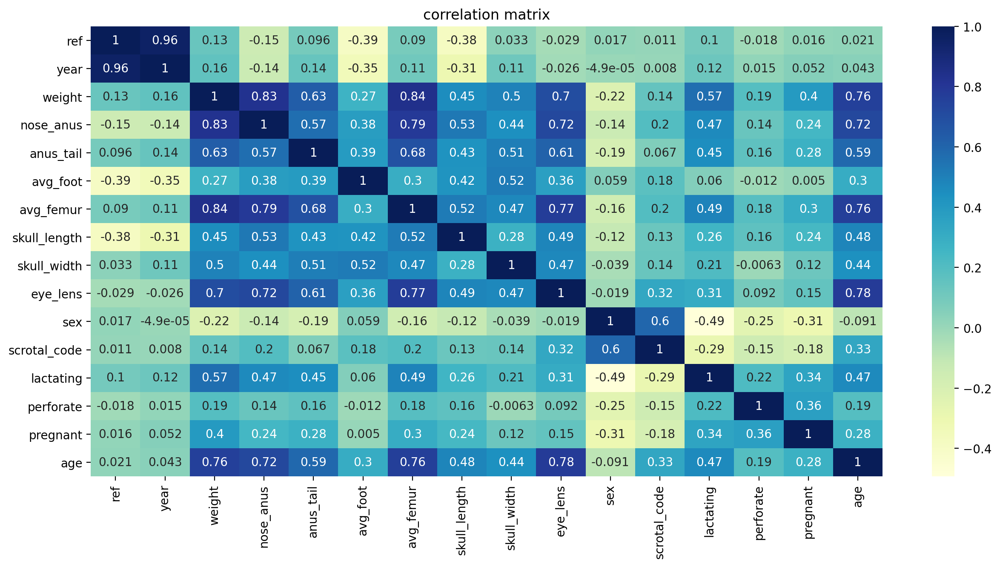

In [3196]:
plt.figure(figsize=(15,7), dpi=200)
sns.heatmap(correlations, cmap="YlGnBu", annot=True)
plt.title('correlation matrix')
plt.show()

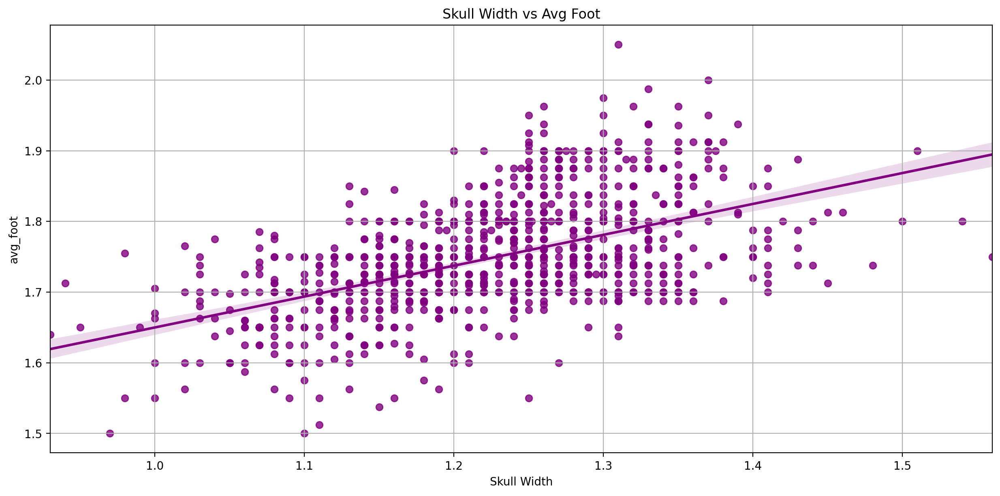

In [3197]:
plt.figure(figsize=(15, 7), dpi=200)
sns.regplot(x="skull_width",  
            y="avg_foot",  
            data=df,
            color='purple')
plt.title('Skull Width vs Avg Foot')
plt.xlabel('Skull Width')
plt.ylabel('avg_foot')
plt.grid(True)

In [3198]:
X = df[['skull_width']]
y = (df['avg_foot'])  
model_avg_foot_2014 = LinearRegression()
model_avg_foot_2014.fit(X,y)

LinearRegression()

In [3199]:
coefficients = model_avg_foot_2014.coef_
intercept = model_avg_foot_2014.intercept_
print(coefficients)
print(intercept)

[0.43698645]
1.2129657214612313


In [3200]:
predictions_avg_foot_2014 = model_avg_foot_2014.predict(nornice_2014[['skull_width']])
predictions_avg_foot_2014=pd.Series(predictions_avg_foot_2014)
predictions_avg_foot_2014

0      1.750459
1      1.711130
2      1.719870
3      1.702391
4      1.719870
         ...   
262    1.753284
263    1.784345
264    1.735535
265    1.744410
266    1.762159
Length: 267, dtype: float64

In [3201]:
predicted_avg_foot_2014=pd.concat([nornice_2014,predictions_avg_foot_2014],axis=1)

In [3202]:
predicted_avg_foot_2014

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,0
0,36,5,1,13.7,8.6,5.1,1.420,2.76,1.230000,5.1,0,0,0,1,0,1.750459
1,37,5,1,11.5,7.6,4.2,1.215,2.45,1.140000,4.2,0,0,0,0,0,1.711130
2,38,5,1,11.6,7.3,3.9,1.270,2.55,1.160000,4.9,0,0,0,0,0,1.719870
3,39,5,1,16.3,8.5,4.0,1.465,2.32,1.120000,9.6,1,1,0,0,0,1.702391
4,40,5,1,11.6,7.3,4.1,1.250,2.56,1.160000,5.2,0,0,0,0,0,1.719870
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262,31,5,1,13.8,8.9,4.3,1.280,2.66,1.236465,4.2,0,0,0,0,0,1.753284
263,32,5,1,21.2,9.9,5.0,1.370,2.62,1.307545,6.2,1,1,0,0,0,1.784345
264,33,5,1,15.1,9.1,3.9,1.315,2.69,1.195849,6.4,1,0,0,0,0,1.735535
265,34,5,1,13.3,8.0,4.1,1.315,2.54,1.216157,5.7,1,0,0,0,0,1.744410


In [3203]:
predicted_avg_foot_2014.rename(columns={0:'avg_foot'},inplace=True)

In [3204]:
predicted_avg_foot_2014.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,avg_foot
0,36,5,1,13.7,8.6,5.1,1.420,2.76,1.23,5.1,0,0,0,1,0,1.750459
1,37,5,1,11.5,7.6,4.2,1.215,2.45,1.14,4.2,0,0,0,0,0,1.711130
2,38,5,1,11.6,7.3,3.9,1.270,2.55,1.16,4.9,0,0,0,0,0,1.719870
3,39,5,1,16.3,8.5,4.0,1.465,2.32,1.12,9.6,1,1,0,0,0,1.702391
4,40,5,1,11.6,7.3,4.1,1.250,2.56,1.16,5.2,0,0,0,0,0,1.719870


In [3205]:
desired_order=['Ref no', 'Year', 'Site code', 'weight', 'nose_anus', 'anus_tail','avg_foot',
       'avg_femur', 'skull_length','skull_width', 'eye_lens', 'sex', 'scrotal_code',
       'lactating', 'perforate', 'pregnant']

predicted_avg_foot_2014=predicted_avg_foot_2014.reindex(columns=desired_order)

In [3206]:
predicted_avg_foot_2014.head()

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.76,1.23,5.1,0,0,0,1,0
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.45,1.14,4.2,0,0,0,0,0
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.55,1.16,4.9,0,0,0,0,0
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.32,1.12,9.6,1,1,0,0,0
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.56,1.16,5.2,0,0,0,0,0


In [3207]:
nornice_2014=predicted_avg_foot_2014

## Statisctics for continious variables nornice 2014

In [3208]:
df_contionious_variables_2014=nornice_2014.select_dtypes(include=['float64'])
df_contionious_variables_2014.describe()

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens
count,267.000000,267.000000,267.000000,267.000000,267.000000,267.000000,267.000000,267.000000
mean,15.470412,8.784644,4.246067,1.731015,1.308661,2.466920,1.185505,5.430416
std,3.709324,0.808431,0.545258,0.029233,0.108701,0.121475,0.066896,1.096449
min,7.700000,6.600000,3.300000,1.649952,0.670000,2.170000,1.000000,2.700000
25%,12.900000,8.200000,4.000000,1.711130,1.250000,2.380000,1.140000,4.700000
50%,14.400000,8.700000,4.200000,1.732980,1.300000,2.460000,1.190000,5.300000
75%,17.650000,9.300000,4.400000,1.750459,1.355000,2.550000,1.230000,6.100000
max,28.600000,11.100000,8.100000,1.815406,1.670000,2.840000,1.378624,9.600000


Column: weight



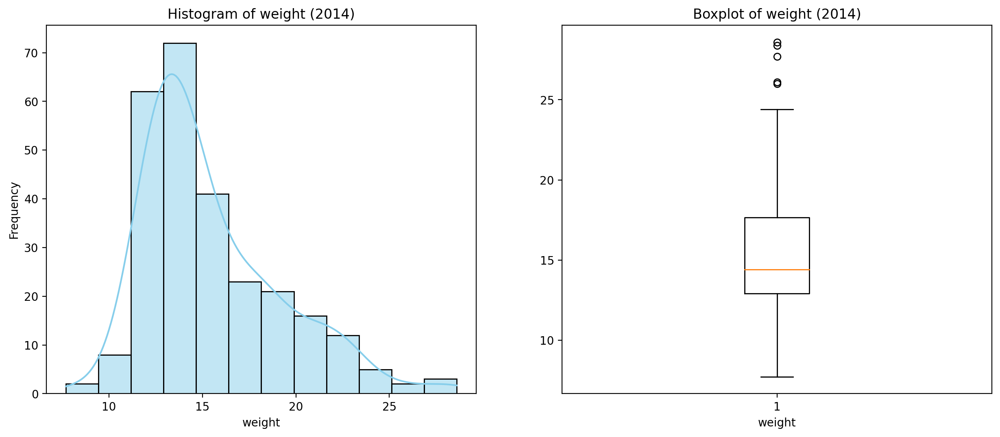





Column: nose_anus



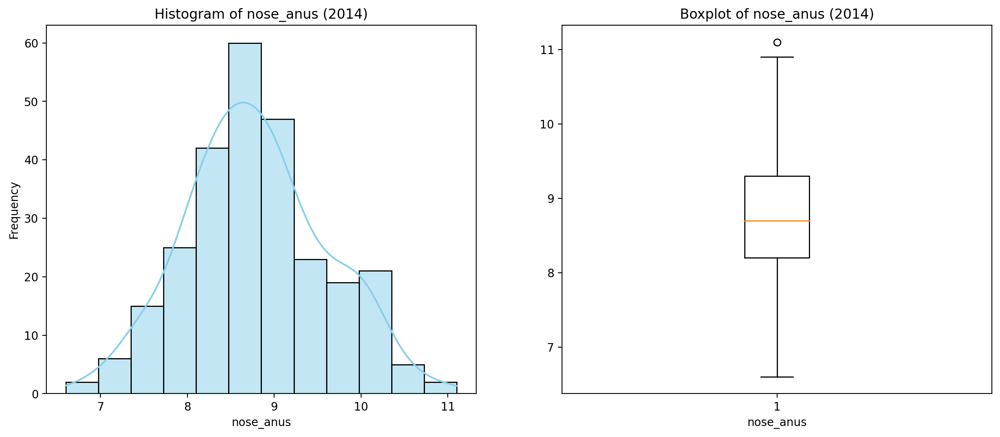





Column: anus_tail



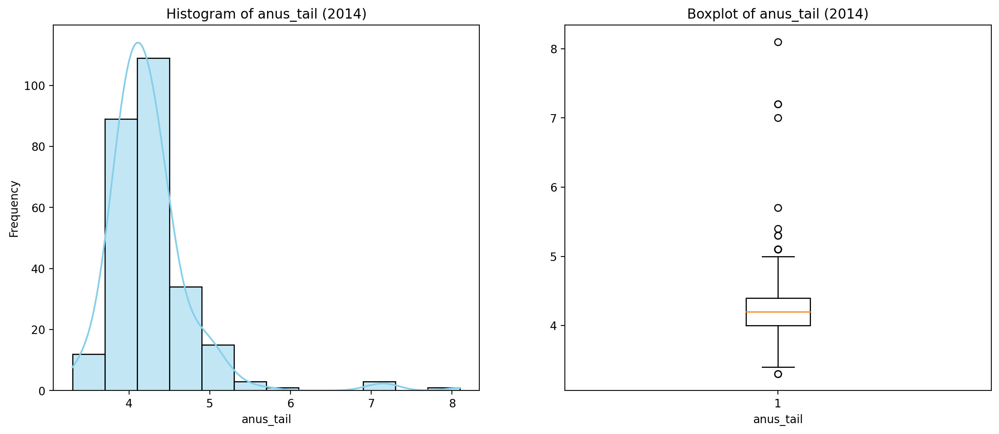





Column: avg_foot



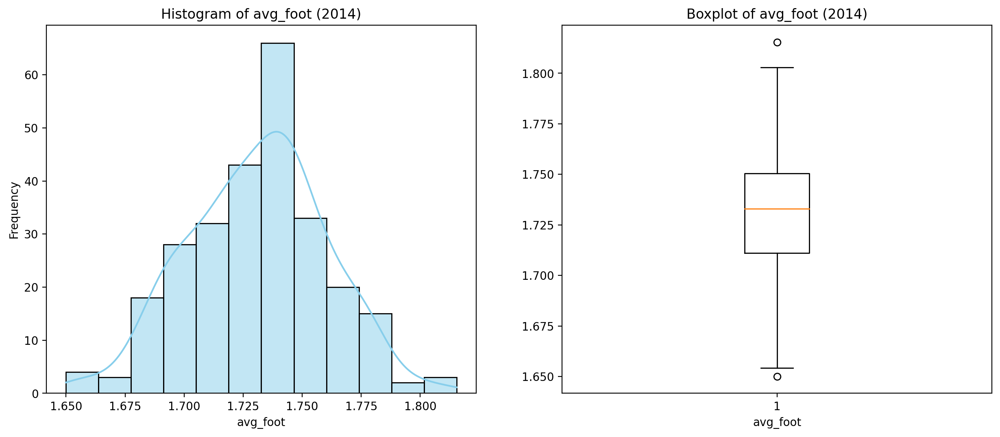





Column: avg_femur



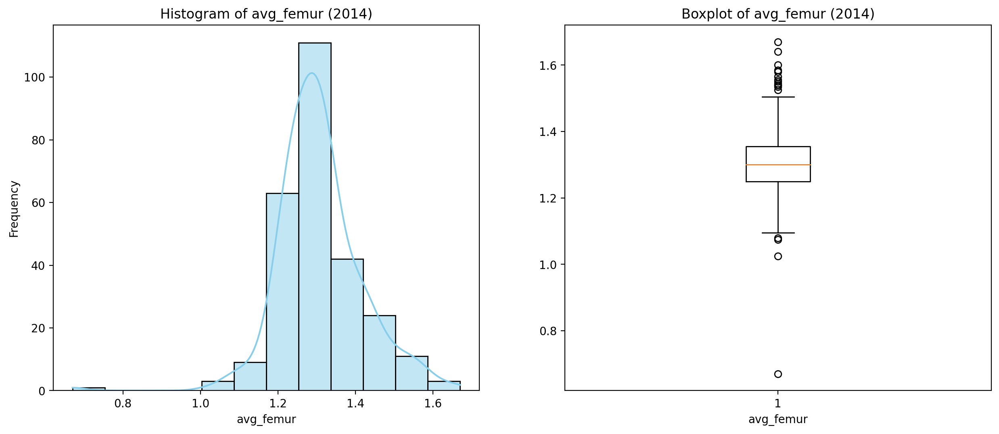





Column: skull_length



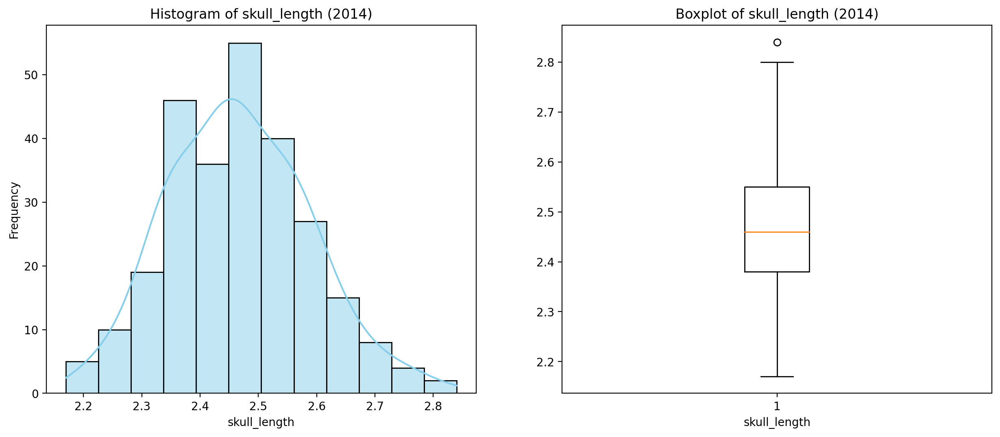





Column: skull_width



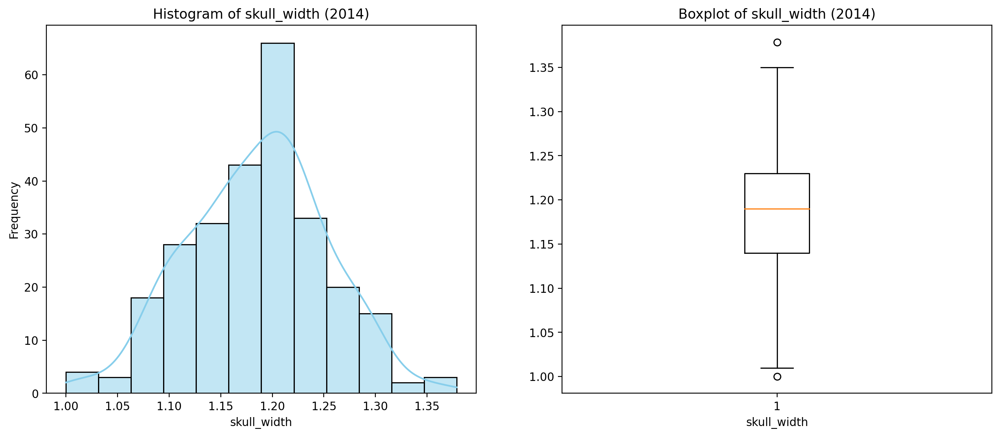





Column: eye_lens



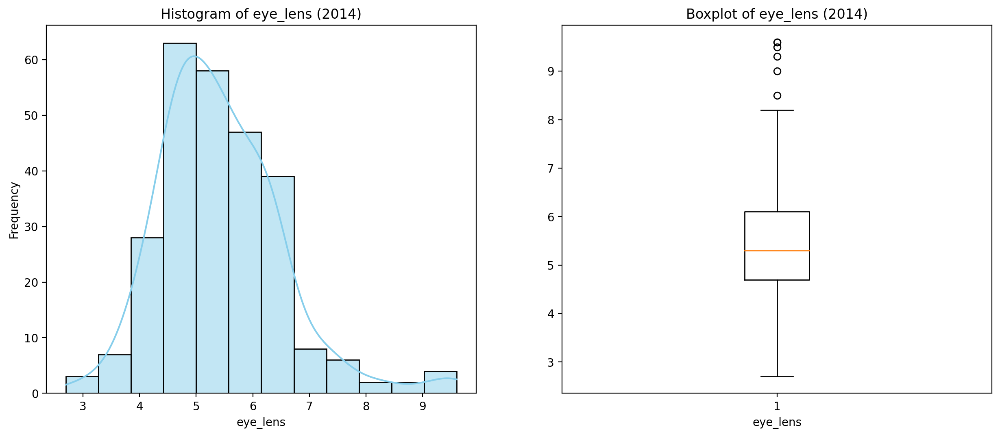







In [3209]:
for column in df_contionious_variables_2014.columns:
    print(f"Column: {column}")
    print('\b')
    plt.figure(figsize=(15,6), dpi=200)
    plt.subplot(1, 2, 1) 
    sns.histplot(data=df_contionious_variables_2014, x=column, bins=12, kde=True, color='skyblue')
    plt.title(f'Histogram of {column} (2014)')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.subplot(1, 2, 2)
    plt.boxplot(x=column, data=df_contionious_variables_2014)
    plt.title(f'Boxplot of {column} (2014)')
    plt.xlabel(column)
    plt.show()
    print('\b')
    print('\b')
    print('\b')
    print('\b')

## Statisctics for binary variables nornice 2014

In [3210]:
df_dichotomous_variables_2014=nornice_2014.select_dtypes(include=['int'])
df_dichotomous_variables_2014.drop(columns=['Ref no','Year','Site code'],inplace=True)
for column in df_dichotomous_variables_2014.columns:
    df_dichotomous_variables_2014[column]=df_dichotomous_variables_2014[column].astype(str)
df_dichotomous_variables_2014.describe()

,sex,scrotal_code,lactating,perforate,pregnant
count,267,267,267,267,267
unique,2,2,2,2,2
top,0,0,0,0,0
freq,134,193,235,242,257


Column: sex



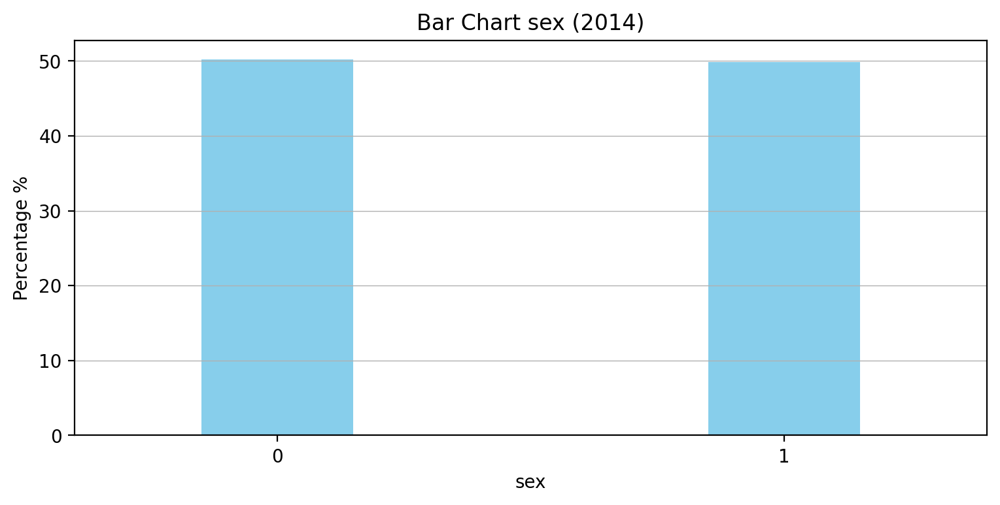





Column: scrotal_code



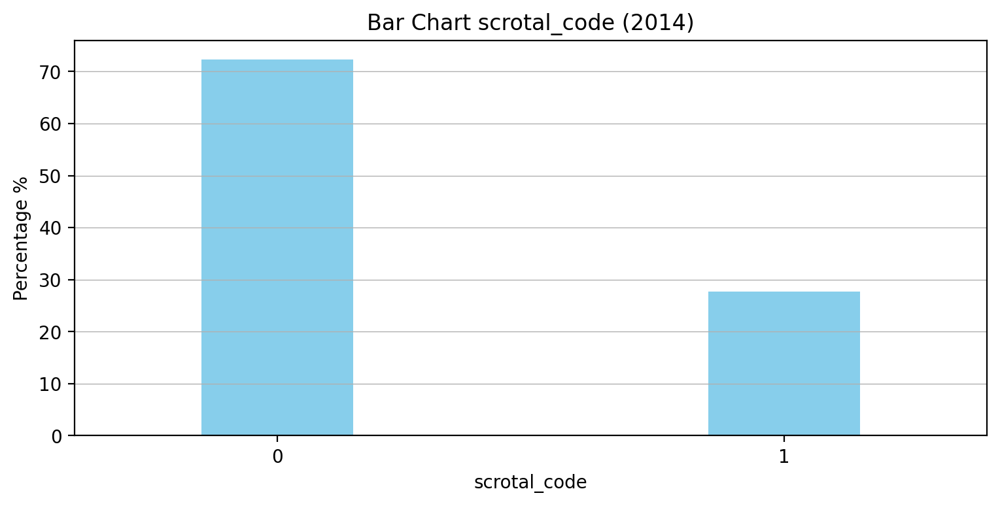





Column: lactating



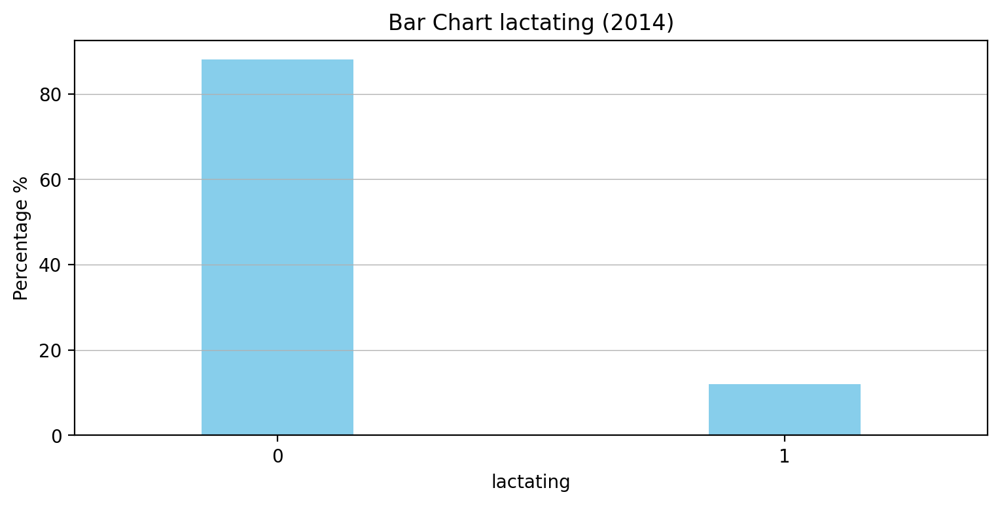





Column: perforate



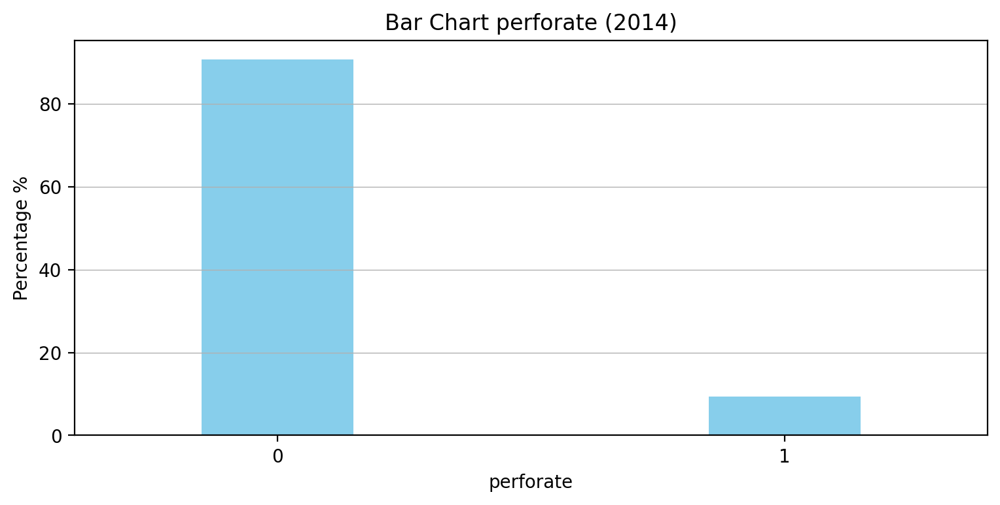





Column: pregnant



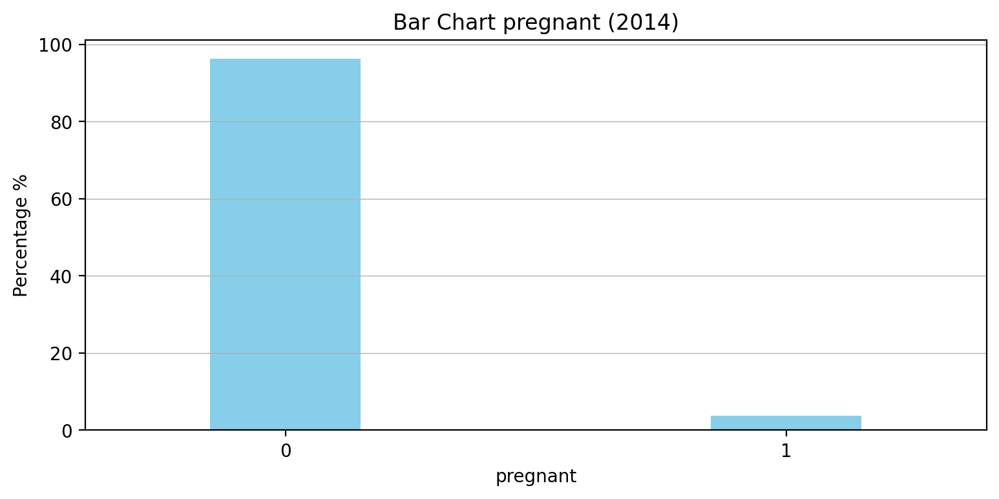







In [3211]:
for column in df_dichotomous_variables_2014.columns:
    print(f"Column: {column}")
    print('\b')
    df_dichotomous_variables_value_counts=df_dichotomous_variables_2014[column].value_counts(normalize=True) * 100
    plt.figure(figsize=(9,4),dpi=200)
    df_dichotomous_variables_value_counts.plot(kind='bar',color='skyblue', width=0.3)
    plt.xticks(rotation =0)
    plt.title(f'Bar Chart {column} (2014)')
    plt.xlabel(f'{column}')
    plt.ylabel('Percentage %')
    plt.grid(axis='y',linewidth=0.5)
    plt.show()
    print('\b')
    print('\b')
    print('\b')
    print('\b')

## Merginig 2014 and 2018 data

In [3212]:
len(nornice_2014)

267

In [3213]:
len(nornice_2018)

260

In [3214]:
nornice_2014.head(3)

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.76,1.23,5.1,0,0,0,1,0
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.45,1.14,4.2,0,0,0,0,0
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.55,1.16,4.9,0,0,0,0,0


In [3215]:
nornice_2018.head(3)

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,1,6,1,11.9,8.0,4.6,1.8000,1.200,2.50,1.6,2.6,1,0,0,0,0
1,2,6,1,25.0,11.1,4.4,1.8375,1.595,2.94,1.3,5.8,0,0,1,0,0
2,3,6,1,15.7,9.1,4.4,1.7600,1.260,2.60,1.3,2.6,1,0,0,0,0


In [3216]:
nornice_2014_2018=pd.concat([nornice_2014,nornice_2018],axis=0,ignore_index=True)
nornice_2014_2018

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,266,6,1,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1
523,267,6,1,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0
524,268,6,1,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0
525,269,6,1,14.7,9.3,4.0,1.800000,1.225,2.286,1.127,4.08,1,1,0,0,0


In [3217]:
nornice_2014_2018=nornice_2014_2018.reset_index(drop=True)
nornice_2014_2018

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,266,6,1,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1
523,267,6,1,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0
524,268,6,1,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0
525,269,6,1,14.7,9.3,4.0,1.800000,1.225,2.286,1.127,4.08,1,1,0,0,0


<a id="age-prediction"></a>
# Age prediction for 2014 and 2018 data using final model

In [3218]:
nornice_2014_2018_ready_to_model=nornice_2014_2018.drop(columns=['Ref no','Year','Site code'])

In [3219]:
nornice_2014_2018_ready_to_model

,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant
0,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0
1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0
2,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0
3,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0
4,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1
523,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0
524,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0
525,14.7,9.3,4.0,1.800000,1.225,2.286,1.127,4.08,1,1,0,0,0


In [3220]:
predictions=final_model.predict(nornice_2014_2018_ready_to_model)

In [3221]:
predictions

array([2, 1, 1, 2, 2, 3, 2, 2, 1, 2, 2, 1, 1, 2, 1, 2, 1, 2, 1, 3, 3, 2,
       3, 3, 2, 1, 2, 1, 3, 2, 3, 2, 2, 3, 3, 2, 3, 1, 2, 3, 2, 3, 1, 2,
       3, 2, 3, 1, 2, 3, 2, 1, 3, 1, 2, 2, 2, 2, 2, 1, 1, 3, 3, 2, 1, 2,
       2, 2, 1, 2, 2, 2, 1, 1, 1, 2, 1, 3, 2, 2, 2, 2, 1, 3, 2, 2, 3, 2,
       1, 2, 2, 1, 2, 3, 1, 1, 1, 1, 1, 3, 2, 1, 1, 1, 1, 3, 2, 1, 1, 1,
       1, 2, 1, 2, 2, 3, 2, 3, 2, 1, 1, 1, 2, 2, 3, 2, 1, 1, 1, 1, 1, 3,
       1, 2, 2, 2, 1, 2, 1, 2, 2, 1, 2, 3, 2, 2, 1, 2, 3, 1, 3, 2, 2, 2,
       3, 3, 1, 3, 2, 2, 3, 2, 3, 1, 3, 2, 3, 3, 2, 3, 3, 1, 1, 3, 3, 2,
       2, 2, 1, 2, 3, 3, 2, 2, 3, 2, 2, 1, 2, 3, 1, 2, 2, 2, 3, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 3, 2, 2, 2, 2, 3, 2, 3, 3, 3, 2,
       2, 1, 3, 2, 2, 2, 2, 1, 3, 2, 1, 1, 1, 1, 3, 3, 3, 1, 2, 1, 2, 3,
       2, 1, 2, 2, 2, 2, 2, 2, 2, 3, 3, 2, 2, 1, 2, 1, 1, 1, 2, 1, 1, 3,
       2, 2, 1, 1, 2, 2, 1, 2, 2, 1, 3, 1, 3, 2, 2, 3, 2, 1, 3, 3, 3, 2,
       2, 3, 2, 1, 2, 2, 2, 2, 2, 1, 2, 3, 2, 2, 3,

In [3222]:
len(predictions)

527

In [3223]:
predictions=pd.Series(predictions)
predictions

0      2
1      1
2      1
3      2
4      2
      ..
522    3
523    3
524    1
525    2
526    2
Length: 527, dtype: int64

In [3224]:
precicted_age_values_for_nornice_2014_2018=pd.concat([nornice_2014_2018,predictions],axis=1)
precicted_age_values_for_nornice_2014_2018

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,0
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0,2
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0,1
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0,1
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0,2
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,266,6,1,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1,3
523,267,6,1,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0,3
524,268,6,1,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0,1
525,269,6,1,14.7,9.3,4.0,1.800000,1.225,2.286,1.127,4.08,1,1,0,0,0,2


In [3225]:
precicted_age_values_for_nornice_2014_2018.columns

Index([      'Ref no',         'Year',    'Site code',       'weight',
          'nose_anus',    'anus_tail',     'avg_foot',    'avg_femur',
       'skull_length',  'skull_width',     'eye_lens',          'sex',
       'scrotal_code',    'lactating',    'perforate',     'pregnant',
                    0],
      dtype='object')

In [3226]:
precicted_age_values_for_nornice_2014_2018.rename(columns={0:'predicted_age'},inplace=True)

In [3227]:
precicted_age_values_for_nornice_2014_2018

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0,2
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0,1
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0,1
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0,2
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,266,6,1,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1,3
523,267,6,1,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0,3
524,268,6,1,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0,1
525,269,6,1,14.7,9.3,4.0,1.800000,1.225,2.286,1.127,4.08,1,1,0,0,0,2


## Additional Conditions

### Females, preganant, age=1

In [3228]:
precicted_age_values_for_nornice_2014_2018[(precicted_age_values_for_nornice_2014_2018['sex'] ==0) &
                                      (precicted_age_values_for_nornice_2014_2018['pregnant'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['predicted_age']==1)]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age
128,164,5,3,16.6,8.2,4.0,1.741719,1.295,2.27,1.21,4.4,0,0,0,1,1,1


In [3229]:
precicted_age_values_for_nornice_2014_2018.loc[(precicted_age_values_for_nornice_2014_2018['sex'] ==0) &
                                          (precicted_age_values_for_nornice_2014_2018['pregnant'] == 1) &
                                          (precicted_age_values_for_nornice_2014_2018['predicted_age'] == 1),'predicted_age'] = 2

### Females, lactating, age=1

In [3230]:
precicted_age_values_for_nornice_2014_2018[(precicted_age_values_for_nornice_2014_2018['sex'] ==0) &
                                      (precicted_age_values_for_nornice_2014_2018['lactating'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['predicted_age']==1)]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age


In [3231]:
precicted_age_values_for_nornice_2014_2018.loc[(precicted_age_values_for_nornice_2014_2018['sex'] ==0) &
                                          (precicted_age_values_for_nornice_2014_2018['lactating'] == 1) &
                                          (precicted_age_values_for_nornice_2014_2018['predicted_age'] == 1),'predicted_age'] = 2

### Females, perforate , age=1

In [3232]:
precicted_age_values_for_nornice_2014_2018[(precicted_age_values_for_nornice_2014_2018['sex'] ==0) &
                                      (precicted_age_values_for_nornice_2014_2018['perforate'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['predicted_age']==1)]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age
406,142,6,2,15.5,9.0,4.0,1.8,1.225,2.541,1.152,3.4,0,0,0,1,0,1


In [3233]:
precicted_age_values_for_nornice_2014_2018.loc[(precicted_age_values_for_nornice_2014_2018['sex'] ==0) &
                                          (precicted_age_values_for_nornice_2014_2018['perforate'] == 1) &
                                          (precicted_age_values_for_nornice_2014_2018['predicted_age'] == 1),'predicted_age'] = 2

### Males, scrotal_code=1 , age=1

In [3234]:
precicted_age_values_for_nornice_2014_2018[(precicted_age_values_for_nornice_2014_2018['sex'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['scrotal_code'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['predicted_age']==1)]

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age


In [3235]:
precicted_age_values_for_nornice_2014_2018.loc[(precicted_age_values_for_nornice_2014_2018['sex'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['scrotal_code'] ==1) &
                                      (precicted_age_values_for_nornice_2014_2018['predicted_age']==1),'predicted_age'] = 2

<a id="grouped-predicted"></a>
# Grouped statistics by age for predicted data

In [3236]:
precicted_age_values_for_nornice_2014_2018

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0,2
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0,1
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0,1
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0,2
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
522,266,6,1,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1,3
523,267,6,1,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0,3
524,268,6,1,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0,1
525,269,6,1,14.7,9.3,4.0,1.800000,1.225,2.286,1.127,4.08,1,1,0,0,0,2


In [3237]:
pivot_table_preds = precicted_age_values_for_nornice_2014_2018.pivot_table(index='predicted_age',
                                     values=['weight',
                                             'nose_anus',
                                             'anus_tail',
                                             'avg_foot',
                                             'avg_femur',
                                             'skull_length',
                                             'skull_width',
                                             'eye_lens',
                                             'scrotal_code',
                                             'lactating',
                                             'perforate',
                                             'pregnant'],
                                     aggfunc={'weight': 'mean',
                                              'nose_anus': 'mean',
                                              'anus_tail':'mean',
                                              'avg_foot':'mean',
                                              'avg_femur':'mean',
                                              'skull_length':'mean',
                                              'skull_width':'mean',
                                              'eye_lens':'mean',
                                              'scrotal_code':'mean',
                                              'lactating':'mean',
                                              'perforate':'mean',
                                              'pregnant':'mean'
                                             })
pivot_table_preds 

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
predicted_age,,,,,,,,,,,,
1,3.987195,1.177953,1.734846,4.249683,0.000000,8.332317,0.000000,0.000000,0.000000,2.392712,1.156049,12.398171
2,4.304745,1.289951,1.748592,5.378576,0.138211,9.188618,0.093496,0.069106,0.443089,2.485114,1.190643,16.228455
3,4.613395,1.427906,1.762587,6.570259,0.418803,10.006838,0.213675,0.162393,0.384615,2.566744,1.226528,20.977778


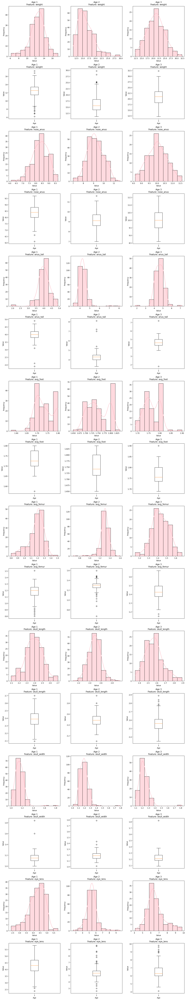

In [3238]:
features = precicted_age_values_for_nornice_2014_2018.columns[3:11]


custom_age_order = [1,2,3]  


num_rows = len(features) * 2
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=200)


for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = precicted_age_values_for_nornice_2014_2018[ precicted_age_values_for_nornice_2014_2018['predicted_age'] == age]
        
        
        ax_hist = axes[i * 2, j]
        sns.histplot(data=age_data, x=feature, bins=10, kde=True, ax=ax_hist, color='lightpink')
        ax_hist.set_title(f'Age {age}\nFeature: {feature}')
        ax_hist.set_xlabel('Value')
        ax_hist.set_ylabel('Frequency')
        
        
        ax_box = axes[i * 2 + 1, j]
        age_feature_data = age_data[feature]
        ax_box.boxplot(age_feature_data)
        ax_box.set_title(f'Age {age}\nFeature: {feature}')
        ax_box.set_xlabel('Age')
        ax_box.set_ylabel('Value')
        
plt.tight_layout()
plt.show()
    
   

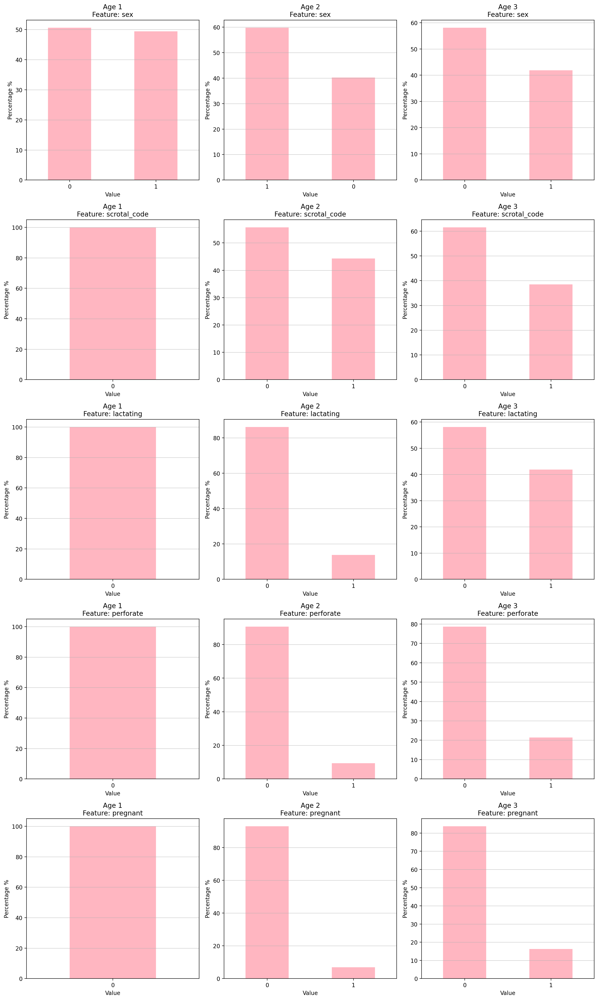

In [3239]:
features = precicted_age_values_for_nornice_2014_2018.columns[11:16]


custom_age_order = [1, 2, 3]  


num_rows = len(features)
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), dpi=200, facecolor='white')


for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = precicted_age_values_for_nornice_2014_2018[precicted_age_values_for_nornice_2014_2018['predicted_age'] == age]
        age_feature_data = age_data[feature]
        
        
        value_counts_percent = age_feature_data.value_counts(normalize=True) * 100
        
        
        ax_bar = axes[i, j]
        value_counts_percent.plot(kind='bar', ax=ax_bar, color='lightpink')
        ax_bar.set_title(f'Age {age}\nFeature: {feature}')
        ax_bar.set_xlabel('Value')
        ax_bar.set_ylabel('Percentage %')
        
        
        ax_bar.grid(axis='y', linewidth=0.5)
        
        
        ax_bar.set_xticklabels(ax_bar.get_xticklabels(), rotation=0)
        
plt.tight_layout()
plt.show()

## Grouped Statistics by age for predicted data (males only)

In [3240]:
males_preds=precicted_age_values_for_nornice_2014_2018[precicted_age_values_for_nornice_2014_2018['sex'] ==1]
males_preds

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age
3,39,5,1,16.3,8.5,4.0,1.702391,1.465,2.320,1.120,9.60,1,1,0,0,0,2
6,42,5,1,17.1,9.1,4.3,1.698021,1.345,2.800,1.110,6.20,1,1,0,0,0,2
9,45,5,1,13.3,8.0,4.1,1.702391,1.260,2.600,1.120,5.10,1,0,0,0,0,2
10,46,5,1,15.8,9.1,4.2,1.728610,1.350,2.590,1.180,6.10,1,1,0,0,0,2
13,49,5,1,12.8,8.7,3.8,1.706760,1.295,2.490,1.130,6.10,1,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
519,263,6,1,15.0,9.0,4.3,1.800000,1.200,2.308,1.132,6.03,1,1,0,0,0,2
520,264,6,1,15.5,8.8,3.5,1.750000,1.175,2.350,1.177,4.43,1,0,0,0,0,1
523,267,6,1,17.0,9.8,4.8,1.800000,1.350,2.503,1.182,6.32,1,0,0,0,0,3
524,268,6,1,11.7,8.3,4.2,1.800000,1.125,2.272,1.036,3.55,1,0,0,0,0,1


In [3241]:
pivot_table_by_age_males_preds = males_preds.pivot_table(index='predicted_age',
                                     values=['weight',
                                             'nose_anus',
                                             'anus_tail',
                                             'avg_foot',
                                             'avg_femur',
                                             'skull_length',
                                             'skull_width',
                                             'eye_lens',
                                             'scrotal_code',
                                             'lactating',
                                             'perforate',
                                             'pregnant'],
                                     aggfunc={'weight': 'mean',
                                              'nose_anus': 'mean',
                                              'anus_tail':'mean',
                                              'avg_foot':'mean',
                                              'avg_femur':'mean',
                                              'skull_length':'mean',
                                              'skull_width':'mean',
                                              'eye_lens':'mean',
                                              'scrotal_code':'mean',
                                              'lactating':'mean',
                                              'perforate':'mean',
                                              'pregnant':'mean'
                                             })
pivot_table_by_age_males_preds

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
predicted_age,,,,,,,,,,,,
1,3.925926,1.166358,1.737373,4.202938,0,8.403704,0,0,0.000000,2.386243,1.160409,12.249383
2,4.214743,1.285646,1.749179,5.393197,0,9.129932,0,0,0.741497,2.477932,1.189280,15.583673
3,4.463265,1.398571,1.759219,6.793878,0,9.855102,0,0,0.918367,2.538673,1.233255,18.991837


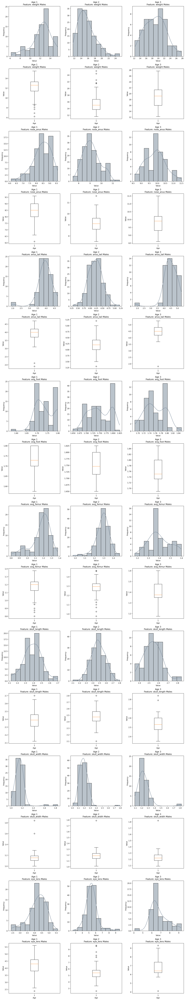

In [3242]:
features = males_preds.columns[3:11]


custom_age_order = [1,2,3]  


num_rows = len(features) * 2
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=200)


for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = males_preds[males_preds['predicted_age'] == age]
        
        
        ax_hist = axes[i * 2, j]
        sns.histplot(data=age_data, x=feature, bins=10, kde=True, ax=ax_hist, color='lightslategrey')
        ax_hist.set_title(f'Age {age}\nFeature: {feature} Males')
        ax_hist.set_xlabel('Value')
        ax_hist.set_ylabel('Frequency')
        
        
        ax_box = axes[i * 2 + 1, j]
        age_feature_data = age_data[feature]
        ax_box.boxplot(age_feature_data)
        ax_box.set_title(f'Age {age}\nFeature: {feature} Males')
        ax_box.set_xlabel('Age')
        ax_box.set_ylabel('Value')
        
plt.tight_layout()
plt.show()

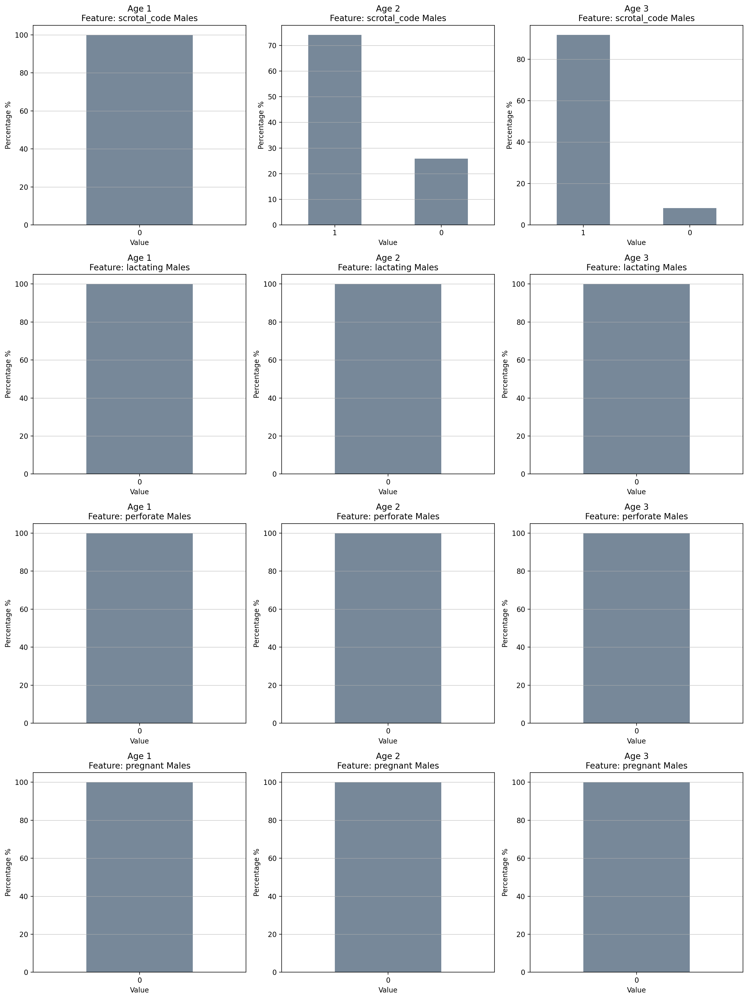

In [3243]:
features = males_preds.columns[12:16]


custom_age_order = [1, 2, 3]  


num_rows = len(features)
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), dpi=200, facecolor='white')


for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = males_preds[males_preds['predicted_age'] == age]
        age_feature_data = age_data[feature]
        
        
        value_counts_percent = age_feature_data.value_counts(normalize=True) * 100
        
        
        ax_bar = axes[i, j]
        value_counts_percent.plot(kind='bar', ax=ax_bar, color='lightslategrey')
        ax_bar.set_title(f'Age {age}\nFeature: {feature} Males')
        ax_bar.set_xlabel('Value')
        ax_bar.set_ylabel('Percentage %')
        
        
        ax_bar.grid(axis='y', linewidth=0.5)
        
        
        ax_bar.set_xticklabels(ax_bar.get_xticklabels(), rotation=0)
        
plt.tight_layout()
plt.show()

## Grouped Statistics by age for predicted data (females only)

In [3244]:
females_preds=precicted_age_values_for_nornice_2014_2018[precicted_age_values_for_nornice_2014_2018['sex'] ==0]
females_preds

,Ref no,Year,Site code,weight,nose_anus,anus_tail,avg_foot,avg_femur,skull_length,skull_width,eye_lens,sex,scrotal_code,lactating,perforate,pregnant,predicted_age
0,36,5,1,13.7,8.6,5.1,1.750459,1.420,2.760,1.230,5.10,0,0,0,1,0,2
1,37,5,1,11.5,7.6,4.2,1.711130,1.215,2.450,1.140,4.20,0,0,0,0,0,1
2,38,5,1,11.6,7.3,3.9,1.719870,1.270,2.550,1.160,4.90,0,0,0,0,0,1
4,40,5,1,11.6,7.3,4.1,1.719870,1.250,2.560,1.160,5.20,0,0,0,0,0,2
5,41,5,1,24.3,10.7,4.8,1.754829,1.500,2.720,1.240,7.20,0,0,1,0,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
512,256,6,1,24.5,10.7,5.0,1.700000,1.525,2.484,1.252,8.20,0,0,1,0,0,3
513,257,6,1,16.4,9.5,4.4,1.800000,1.375,2.500,1.110,5.20,0,0,0,0,1,2
521,265,6,1,25.6,10.5,4.8,1.800000,1.400,2.570,1.182,6.16,0,0,1,0,0,3
522,266,6,1,26.3,11.6,5.1,1.800000,1.350,2.632,1.210,6.71,0,0,1,0,1,3


In [3245]:
pivot_table_by_age_females_preds = females_preds.pivot_table(index='predicted_age',
                                     values=['weight',
                                             'nose_anus',
                                             'anus_tail',
                                             'avg_foot',
                                             'avg_femur',
                                             'skull_length',
                                             'skull_width',
                                             'eye_lens',
                                             'scrotal_code',
                                             'lactating',
                                             'perforate',
                                             'pregnant'],
                                     aggfunc={'weight': 'mean',
                                              'nose_anus': 'mean',
                                              'anus_tail':'mean',
                                              'avg_foot':'mean',
                                              'avg_femur':'mean',
                                              'skull_length':'mean',
                                              'skull_width':'mean',
                                              'eye_lens':'mean',
                                              'scrotal_code':'mean',
                                              'lactating':'mean',
                                              'perforate':'mean',
                                              'pregnant':'mean'
                                             })
pivot_table_by_age_females_preds

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
predicted_age,,,,,,,,,,,,
1,4.046988,1.189269,1.732380,4.295301,0.000000,8.262651,0.000000,0.000000,0,2.399024,1.151794,12.543373
2,4.438384,1.296344,1.747720,5.356867,0.343434,9.275758,0.232323,0.171717,0,2.495778,1.192667,17.185859
3,4.721576,1.449044,1.765014,6.409122,0.720588,10.116176,0.367647,0.279412,0,2.586971,1.221680,22.408824


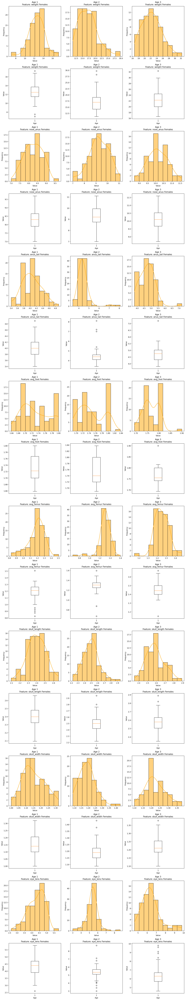

In [3246]:
features = females_preds.columns[3:11]


custom_age_order = [1,2,3] 

# Set up subplots
num_rows = len(features) * 2
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows),dpi=200)


for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = females_preds[females_preds['predicted_age'] == age]
        
        
        ax_hist = axes[i * 2, j]
        sns.histplot(data=age_data, x=feature, bins=10, kde=True, ax=ax_hist, color='orange')
        ax_hist.set_title(f'Age {age}\nFeature: {feature} Females')
        ax_hist.set_xlabel('Value')
        ax_hist.set_ylabel('Frequency')
        
        
        ax_box = axes[i * 2 + 1, j]
        age_feature_data = age_data[feature]
        ax_box.boxplot(age_feature_data)
        ax_box.set_title(f'Age {age}\nFeature: {feature} Females')
        ax_box.set_xlabel('Age')
        ax_box.set_ylabel('Value')
        
plt.tight_layout()
plt.show()

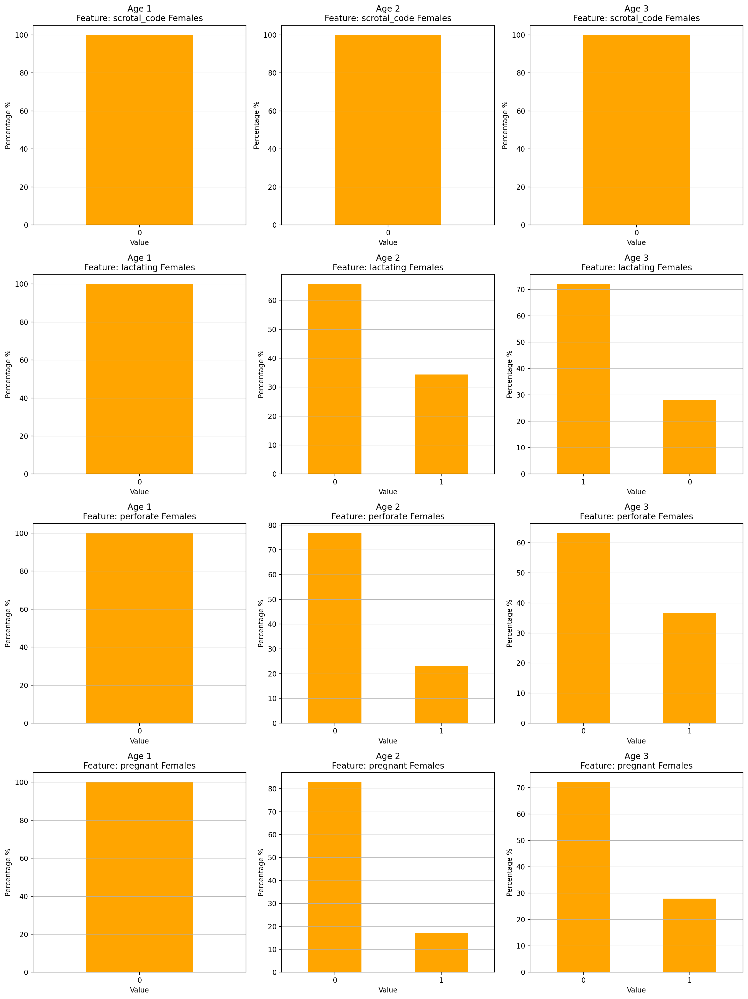

In [3247]:
features = females_preds.columns[12:16]


custom_age_order = [1, 2, 3]  


num_rows = len(features)
num_cols = len(custom_age_order)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows), dpi=200, facecolor='white')


for i, feature in enumerate(features):
    for j, age in enumerate(custom_age_order):
        age_data = females_preds[females_preds['predicted_age'] == age]
        age_feature_data = age_data[feature]
        
        
        value_counts_percent = age_feature_data.value_counts(normalize=True) * 100
        
        
        ax_bar = axes[i, j]
        value_counts_percent.plot(kind='bar', ax=ax_bar, color='orange')
        ax_bar.set_title(f'Age {age}\nFeature: {feature} Females')
        ax_bar.set_xlabel('Value')
        ax_bar.set_ylabel('Percentage %')
        
        
        ax_bar.grid(axis='y', linewidth=0.5)
        
        
        ax_bar.set_xticklabels(ax_bar.get_xticklabels(), rotation=0)
        
plt.tight_layout()
plt.show()

<a id="pivots-comparision"></a>
# Comparision of age pivots (data for model building vs predicted data)

### Data for model building 

In [3248]:
pivot_table_by_age

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,sex,skull_length,skull_width,weight
age,,,,,,,,,,,,,
1,3.821923,1.213191,1.706644,4.042308,0.000000,8.129270,0.000000,0.000000,0.000000,0.503846,2.580096,1.164865,12.475000
2,4.148093,1.331039,1.760137,5.314697,0.092219,8.946455,0.048991,0.048991,0.365994,0.613833,2.697507,1.228205,15.862565
3,4.526001,1.454743,1.769364,6.501038,0.453674,9.844409,0.111821,0.194888,0.386581,0.399361,2.814681,1.270623,21.273645


### Predicted data (2014+2018)

In [3249]:
pivot_table_preds 

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
predicted_age,,,,,,,,,,,,
1,3.987195,1.177953,1.734846,4.249683,0.000000,8.332317,0.000000,0.000000,0.000000,2.392712,1.156049,12.398171
2,4.304745,1.289951,1.748592,5.378576,0.138211,9.188618,0.093496,0.069106,0.443089,2.485114,1.190643,16.228455
3,4.613395,1.427906,1.762587,6.570259,0.418803,10.006838,0.213675,0.162393,0.384615,2.566744,1.226528,20.977778


## Comparision of age pivots (data for model building vs predicted data)(only males)

### data for model building (males)

In [3250]:
pivot_table_by_age_males

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
age,,,,,,,,,,,,
1,3.841221,1.216438,1.716240,3.998473,0,8.189773,0,0,0.000000,2.578473,1.173969,12.583969
2,4.110509,1.318900,1.759319,5.302347,0,8.872394,0,0,0.596244,2.673779,1.222615,15.396761
3,4.341107,1.430618,1.779780,6.792500,0,9.660400,0,0,0.968000,2.805640,1.267800,19.654807


### predicted data (2014+2018) (males)

In [3251]:
pivot_table_by_age_males_preds

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
predicted_age,,,,,,,,,,,,
1,3.925926,1.166358,1.737373,4.202938,0,8.403704,0,0,0.000000,2.386243,1.160409,12.249383
2,4.214743,1.285646,1.749179,5.393197,0,9.129932,0,0,0.741497,2.477932,1.189280,15.583673
3,4.463265,1.398571,1.759219,6.793878,0,9.855102,0,0,0.918367,2.538673,1.233255,18.991837


## Comparision of age pivots (data for model building vs predicted data)(only females)

### data for model building (females)

In [3252]:
pivot_table_by_age_females

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
age,,,,,,,,,,,,
1,3.802326,1.209895,1.696899,4.086822,0.000000,8.067829,0.000000,0.000000,0,2.581744,1.15562,12.364341
2,4.207836,1.350336,1.761437,5.334328,0.238806,9.064179,0.126866,0.126866,0,2.735224,1.23709,16.602985
3,4.648936,1.470783,1.762439,6.307247,0.755319,9.966755,0.186170,0.324468,0,2.820691,1.27250,22.350000


### predicted data (2014+2018) (females)

In [3253]:
pivot_table_by_age_females_preds

,anus_tail,avg_femur,avg_foot,eye_lens,lactating,nose_anus,perforate,pregnant,scrotal_code,skull_length,skull_width,weight
predicted_age,,,,,,,,,,,,
1,4.046988,1.189269,1.732380,4.295301,0.000000,8.262651,0.000000,0.000000,0,2.399024,1.151794,12.543373
2,4.438384,1.296344,1.747720,5.356867,0.343434,9.275758,0.232323,0.171717,0,2.495778,1.192667,17.185859
3,4.721576,1.449044,1.765014,6.409122,0.720588,10.116176,0.367647,0.279412,0,2.586971,1.221680,22.408824


<a id="results-csv"></a>
# Saving prediction results as csv file

In [3254]:
precicted_age_values_for_nornice_2014_2018.to_csv('predicted_age_data_2014_2018_MG_JG.csv', index=False, float_format='%.3f')

<a id="project-summary"></a>
# Project summary

The aim of the project was to estimate the age of voles between 2014 and 2018 using a Decision Tree Classifier. The target variable was encoded as follows: 1 for young, 2 for middle-aged, and 3 for mature voles. The model was developed using data from four years (1999, 2002, 2006, and 2010) in a 75:25 proportion for training and testing. It was optimized through cost complexity pruning, and the best alpha value was selected using 5-fold cross-validation. The model achieved an accuracy of 90% on the test set and 88% using cross-validation.

When examining pivot tables constructed from the dataset on which the model was trained (1999, 2002, 2006, 2010), it is evident that higher values for continuous variables correspond to older rodents. Comparing the pivot tables constructed for estimated age (2014, 2018), the averages of continuous features also increase with the age of the rodents. Furthermore, the average values for almost every age category are consistent with the pivot tables based on data from (1999, 2002, 2006, 2010). This comparison of pivot tables provides strong evidence that the results generated by the model are meaningful and reliable.